In [8]:
import os

QUANTILES = [0.01, 0.1, 0.2, 0.5, 0.8, 0.9, 0.99] 

SPLIT = 0.9         # train/test %

FIGSIZE = (9, 6)


qL1, qL2 = 0.01, 0.10        # percentiles of predictions: lower bounds
qU1, qU2 = 1-qL1, 1-qL2,     # upper bounds derived from lower bounds
label_q1 = f'{int(qU1 * 100)} / {int(qL1 * 100)} percentile band'
label_q2 = f'{int(qU2 * 100)} / {int(qL2 * 100)} percentile band'

In [9]:
%matplotlib inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
import sys
import missingno as mno
import pywt
import warnings
warnings.filterwarnings("ignore")
import logging
logging.disable(logging.CRITICAL)
import random
import numpy as np
import torch
seed = 42
random.seed(seed)
np.random.seed(seed)
torch.manual_seed(seed)
torch.cuda.manual_seed(seed)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False
from darts import TimeSeries, concatenate
from darts.dataprocessing.transformers import Scaler
from darts.models import TransformerModel, NBEATSModel, NHiTSModel, XGBModel, RNNModel, BlockRNNModel, TFTModel, TCNModel
from darts.models import AutoARIMA, LinearRegressionModel, RegressionEnsembleModel
from darts.utils.statistics import check_seasonality, plot_acf, plot_residuals_analysis
from darts.metrics import mape, rmse, smape
from darts.utils.timeseries_generation import datetime_attribute_timeseries
from darts.utils.likelihood_models import QuantileRegression
from pytorch_lightning.callbacks.early_stopping import EarlyStopping
from pytorch_lightning.tuner import lr_finder
import pytorch_lightning as pl
pl.seed_everything(42, workers=True)
pd.set_option("display.precision",2)
np.set_printoptions(precision=2, suppress=True)
pd.options.display.float_format = '{:,.2f}'.format

In [10]:
xls = pd.ExcelFile('df_radon_combined.xlsx')

df_radon = {}
for num in xls.sheet_names[2:]:
    df_radon[num] = pd.read_excel(xls, num) 

#remove these indexes
devices = ['1', '2', '5', '9', '17', '23', '27', '28', '36', '44', '48']
for key in list(df_radon):
    if key in devices:
        del df_radon[key]

for key in df_radon:
    print(key)
    df_radon[key]['SyncDate'] = pd.to_datetime(df_radon[key]['SyncDate'])
    print(f"{df_radon[key]['SyncDate'].min()} - {df_radon[key]['SyncDate'].max()}")
    df_radon[key].sort_values(by='SyncDate', ascending=True, inplace=True)
    df_radon[key]['SyncDate'] = df_radon[key]['SyncDate'].dt.floor('H')
    df_radon[key] = df_radon[key].resample('H', on = 'SyncDate').mean()
    df_radon[key] = df_radon[key].interpolate(method='linear', limit_direction='both')
    start_time = pd.to_datetime('2022-05-11T18:29:00.000000000')
    end_time = pd.to_datetime('2023-06-06T12:00:00.000000000')
    df_radon[key] = df_radon[key][(df_radon[key].index >= start_time) & (df_radon[key].index <= end_time)]
    print(f"{df_radon[key].index.min()} - {df_radon[key].index.max()}")

3
2022-05-08 00:16:30 - 2023-06-06 12:25:38
2022-05-11 19:00:00 - 2023-06-06 12:00:00
4
2022-05-08 00:17:23 - 2023-06-06 12:26:06
2022-05-11 19:00:00 - 2023-06-06 12:00:00
7
2022-04-01 10:18:57 - 2023-06-06 12:30:25
2022-05-11 19:00:00 - 2023-06-06 12:00:00
8
2022-04-04 18:52:46 - 2023-06-06 12:27:12
2022-05-11 19:00:00 - 2023-06-06 12:00:00
10
2022-05-08 00:56:00 - 2023-06-06 23:02:00
2022-05-11 19:00:00 - 2023-06-06 12:00:00
11
2022-05-08 00:50:01 - 2023-06-07 12:13:32
2022-05-11 19:00:00 - 2023-06-06 12:00:00
13
2022-05-08 00:33:33 - 2023-06-06 23:09:00
2022-05-11 19:00:00 - 2023-06-06 12:00:00
15
2022-05-08 00:39:00 - 2023-06-06 23:59:00
2022-05-11 19:00:00 - 2023-06-06 12:00:00
16
2022-05-08 00:47:00 - 2023-06-06 23:00:00
2022-05-11 19:00:00 - 2023-06-06 12:00:00
18
2022-05-08 00:49:00 - 2023-06-06 23:07:00
2022-05-11 19:00:00 - 2023-06-06 12:00:00
19
2022-05-08 00:51:00 - 2023-06-06 23:36:00
2022-05-11 19:00:00 - 2023-06-06 12:00:00
20
2022-05-08 00:54:00 - 2023-06-07 12:40:49
20

# Radon 45

In [11]:
df = df_radon['45'].copy()

In [12]:
# Denoising the Radon signal
def madev(d, axis=None):
    """ Mean absolute deviation of a signal """
    return np.mean(np.absolute(d - np.mean(d, axis)), axis)

In [13]:
def wavelet_denoising(x, wavelet='db4', level=5):
    coeff = pywt.wavedec(x, wavelet, mode="per")
    n = len(x) 
    sigma = (1/0.6745) * madev(coeff[-level])
    uthresh = sigma * np.sqrt(2 * np.log(len(x)))
    coeff[1:] = (pywt.threshold(i, value=uthresh, mode='hard') for i in coeff[1:])
    if len(x) % 2 ==0:
        return pywt.waverec(coeff, wavelet, mode='per')
    else:
        return pywt.waverec(coeff, wavelet, mode='per')[:n]

In [14]:
signal = df['Radon'].copy()
wavelet_name='coif9'
filtered = wavelet_denoising(signal, wavelet=wavelet_name, level=4)
df['Radon'] = filtered

In [15]:
# create time series object for target variable
ts_P = TimeSeries.from_series(df["Radon"], fill_missing_dates=True, freq="H") 

# check attributes of the time series
print("components:", ts_P.components)
print("duration:",ts_P.duration)
print("frequency:",ts_P.freq)
print("frequency:",ts_P.freq_str)
print("has date time index? (or else, it must have an integer index):",ts_P.has_datetime_index)
print("deterministic:",ts_P.is_deterministic)
print("univariate:",ts_P.is_univariate)

components: Index(['Radon'], dtype='object', name='component')
duration: 390 days 17:00:00
frequency: <Hour>
frequency: H
has date time index? (or else, it must have an integer index): True
deterministic: True
univariate: True


In [16]:
# train/test split and scaling of target variable
ts_train, ts_test = ts_P.split_after(split_point=9210)

print("training start:", ts_train.start_time())
print("training end:", ts_train.end_time())
print("training duration:",ts_train.duration)
print("test start:", ts_test.start_time())
print("test end:", ts_test.end_time())
print("test duration:", ts_test.duration)


scalerP = Scaler()
scalerP.fit_transform(ts_train)
ts_ttrain = scalerP.transform(ts_train)
ts_ttest = scalerP.transform(ts_test)    
ts_t = scalerP.transform(ts_P)

# make sure data are of type float
ts_t = ts_t.astype(np.float32)
ts_ttrain = ts_ttrain.astype(np.float32)
ts_ttest = ts_ttest.astype(np.float32)

print("first and last row of scaled Radon time series:")
pd.options.display.float_format = '{:,.2f}'.format
ts_t.pd_dataframe().iloc[[0,-1]]

training start: 2022-05-11 19:00:00
training end: 2023-05-30 13:00:00
training duration: 383 days 18:00:00
test start: 2023-05-30 14:00:00
test end: 2023-06-06 12:00:00
test duration: 6 days 22:00:00
first and last row of scaled Radon time series:


component,Radon
SyncDate,
2022-05-11 19:00:00,0.04
2023-06-06 12:00:00,0.05


In [17]:
print("first and last row of scaled target variable in training set: price:")
ts_ttrain.pd_dataframe().iloc[[0,-1]]

first and last row of scaled target variable in training set: price:


component,Radon
SyncDate,
2022-05-11 19:00:00,0.04
2023-05-30 13:00:00,0.07


In [18]:
def set_seed(seed_value):
    import random
    import numpy as np
    import torch

    random.seed(seed_value)
    np.random.seed(seed_value)
    torch.manual_seed(seed_value)
    torch.cuda.manual_seed(seed_value)
    torch.cuda.manual_seed_all(seed_value)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    pl.seed_everything(seed_value, workers=True)

In [24]:
import torch
from ray.air import session
from darts.utils.losses import SmapeLoss
from torchmetrics import MetricCollection, SymmetricMeanAbsolutePercentageError, MeanAbsolutePercentageError
def build_fit_tcn_model(
    model_args,
    save_checkpoints=False,
    callbacks=None,
    save_model=False
):
#     BATCH_SIZE=64
    MAX_EPOCHS=500
    NR_EPOCHS_VAL_PERIOD=1
    set_seed(42)
    torch_metrics = MetricCollection([MeanAbsolutePercentageError(), SymmetricMeanAbsolutePercentageError()])

#     early_stopper = EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.001,
#         mode='min',
#     )

#     if callbacks is None:
#         callbacks = [early_stopper]
#     else:
#         callbacks.append(early_stopper)
    
    #detect if GPU is available
#     if torch.cuda.is_available():
#         pl_trainer_kwargs = {
#             "accelerator": "gpu",
#             "gpus": -1,
#             "auto_select_gpus": True,
#             "callbacks": callbacks,
#             "enable_progress_bar":False,
#         }
#         num_workers=8
#     else:
#         pl_trainer_kwargs={
#             "callbacks": callbacks,
#         }
#         num_workers=0
    pl_trainer_kwargs={
            "accelerator": "gpu",
            "gpus":-1,
            "auto_select_gpus": True,
            "callbacks": callbacks,
            "enable_progress_bar": False,
        }
   

    model = TCNModel(
        input_chunk_length=model_args['in_len'],
        output_chunk_length=model_args['out_len'],
        batch_size=model_args['batch_size'],
        n_epochs=MAX_EPOCHS,
        nr_epochs_val_period=NR_EPOCHS_VAL_PERIOD,
        model_name="tcn",
        kernel_size = model_args['kernel_size'],
        num_filters = model_args['num_filters'],
        weight_norm = model_args['weight_norm'],
        dilation_base = model_args['dilation_base'],
        num_layers = model_args['num_layers'],
        dropout=model_args['dropout'],
        loss_fn=SmapeLoss(),
        optimizer_kwargs={'lr': model_args['lr']},
        log_tensorboard=False,
        force_reset=True,
        save_checkpoints=save_checkpoints,
        pl_trainer_kwargs=pl_trainer_kwargs,
        torch_metrics=torch_metrics,
        random_state=42
        )
    val_len = len(ts_test)
    val_series = ts_ttrain[-((val_len) + model_args['in_len']) :]
    ts_ttrain_input = ts_ttrain[:-(val_len )]
    model.fit(  ts_ttrain_input, 
                val_series=val_series,
            )
#     model.load_from_checkpoint(f"{model_args['model']} RNN model", best=True)
    ts_tpred = model.predict(
                series = ts_ttrain,
                n = len(ts_ttest),
                verbose=True
    )
    ts_q = scalerP.inverse_transform(ts_tpred)
    q_smape = smape(ts_q, ts_test)
    session.report({'q_smape': q_smape})

In [25]:
def build_fit_tcn_model_return(
    model_args,
    save_checkpoints=False,
    callbacks=None,
    save_model=False
):
#     BATCH_SIZE=64
    MAX_EPOCHS=500
    NR_EPOCHS_VAL_PERIOD=1
    set_seed(42)
    torch_metrics = MetricCollection([MeanAbsolutePercentageError(), SymmetricMeanAbsolutePercentageError()])

#     early_stopper = EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.001,
#         mode='min',
#     )

#     if callbacks is None:
#         callbacks = [early_stopper]
#     else:
#         callbacks.append(early_stopper)
    
    #detect if GPU is available
#     if torch.cuda.is_available():
#         pl_trainer_kwargs = {
#             "accelerator": "gpu",
#             "gpus": -1,
#             "auto_select_gpus": True,
#             "callbacks": callbacks,
#             "enable_progress_bar":False,
#         }
#         num_workers=8
#     else:
#         pl_trainer_kwargs={
#             "callbacks": callbacks,
#         }
#         num_workers=0
    pl_trainer_kwargs={
            "accelerator": "gpu",
            "devices":1,
            "auto_select_gpus": True,
            "callbacks": callbacks,
            "enable_progress_bar": True,
        }
    

    model = TCNModel(
        input_chunk_length=model_args['in_len'],
        output_chunk_length=model_args['out_len'],
        batch_size=model_args['batch_size'],
        n_epochs=MAX_EPOCHS,
        nr_epochs_val_period=NR_EPOCHS_VAL_PERIOD,
        model_name="tcn",
        kernel_size = model_args['kernel_size'],
        num_filters = model_args['num_filters'],
        weight_norm = model_args['weight_norm'],
        dilation_base = model_args['dilation_base'],
        num_layers = model_args['num_layers'],
        dropout=model_args['dropout'],
        loss_fn=SmapeLoss(),
        optimizer_kwargs={'lr': model_args['lr']},
        log_tensorboard=False,
        force_reset=True,
        save_checkpoints=save_checkpoints,
        pl_trainer_kwargs=pl_trainer_kwargs,
        torch_metrics=torch_metrics,
        random_state=42,
        )
    val_len = len(ts_test)
    val_series = ts_ttrain[-((val_len) + model_args['in_len']) :]
    ts_ttrain_input = ts_ttrain[:-(val_len )]
    model.fit(  ts_ttrain_input, 
               
                val_series=val_series,
            num_loader_workers=20)
#     model.load_from_checkpoint(f"{model_args['model']} RNN model", best=True)
#     ts_tpred = model.predict(
#                 series = ts_ttrain,
#                 past_covariates=covF_t,
#                 n = len(ts_ttest),
#                 verbose=True
#     )
#     ts_q = scalerP.inverse_transform(ts_tpred)
#     q_smape = smape(ts_q, ts_test)
#     session.report({'q_smape': q_smape})
    return model

In [28]:
from ray import tune
from ray.tune import CLIReporter
# from ray.tune.integration.pytorch_lightning import TuneReportCallback
from ray.tune.schedulers import ASHAScheduler, AsyncHyperBandScheduler
from ray.tune.search.optuna import OptunaSearch
from ray.tune.search import ConcurrencyLimiter
# tune_callback = TuneReportCallback(
#     {
#         "loss":"val_loss",
#         "sMAPE": "val_SymmetricMeanAbsolutePercentageError",
#     },
#     on="validation_end",
# )

early_stopper = EarlyStopping(
        monitor="val_SymmetricMeanAbsolutePercentageError",
        patience=3,
        mode='min',
    )

#define the hyperparameter search space
config = {
    "in_len": tune.randint(8,40),#setting 168 is not a good option here as convolutions take time reducing this to 80
    "out_len":tune.randint(1,12),
    "num_layers": tune.choice([1, 2, 3, 4]),  # Number of convolutional layers
    "num_filters": tune.choice([8, 16, 32, 64]),  # Number of filters in a convolutional layer
    "kernel_size": tune.choice([2, 3, 4]),  # Size of the kernel in a convolutional layer
    "dilation_base": tune.choice([2, 3, 4]),  # Base of the exponent for dilation on every level
    "weight_norm": tune.choice([True, False]),  # Whether to use weight normalization
    "dropout": tune.uniform(0.0, 0.5),  # Dropout rate for every convolutional layer
    "lr": tune.loguniform(1e-5, 1e-1),
    "batch_size":tune.choice([16,32,64,128,256]),
    
}

reporter = CLIReporter(
    parameter_columns=list(config.keys()),
    metric_columns=["q_smape"])
resources_per_trial = {"cpu": 5, "gpu": 0.4}

num_samples = 50

algo = OptunaSearch()

algo = ConcurrencyLimiter(algo, max_concurrent=10)

scheduler = AsyncHyperBandScheduler(max_t=100, grace_period=10, reduction_factor=2)

train_fn_with_parameters = tune.with_parameters(build_fit_tcn_model, callbacks=[early_stopper])

analysis = tune.run(
    train_fn_with_parameters,
    resources_per_trial=resources_per_trial,
    metric="q_smape",
    mode="min",
    config=config,
    num_samples=num_samples,
    search_alg=algo,
    scheduler = scheduler,
    progress_reporter=reporter,
    name="tcn_tune_cov",
    raise_on_failed_trial=False
)

print("Best hyperparameters found were: ", analysis.best_config)

== Status ==
Current time: 2023-07-11 01:52:17 (running for 00:00:00.14)
Memory usage on this node: 32.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 1/50 (1 RUNNING)
+------------------------------+----------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+
| Trial name                   | status   | loc                  |   in_len |   out_len |   num_layers |   num_filters |   kernel_size |   dilation_base | weight_norm   |   dropout |          lr |   batch_size |
|------------------------------+----------+----------------------+----------+-----------+--------------+---------------+--------

(build_fit_tcn_model pid=2455090) Global seed set to 42
(build_fit_tcn_model pid=2455090) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2455090)   rank_zero_deprecation(
(build_fit_tcn_model pid=2455090) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2455090)   rank_zero_deprecation(
(build_fit_tcn_model pid=2455090) Auto select gpus: [0]
(build_fit_tcn_model pid=2455090) GPU available: True (cuda), used: True
(bui

== Status ==
Current time: 2023-07-11 01:52:26 (running for 00:00:09.77)
Memory usage on this node: 37.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 9/50 (1 PENDING, 8 RUNNING)
+------------------------------+----------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+
| Trial name                   | status   | loc                  |   in_len |   out_len |   num_layers |   num_filters |   kernel_size |   dilation_base | weight_norm   |   dropout |          lr |   batch_size |
|------------------------------+----------+----------------------+----------+-----------+------------

(build_fit_tcn_model pid=2455318) Auto select gpus: [0]
(build_fit_tcn_model pid=2455318) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2455318) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2455318) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2455318) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2455318) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2455318) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2455318) 
(build_fit_tcn_model pid=2455318)   | Name          | Type              | Params
(build_fit_tcn_model pid=2455318) --------------------------------------------

(build_fit_tcn_model pid=2455318) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('val_MeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2455318)   rank_zero_warn(
(build_fit_tcn_model pid=2455318) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('val_SymmetricMeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2455318)   rank_zero_warn(
(build_fit_tcn_model pid=2455322) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('val_MeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger

(build_fit_tcn_model pid=2455320) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('train_MeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2455320)   rank_zero_warn(
(build_fit_tcn_model pid=2455320) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('train_SymmetricMeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2455320)   rank_zero_warn(
(build_fit_tcn_model pid=2455475) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('train_MeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(

== Status ==
Current time: 2023-07-11 01:52:31 (running for 00:00:14.78)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 9/50 (1 PENDING, 8 RUNNING)
+------------------------------+----------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+
| Trial name                   | status   | loc                  |   in_len |   out_len |   num_layers |   num_filters |   kernel_size |   dilation_base | weight_norm   |   dropout |          lr |   batch_size |
|------------------------------+----------+----------------------+----------+-----------+------------

(build_fit_tcn_model pid=2455382) Auto select gpus: [0]
(build_fit_tcn_model pid=2455382) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2455382) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2455382) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2455382) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2455382) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2455382) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [2]


Trial name,date,done,episodes_total,experiment_id,experiment_tag,hostname,iterations_since_restore,node_ip,pid,q_smape,time_since_restore,time_this_iter_s,time_total_s,timestamp,timesteps_since_restore,timesteps_total,training_iteration,trial_id,warmup_time
build_fit_tcn_model_01bf9fae,2023-07-11_03-56-02,True,,f15efa384ac041a394ca34e854e40203,"28_batch_size=128,dilation_base=4,dropout=0.2874,in_len=25,kernel_size=3,lr=0.0000,num_filters=32,num_layers=2,out_len=10,weight_norm=True",ip-172-31-10-87,1,172.31.10.87,2465934,13.886804535596086,5085.287967920303,5085.287967920303,5085.287967920303,1689047762,0,,1,01bf9fae,0.0027310848236083984
build_fit_tcn_model_0254eb35,2023-07-11_04-06-20,True,,41803d51721c426488303f3136226400,"43_batch_size=16,dilation_base=2,dropout=0.0066,in_len=19,kernel_size=2,lr=0.0005,num_filters=64,num_layers=1,out_len=2,weight_norm=True",ip-172-31-10-87,1,172.31.10.87,2480172,134.86591601176622,95.87587904930115,95.87587904930115,95.87587904930115,1689048380,0,,1,0254eb35,0.0026841163635253906
build_fit_tcn_model_1d0645b8,2023-07-11_03-06-46,True,,007b4a0b818a49b3976b740f40e546d8,"2_batch_size=16,dilation_base=4,dropout=0.2414,in_len=15,kernel_size=4,lr=0.0000,num_filters=16,num_layers=4,out_len=7,weight_norm=True",ip-172-31-10-87,1,172.31.10.87,2455318,55.312065755823234,4460.346480131149,4460.346480131149,4460.346480131149,1689044806,0,,1,1d0645b8,0.0028808116912841797
build_fit_tcn_model_1e8aac05,2023-07-11_02-31-12,,,1cb603744489437297b05283c01dc5ee,,ip-172-31-10-87,,172.31.10.87,2465703,,,,,1689042672,,,,1e8aac05,
build_fit_tcn_model_249e99c6,2023-07-11_01-55-03,True,,cc79abdbc0cc4288a8ec86933e0fde17,"11_batch_size=256,dilation_base=2,dropout=0.0663,in_len=15,kernel_size=4,lr=0.0001,num_filters=8,num_layers=2,out_len=8,weight_norm=False",ip-172-31-10-87,1,172.31.10.87,2457454,32.5319415779963,118.33383965492249,118.33383965492249,118.33383965492249,1689040503,0,,1,249e99c6,0.0028667449951171875
build_fit_tcn_model_2ac47495,2023-07-11_02-10-10,True,,2e7f7f0ee1804befb64d2d083cc7dff8,"18_batch_size=32,dilation_base=2,dropout=0.1147,in_len=29,kernel_size=4,lr=0.0011,num_filters=8,num_layers=1,out_len=4,weight_norm=True",ip-172-31-10-87,1,172.31.10.87,2461096,22.86165883992535,19.443100929260254,19.443100929260254,19.443100929260254,1689041410,0,,1,2ac47495,0.0027043819427490234
build_fit_tcn_model_2b8362d9,2023-07-11_02-18-59,True,,d7c22f8867204eaa8e97c33a15576b5f,"21_batch_size=16,dilation_base=4,dropout=0.4843,in_len=39,kernel_size=2,lr=0.0038,num_filters=16,num_layers=4,out_len=1,weight_norm=True",ip-172-31-10-87,1,172.31.10.87,2462052,148.4686926703394,419.78491830825806,419.78491830825806,419.78491830825806,1689041939,0,,1,2b8362d9,0.0029706954956054688
build_fit_tcn_model_33384030,2023-07-11_02-29-05,True,,910c306954c74bb9b57cdcb0600b5e34,"20_batch_size=16,dilation_base=2,dropout=0.4960,in_len=38,kernel_size=3,lr=0.0028,num_filters=16,num_layers=4,out_len=5,weight_norm=True",ip-172-31-10-87,1,172.31.10.87,2461597,94.25738579167876,1129.8920447826385,1129.8920447826385,1129.8920447826385,1689042545,0,,1,33384030,0.0028438568115234375
build_fit_tcn_model_37f41d38,2023-07-11_04-41-31,True,,3d34427599f740fa9dafdd109b3f8cd5,"48_batch_size=128,dilation_base=3,dropout=0.2543,in_len=30,kernel_size=2,lr=0.0111,num_filters=8,num_layers=4,out_len=4,weight_norm=True",ip-172-31-10-87,1,172.31.10.87,2484839,96.88358592249509,381.130784034729,381.130784034729,381.130784034729,1689050491,0,,1,37f41d38,0.002833127975463867
build_fit_tcn_model_3883baf5,2023-07-11_03-36-22,True,,1996f97ee80f4f6fa8bcbfcc353c3191,"36_batch_size=32,dilation_base=4,dropout=0.1568,in_len=35,kernel_size=3,lr=0.0003,num_filters=64,num_layers=1,out_len=2,weight_norm=True",ip-172-31-10-87,1,172.31.10.87,2475226,93.2061223076123,22.714187622070312,22.714187622070312,22.714187622070312,1689046582,0,,1,3883baf5,0.0031075477600097656


(build_fit_tcn_model pid=2456960) Global seed set to 42
(build_fit_tcn_model pid=2456960) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2456960)   rank_zero_deprecation(
(build_fit_tcn_model pid=2456960) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2456960)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 01:52:44 (running for 00:00:27.39)
Memory usage on this node: 52.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eb03ca22 with q_smape=158.34775517015936 and parameters={'in_len': 23, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.04001910365993527, 'lr': 0.04117475307086959, 'batch_size': 64}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 10/50 (1 PENDING, 8 RUNNING, 1 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

(build_fit_tcn_model pid=2456960) Auto select gpus: [0]
(build_fit_tcn_model pid=2456960) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2456960) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2456960) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2456960) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2456960) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2456960) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [2]
(build_fit_tcn_model pid=2456960) 
(build_fit_tcn_model pid=2456960)   | Name          | Type              | Params
(build_fit_tcn_model pid=2456960) --------------------------------------------

== Status ==
Current time: 2023-07-11 01:52:49 (running for 00:00:32.40)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eb03ca22 with q_smape=158.34775517015936 and parameters={'in_len': 23, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.04001910365993527, 'lr': 0.04117475307086959, 'batch_size': 64}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 10/50 (1 PENDING, 8 RUNNING, 1 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

(build_fit_tcn_model pid=2455322) Auto select gpus: [0]
(build_fit_tcn_model pid=2455322) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2455322) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2455322) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2455322) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2455322) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2455322) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]


Predicting DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]


(build_fit_tcn_model pid=2457215) Global seed set to 42
(build_fit_tcn_model pid=2455090) Auto select gpus: [0]
(build_fit_tcn_model pid=2455090) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2455090) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2455090) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2455090) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2455090) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2455090) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2457215) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_conn

== Status ==
Current time: 2023-07-11 01:53:00 (running for 00:00:43.20)
Memory usage on this node: 52.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 11/50 (1 PENDING, 8 RUNNING, 2 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

(build_fit_tcn_model pid=2457215) Auto select gpus: [0]
(build_fit_tcn_model pid=2457215) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2457215) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2457215) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2457215) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2457215) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2457215) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]
(build_fit_tcn_model pid=2457215) 
(build_fit_tcn_model pid=2457215)   | Name          | Type              | Params
(build_fit_tcn_model pid=2457215) --------------------------------------------

== Status ==
Current time: 2023-07-11 01:53:05 (running for 00:00:48.40)
Memory usage on this node: 52.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 12/50 (1 PENDING, 8 RUNNING, 3 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

(build_fit_tcn_model pid=2457454) Auto select gpus: [0]
(build_fit_tcn_model pid=2457454) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2457454) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2457454) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2457454) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2457454) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2457454) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2457454) 
(build_fit_tcn_model pid=2457454)   | Name          | Type              | Params
(build_fit_tcn_model pid=2457454) --------------------------------------------

Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 99.62it/s] 


(build_fit_tcn_model pid=2456960) Auto select gpus: [0]
(build_fit_tcn_model pid=2456960) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2456960) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2456960) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2456960) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2456960) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2456960) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [2]
(build_fit_tcn_model pid=2457215) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('train_MeanAbsolutePercentageError', 

== Status ==
Current time: 2023-07-11 01:53:11 (running for 00:00:54.40)
Memory usage on this node: 52.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 13/50 (1 PENDING, 8 RUNNING, 4 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

(build_fit_tcn_model pid=2457695) Auto select gpus: [0]
(build_fit_tcn_model pid=2457695) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2457695) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2457695) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2457695) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2457695) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2457695) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [2]
(build_fit_tcn_model pid=2457695) 
(build_fit_tcn_model pid=2457695)   | Name          | Type              | Params
(build_fit_tcn_model pid=2457695) --------------------------------------------

== Status ==
Current time: 2023-07-11 01:53:16 (running for 00:00:59.40)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 13/50 (1 PENDING, 8 RUNNING, 4 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

(build_fit_tcn_model pid=2457695) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('val_MeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2457695)   rank_zero_warn(
(build_fit_tcn_model pid=2457695) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('val_SymmetricMeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2457695)   rank_zero_warn(


== Status ==
Current time: 2023-07-11 01:53:21 (running for 00:01:04.41)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 13/50 (1 PENDING, 8 RUNNING, 4 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

(build_fit_tcn_model pid=2457695) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('train_MeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2457695)   rank_zero_warn(
(build_fit_tcn_model pid=2457695) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('train_SymmetricMeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2457695)   rank_zero_warn(


== Status ==
Current time: 2023-07-11 01:53:26 (running for 00:01:09.41)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 13/50 (1 PENDING, 8 RUNNING, 4 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 01:53:36 (running for 00:01:19.42)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 13/50 (1 PENDING, 8 RUNNING, 4 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 01:53:46 (running for 00:01:29.43)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 13/50 (1 PENDING, 8 RUNNING, 4 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 01:53:56 (running for 00:01:39.44)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 13/50 (1 PENDING, 8 RUNNING, 4 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 01:54:06 (running for 00:01:49.46)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 13/50 (1 PENDING, 8 RUNNING, 4 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 01:54:16 (running for 00:01:59.47)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 13/50 (1 PENDING, 8 RUNNING, 4 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 01:54:26 (running for 00:02:09.48)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 13/50 (1 PENDING, 8 RUNNING, 4 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 01:54:36 (running for 00:02:19.49)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 13/50 (1 PENDING, 8 RUNNING, 4 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 01:54:46 (running for 00:02:29.50)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 13/50 (1 PENDING, 8 RUNNING, 4 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 01:54:56 (running for 00:02:39.51)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 13/50 (1 PENDING, 8 RUNNING, 4 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 22.55it/s]


(build_fit_tcn_model pid=2457454) Auto select gpus: [0]
(build_fit_tcn_model pid=2457454) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2457454) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2457454) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2457454) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2457454) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2457454) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2458124) Global seed set to 42
(build_fit_tcn_model pid=2458124) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_conn

== Status ==
Current time: 2023-07-11 01:55:09 (running for 00:02:52.41)
Memory usage on this node: 52.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 14/50 (1 PENDING, 8 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

(build_fit_tcn_model pid=2458124) Auto select gpus: [0]
(build_fit_tcn_model pid=2458124) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2458124) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2458124) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2458124) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2458124) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2458124) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2458124) 
(build_fit_tcn_model pid=2458124)   | Name          | Type              | Params
(build_fit_tcn_model pid=2458124) --------------------------------------------

== Status ==
Current time: 2023-07-11 01:55:14 (running for 00:02:57.42)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 14/50 (1 PENDING, 8 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

(build_fit_tcn_model pid=2458124) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('train_MeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2458124)   rank_zero_warn(
(build_fit_tcn_model pid=2458124) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('train_SymmetricMeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2458124)   rank_zero_warn(


== Status ==
Current time: 2023-07-11 01:55:19 (running for 00:03:02.42)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 14/50 (1 PENDING, 8 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 01:55:29 (running for 00:03:12.43)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 14/50 (1 PENDING, 8 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 01:55:39 (running for 00:03:22.44)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 14/50 (1 PENDING, 8 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 01:55:49 (running for 00:03:32.46)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 14/50 (1 PENDING, 8 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 01:55:59 (running for 00:03:42.47)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 14/50 (1 PENDING, 8 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 01:56:09 (running for 00:03:52.48)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 14/50 (1 PENDING, 8 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 01:56:19 (running for 00:04:02.49)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 14/50 (1 PENDING, 8 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 01:56:29 (running for 00:04:12.50)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 14/50 (1 PENDING, 8 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 01:56:39 (running for 00:04:22.51)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 14/50 (1 PENDING, 8 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 01:56:49 (running for 00:04:32.52)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 14/50 (1 PENDING, 8 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 01:56:59 (running for 00:04:42.53)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 14/50 (1 PENDING, 8 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 01:57:09 (running for 00:04:52.54)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 14/50 (1 PENDING, 8 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 01:57:19 (running for 00:05:02.55)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 14/50 (1 PENDING, 8 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 01:57:29 (running for 00:05:12.57)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 14/50 (1 PENDING, 8 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 01:57:39 (running for 00:05:22.58)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 14/50 (1 PENDING, 8 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 01:57:49 (running for 00:05:32.59)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 14/50 (1 PENDING, 8 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 01:57:59 (running for 00:05:42.60)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 14/50 (1 PENDING, 8 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 01:58:09 (running for 00:05:52.61)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 14/50 (1 PENDING, 8 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 01:58:19 (running for 00:06:02.62)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 14/50 (1 PENDING, 8 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 01:58:29 (running for 00:06:12.63)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 14/50 (1 PENDING, 8 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 01:58:39 (running for 00:06:22.64)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 14/50 (1 PENDING, 8 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 01:58:49 (running for 00:06:32.65)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 14/50 (1 PENDING, 8 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 01:58:59 (running for 00:06:42.66)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 14/50 (1 PENDING, 8 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 01:59:09 (running for 00:06:52.67)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 14/50 (1 PENDING, 8 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 01:59:19 (running for 00:07:02.68)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 14/50 (1 PENDING, 8 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 01:59:29 (running for 00:07:12.70)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 14/50 (1 PENDING, 8 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 01:59:39 (running for 00:07:22.71)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 14/50 (1 PENDING, 8 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 01:59:49 (running for 00:07:32.72)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: ca3fed52 with q_smape=10.779528668170629 and parameters={'in_len': 24, 'out_len': 4, 'num_layers': 1, 'num_filters': 64, 'kernel_size': 2, 'dilation_base': 2, 'weight_norm': True, 'dropout': 0.07999246912849595, 'lr': 0.0007665486120913506, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 14/50 (1 PENDING, 8 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

Predicting DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]


(build_fit_tcn_model pid=2455324) Auto select gpus: [0]
(build_fit_tcn_model pid=2455324) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2455324) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2455324) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2455324) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2455324) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2455324) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [2]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00,  7.87it/s]


(build_fit_tcn_model pid=2458967) Global seed set to 42
(build_fit_tcn_model pid=2458967) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2458967)   rank_zero_deprecation(
(build_fit_tcn_model pid=2458967) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2458967)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 02:00:01 (running for 00:07:44.43)
Memory usage on this node: 52.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 15/50 (1 PENDING, 8 RUNNING, 6 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

(build_fit_tcn_model pid=2458967) Auto select gpus: [0]
(build_fit_tcn_model pid=2458967) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2458967) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2458967) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2458967) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2458967) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2458967) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [2]
(build_fit_tcn_model pid=2458967) 
(build_fit_tcn_model pid=2458967)   | Name          | Type              | Params
(build_fit_tcn_model pid=2458967) --------------------------------------------

== Status ==
Current time: 2023-07-11 02:00:06 (running for 00:07:49.44)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 15/50 (1 PENDING, 8 RUNNING, 6 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

(build_fit_tcn_model pid=2455475) Auto select gpus: [0]
(build_fit_tcn_model pid=2455475) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2455475) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2455475) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2455475) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2455475) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2455475) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [3]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00,  6.80it/s]


(build_fit_tcn_model pid=2459226) Global seed set to 42
(build_fit_tcn_model pid=2459226) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2459226)   rank_zero_deprecation(
(build_fit_tcn_model pid=2459226) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2459226)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 02:00:15 (running for 00:07:58.44)
Memory usage on this node: 52.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

(build_fit_tcn_model pid=2459226) Auto select gpus: [0]
(build_fit_tcn_model pid=2459226) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2459226) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2459226) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2459226) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2459226) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2459226) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [3]
(build_fit_tcn_model pid=2459226) 
(build_fit_tcn_model pid=2459226)   | Name          | Type              | Params
(build_fit_tcn_model pid=2459226) --------------------------------------------

== Status ==
Current time: 2023-07-11 02:00:20 (running for 00:08:03.45)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:00:30 (running for 00:08:13.46)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:00:40 (running for 00:08:23.47)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:00:50 (running for 00:08:33.48)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:01:00 (running for 00:08:43.49)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:01:10 (running for 00:08:53.50)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:01:20 (running for 00:09:03.52)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:01:30 (running for 00:09:13.53)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:01:40 (running for 00:09:23.54)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:01:50 (running for 00:09:33.56)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:02:00 (running for 00:09:43.57)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:02:10 (running for 00:09:53.58)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:02:20 (running for 00:10:03.60)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:02:30 (running for 00:10:13.61)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:02:40 (running for 00:10:23.62)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:02:50 (running for 00:10:33.63)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:03:00 (running for 00:10:43.64)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:03:10 (running for 00:10:53.65)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:03:20 (running for 00:11:03.66)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:03:30 (running for 00:11:13.68)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:03:40 (running for 00:11:23.69)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:03:50 (running for 00:11:33.70)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:04:00 (running for 00:11:43.71)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:04:10 (running for 00:11:53.72)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:04:20 (running for 00:12:03.73)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:04:30 (running for 00:12:13.75)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

(build_fit_tcn_model pid=2455320) Auto select gpus: [0]
(build_fit_tcn_model pid=2455320) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2455320) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2455320) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2455320) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2455320) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2455320) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00,  3.27it/s]


(build_fit_tcn_model pid=2460004) Global seed set to 42
(build_fit_tcn_model pid=2460004) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2460004)   rank_zero_deprecation(
(build_fit_tcn_model pid=2460004) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2460004)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 02:04:43 (running for 00:12:26.46)
Memory usage on this node: 52.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 17/50 (1 PENDING, 8 RUNNING, 8 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

(build_fit_tcn_model pid=2460004) Auto select gpus: [0]
(build_fit_tcn_model pid=2460004) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2460004) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2460004) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2460004) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2460004) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2460004) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]
(build_fit_tcn_model pid=2460004) 
(build_fit_tcn_model pid=2460004)   | Name          | Type              | Params
(build_fit_tcn_model pid=2460004) --------------------------------------------

== Status ==
Current time: 2023-07-11 02:04:48 (running for 00:12:31.47)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 17/50 (1 PENDING, 8 RUNNING, 8 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:04:58 (running for 00:12:41.48)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 17/50 (1 PENDING, 8 RUNNING, 8 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:05:08 (running for 00:12:51.49)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 17/50 (1 PENDING, 8 RUNNING, 8 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:05:18 (running for 00:13:01.50)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 17/50 (1 PENDING, 8 RUNNING, 8 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:05:28 (running for 00:13:11.51)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 17/50 (1 PENDING, 8 RUNNING, 8 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:05:38 (running for 00:13:21.53)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 17/50 (1 PENDING, 8 RUNNING, 8 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:05:48 (running for 00:13:31.54)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 17/50 (1 PENDING, 8 RUNNING, 8 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:05:58 (running for 00:13:41.55)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 17/50 (1 PENDING, 8 RUNNING, 8 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:06:08 (running for 00:13:51.56)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 17/50 (1 PENDING, 8 RUNNING, 8 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

Predicting DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]


(build_fit_tcn_model pid=2459226) Auto select gpus: [0]
(build_fit_tcn_model pid=2459226) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2459226) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2459226) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2459226) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2459226) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2459226) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [3]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 13.09it/s]


(build_fit_tcn_model pid=2460438) Global seed set to 42
(build_fit_tcn_model pid=2460438) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2460438)   rank_zero_deprecation(
(build_fit_tcn_model pid=2460438) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2460438)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 02:06:21 (running for 00:14:04.47)
Memory usage on this node: 52.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 18/50 (1 PENDING, 8 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

(build_fit_tcn_model pid=2460438) Auto select gpus: [0]
(build_fit_tcn_model pid=2460438) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2460438) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2460438) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2460438) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2460438) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2460438) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [3]
(build_fit_tcn_model pid=2460438) 
(build_fit_tcn_model pid=2460438)   | Name          | Type              | Params
(build_fit_tcn_model pid=2460438) --------------------------------------------

== Status ==
Current time: 2023-07-11 02:06:26 (running for 00:14:09.48)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 18/50 (1 PENDING, 8 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

(build_fit_tcn_model pid=2460438) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('train_MeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2460438)   rank_zero_warn(
(build_fit_tcn_model pid=2460438) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('train_SymmetricMeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2460438)   rank_zero_warn(


== Status ==
Current time: 2023-07-11 02:06:31 (running for 00:14:14.48)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 18/50 (1 PENDING, 8 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:06:41 (running for 00:14:24.50)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 18/50 (1 PENDING, 8 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:06:51 (running for 00:14:34.51)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 18/50 (1 PENDING, 8 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:07:01 (running for 00:14:44.52)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 18/50 (1 PENDING, 8 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:07:11 (running for 00:14:54.53)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 18/50 (1 PENDING, 8 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:07:21 (running for 00:15:04.55)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 18/50 (1 PENDING, 8 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:07:31 (running for 00:15:14.56)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 18/50 (1 PENDING, 8 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:07:41 (running for 00:15:24.57)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 18/50 (1 PENDING, 8 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:07:51 (running for 00:15:34.58)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 18/50 (1 PENDING, 8 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:08:01 (running for 00:15:44.60)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 18/50 (1 PENDING, 8 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:08:11 (running for 00:15:54.61)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 18/50 (1 PENDING, 8 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:08:21 (running for 00:16:04.62)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 18/50 (1 PENDING, 8 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:08:31 (running for 00:16:14.63)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 18/50 (1 PENDING, 8 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:08:41 (running for 00:16:24.64)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 18/50 (1 PENDING, 8 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:08:51 (running for 00:16:34.66)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 18/50 (1 PENDING, 8 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:09:01 (running for 00:16:44.67)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 18/50 (1 PENDING, 8 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:09:11 (running for 00:16:54.68)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 18/50 (1 PENDING, 8 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:09:21 (running for 00:17:04.69)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 18/50 (1 PENDING, 8 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:09:31 (running for 00:17:14.71)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 18/50 (1 PENDING, 8 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 02:09:41 (running for 00:17:24.72)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 18/50 (1 PENDING, 8 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tria

(build_fit_tcn_model pid=2458967) Auto select gpus: [0]
(build_fit_tcn_model pid=2458967) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2458967) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2458967) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2458967) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2458967) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2458967) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [2]


Predicting DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]


(build_fit_tcn_model pid=2457695) Auto select gpus: [0]
(build_fit_tcn_model pid=2457695) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2457695) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2457695) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2457695) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2457695) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2457695) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [2]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 13.31it/s]
== Status ==
Current time: 2023-07-11 02:09:46 (running for 00:17:29.79)
Memory usage on this node: 52.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 19/50 (1 PENDING, 8 RUNNING, 10 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+----

(build_fit_tcn_model pid=2461096) Global seed set to 42
(build_fit_tcn_model pid=2461096) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2461096)   rank_zero_deprecation(
(build_fit_tcn_model pid=2461096) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2461096)   rank_zero_deprecation(
(build_fit_tcn_model pid=2461096) Auto select gpus: [0]
(build_fit_tcn_model pid=2461096) GPU available: True (cuda), used: True
(bui

== Status ==
Current time: 2023-07-11 02:09:56 (running for 00:17:39.50)
Memory usage on this node: 52.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 20/50 (1 PENDING, 8 RUNNING, 11 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

(build_fit_tcn_model pid=2461335) Auto select gpus: [0]
(build_fit_tcn_model pid=2461335) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2461335) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2461335) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2461335) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2461335) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2461335) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [2]
(build_fit_tcn_model pid=2461335) 
(build_fit_tcn_model pid=2461335)   | Name          | Type              | Params
(build_fit_tcn_model pid=2461335) --------------------------------------------

== Status ==
Current time: 2023-07-11 02:10:01 (running for 00:17:44.51)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 20/50 (1 PENDING, 8 RUNNING, 11 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

(build_fit_tcn_model pid=2461096) Auto select gpus: [0]
(build_fit_tcn_model pid=2461096) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2461096) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2461096) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2461096) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2461096) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2461096) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [2]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 55.66it/s]


(build_fit_tcn_model pid=2461597) Global seed set to 42
(build_fit_tcn_model pid=2461597) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2461597)   rank_zero_deprecation(
(build_fit_tcn_model pid=2461597) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2461597)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 02:10:16 (running for 00:17:59.50)
Memory usage on this node: 52.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 21/50 (1 PENDING, 8 RUNNING, 12 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

(build_fit_tcn_model pid=2461597) Auto select gpus: [0]
(build_fit_tcn_model pid=2461597) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2461597) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2461597) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2461597) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2461597) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2461597) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [2]
(build_fit_tcn_model pid=2461597) 
(build_fit_tcn_model pid=2461597)   | Name          | Type              | Params
(build_fit_tcn_model pid=2461597) --------------------------------------------

== Status ==
Current time: 2023-07-11 02:10:21 (running for 00:18:04.51)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 21/50 (1 PENDING, 8 RUNNING, 12 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 02:10:31 (running for 00:18:14.53)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 21/50 (1 PENDING, 8 RUNNING, 12 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 02:10:41 (running for 00:18:24.54)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 21/50 (1 PENDING, 8 RUNNING, 12 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 02:10:51 (running for 00:18:34.55)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 21/50 (1 PENDING, 8 RUNNING, 12 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 02:11:01 (running for 00:18:44.57)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 21/50 (1 PENDING, 8 RUNNING, 12 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 02:11:11 (running for 00:18:54.58)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 21/50 (1 PENDING, 8 RUNNING, 12 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 02:11:21 (running for 00:19:04.60)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 21/50 (1 PENDING, 8 RUNNING, 12 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 02:11:31 (running for 00:19:14.61)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 21/50 (1 PENDING, 8 RUNNING, 12 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 02:11:41 (running for 00:19:24.63)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 21/50 (1 PENDING, 8 RUNNING, 12 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 02:11:51 (running for 00:19:34.64)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 21/50 (1 PENDING, 8 RUNNING, 12 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

(build_fit_tcn_model pid=2457215) Auto select gpus: [0]
(build_fit_tcn_model pid=2457215) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2457215) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2457215) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2457215) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2457215) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2457215) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00,  2.13it/s]


(build_fit_tcn_model pid=2462052) Global seed set to 42
(build_fit_tcn_model pid=2462052) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2462052)   rank_zero_deprecation(
(build_fit_tcn_model pid=2462052) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2462052)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 02:12:00 (running for 00:19:43.51)
Memory usage on this node: 52.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 22/50 (1 PENDING, 8 RUNNING, 13 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

(build_fit_tcn_model pid=2462052) Auto select gpus: [0]
(build_fit_tcn_model pid=2462052) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2462052) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2462052) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2462052) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2462052) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2462052) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]
(build_fit_tcn_model pid=2462052) 
(build_fit_tcn_model pid=2462052)   | Name          | Type              | Params
(build_fit_tcn_model pid=2462052) --------------------------------------------

== Status ==
Current time: 2023-07-11 02:12:05 (running for 00:19:48.52)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 22/50 (1 PENDING, 8 RUNNING, 13 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 02:12:15 (running for 00:19:58.53)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 22/50 (1 PENDING, 8 RUNNING, 13 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 02:12:25 (running for 00:20:08.55)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 22/50 (1 PENDING, 8 RUNNING, 13 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 02:12:35 (running for 00:20:18.56)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 22/50 (1 PENDING, 8 RUNNING, 13 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 02:12:45 (running for 00:20:28.58)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 22/50 (1 PENDING, 8 RUNNING, 13 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 02:12:55 (running for 00:20:38.59)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 22/50 (1 PENDING, 8 RUNNING, 13 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 02:13:05 (running for 00:20:48.61)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 22/50 (1 PENDING, 8 RUNNING, 13 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 02:13:15 (running for 00:20:58.62)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 22/50 (1 PENDING, 8 RUNNING, 13 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 02:13:25 (running for 00:21:08.64)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 22/50 (1 PENDING, 8 RUNNING, 13 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 02:13:35 (running for 00:21:18.65)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 22/50 (1 PENDING, 8 RUNNING, 13 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 02:13:45 (running for 00:21:28.67)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 22/50 (1 PENDING, 8 RUNNING, 13 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 02:13:55 (running for 00:21:38.68)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: eab1e083 with q_smape=8.986791545963523 and parameters={'in_len': 34, 'out_len': 10, 'num_layers': 4, 'num_filters': 8, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.39284493626352285, 'lr': 0.004694149745599657, 'batch_size': 128}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 22/50 (1 PENDING, 8 RUNNING, 13 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Tri

(build_fit_tcn_model pid=2455425) Auto select gpus: [0]
(build_fit_tcn_model pid=2455425) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2455425) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2455425) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2455425) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2455425) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2455425) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [3]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00,  1.54it/s]


(build_fit_tcn_model pid=2462528) Global seed set to 42
(build_fit_tcn_model pid=2462528) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2462528)   rank_zero_deprecation(
(build_fit_tcn_model pid=2462528) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2462528)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 02:14:06 (running for 00:21:49.53)
Memory usage on this node: 52.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 23/50 (1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

(build_fit_tcn_model pid=2462528) Auto select gpus: [0]
(build_fit_tcn_model pid=2462528) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2462528) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2462528) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2462528) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2462528) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2462528) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [3]
(build_fit_tcn_model pid=2462528) 
(build_fit_tcn_model pid=2462528)   | Name          | Type              | Params
(build_fit_tcn_model pid=2462528) --------------------------------------------

== Status ==
Current time: 2023-07-11 02:14:11 (running for 00:21:54.53)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 23/50 (1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:14:21 (running for 00:22:04.55)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 23/50 (1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:14:31 (running for 00:22:14.56)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 23/50 (1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:14:41 (running for 00:22:24.57)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 23/50 (1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:14:51 (running for 00:22:34.59)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 23/50 (1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:15:01 (running for 00:22:44.60)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 23/50 (1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:15:11 (running for 00:22:54.61)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 23/50 (1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:15:21 (running for 00:23:04.63)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 23/50 (1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:15:31 (running for 00:23:14.64)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 23/50 (1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:15:41 (running for 00:23:24.66)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 23/50 (1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:15:51 (running for 00:23:34.67)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 23/50 (1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:16:01 (running for 00:23:44.68)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 23/50 (1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:16:11 (running for 00:23:54.70)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 23/50 (1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:16:21 (running for 00:24:04.71)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 23/50 (1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:16:31 (running for 00:24:14.72)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 23/50 (1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:16:41 (running for 00:24:24.74)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 23/50 (1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:16:51 (running for 00:24:34.76)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 23/50 (1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:17:01 (running for 00:24:44.77)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 23/50 (1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:17:11 (running for 00:24:54.78)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 23/50 (1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:17:21 (running for 00:25:04.80)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 23/50 (1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:17:31 (running for 00:25:14.81)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 23/50 (1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:17:41 (running for 00:25:24.82)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 23/50 (1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:17:51 (running for 00:25:34.84)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 23/50 (1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:18:01 (running for 00:25:44.85)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 23/50 (1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:18:11 (running for 00:25:54.87)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 23/50 (1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:18:21 (running for 00:26:04.88)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 23/50 (1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:18:31 (running for 00:26:14.89)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 23/50 (1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:18:41 (running for 00:26:24.91)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 23/50 (1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 18.57it/s]


(build_fit_tcn_model pid=2460004) Auto select gpus: [0]
(build_fit_tcn_model pid=2460004) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2460004) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2460004) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2460004) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2460004) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2460004) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]
(build_fit_tcn_model pid=2463329) Global seed set to 42
(build_fit_tcn_model pid=2463329) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_conn

== Status ==
Current time: 2023-07-11 02:18:54 (running for 00:26:37.55)
Memory usage on this node: 52.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 24/50 (1 PENDING, 8 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

(build_fit_tcn_model pid=2463329) Auto select gpus: [0]
(build_fit_tcn_model pid=2463329) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2463329) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2463329) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2463329) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2463329) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2463329) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]
(build_fit_tcn_model pid=2463329) 
(build_fit_tcn_model pid=2463329)   | Name          | Type              | Params
(build_fit_tcn_model pid=2463329) --------------------------------------------

Predicting DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
== Status ==
Current time: 2023-07-11 02:18:59 (running for 00:26:42.56)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 24/50 (1 PENDING, 8 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+--------------

(build_fit_tcn_model pid=2463583) Global seed set to 42
(build_fit_tcn_model pid=2463583) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2463583)   rank_zero_deprecation(
(build_fit_tcn_model pid=2463583) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2463583)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 02:19:06 (running for 00:26:49.55)
Memory usage on this node: 52.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 25/50 (1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

(build_fit_tcn_model pid=2463583) Auto select gpus: [0]
(build_fit_tcn_model pid=2463583) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2463583) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2463583) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2463583) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2463583) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2463583) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]
(build_fit_tcn_model pid=2463583) 
(build_fit_tcn_model pid=2463583)   | Name          | Type              | Params
(build_fit_tcn_model pid=2463583) --------------------------------------------

== Status ==
Current time: 2023-07-11 02:19:11 (running for 00:26:54.56)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 25/50 (1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:19:21 (running for 00:27:04.58)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 25/50 (1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:19:31 (running for 00:27:14.59)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 25/50 (1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:19:41 (running for 00:27:24.61)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 25/50 (1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:19:51 (running for 00:27:34.62)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 25/50 (1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:20:01 (running for 00:27:44.63)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 25/50 (1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:20:11 (running for 00:27:54.65)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 25/50 (1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:20:21 (running for 00:28:04.66)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 25/50 (1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:20:31 (running for 00:28:14.68)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 25/50 (1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:20:41 (running for 00:28:24.70)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 25/50 (1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:20:51 (running for 00:28:34.71)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 25/50 (1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

(build_fit_tcn_model pid=2463583) Auto select gpus: [0]
(build_fit_tcn_model pid=2463583) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2463583) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2463583) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2463583) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2463583) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2463583) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00,  1.91it/s]


(build_fit_tcn_model pid=2464050) Global seed set to 42
(build_fit_tcn_model pid=2464050) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2464050)   rank_zero_deprecation(
(build_fit_tcn_model pid=2464050) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2464050)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 02:21:00 (running for 00:28:43.56)
Memory usage on this node: 52.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

(build_fit_tcn_model pid=2464050) Auto select gpus: [0]
(build_fit_tcn_model pid=2464050) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2464050) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2464050) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2464050) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2464050) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2464050) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]
(build_fit_tcn_model pid=2464050) 
(build_fit_tcn_model pid=2464050)   | Name          | Type              | Params
(build_fit_tcn_model pid=2464050) --------------------------------------------

== Status ==
Current time: 2023-07-11 02:21:05 (running for 00:28:48.58)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:21:15 (running for 00:28:58.60)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:21:25 (running for 00:29:08.61)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:21:35 (running for 00:29:18.62)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:21:45 (running for 00:29:28.64)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:21:55 (running for 00:29:38.66)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:22:05 (running for 00:29:48.68)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:22:15 (running for 00:29:58.69)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:22:25 (running for 00:30:08.70)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:22:35 (running for 00:30:18.72)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:22:45 (running for 00:30:28.73)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:22:55 (running for 00:30:38.75)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:23:05 (running for 00:30:48.76)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:23:15 (running for 00:30:58.78)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:23:25 (running for 00:31:08.79)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:23:35 (running for 00:31:18.80)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:23:45 (running for 00:31:28.82)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:23:55 (running for 00:31:38.83)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:24:05 (running for 00:31:48.85)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:24:15 (running for 00:31:58.86)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:24:25 (running for 00:32:08.88)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:24:35 (running for 00:32:18.89)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:24:45 (running for 00:32:28.90)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:24:55 (running for 00:32:38.92)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:25:05 (running for 00:32:48.93)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:25:15 (running for 00:32:58.95)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:25:25 (running for 00:33:08.96)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:25:35 (running for 00:33:18.97)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:25:45 (running for 00:33:28.99)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:25:55 (running for 00:33:39.00)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:26:05 (running for 00:33:49.02)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:26:15 (running for 00:33:59.03)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:26:25 (running for 00:34:09.05)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:26:35 (running for 00:34:19.06)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:26:45 (running for 00:34:29.08)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:26:56 (running for 00:34:39.09)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:27:06 (running for 00:34:49.10)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:27:16 (running for 00:34:59.12)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:27:26 (running for 00:35:09.13)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:27:36 (running for 00:35:19.15)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:27:46 (running for 00:35:29.16)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:27:56 (running for 00:35:39.17)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:28:06 (running for 00:35:49.19)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:28:16 (running for 00:35:59.20)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:28:26 (running for 00:36:09.21)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:28:36 (running for 00:36:19.23)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:28:46 (running for 00:36:29.24)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:28:56 (running for 00:36:39.26)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

Predicting DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]


(build_fit_tcn_model pid=2461597) Auto select gpus: [0]
(build_fit_tcn_model pid=2461597) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2461597) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2461597) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2461597) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2461597) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2461597) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [2]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00,  2.17it/s]
== Status ==
Current time: 2023-07-11 02:29:07 (running for 00:36:50.59)
Memory usage on this node: 52.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (8 RUNNING, 18 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-

(build_fit_tcn_model pid=2465269) Global seed set to 42
(build_fit_tcn_model pid=2465269) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2465269)   rank_zero_deprecation(
(build_fit_tcn_model pid=2465269) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2465269)   rank_zero_deprecation(
(build_fit_tcn_model pid=2465269) Auto select gpus: [0]
(build_fit_tcn_model pid=2465269) GPU available: True (cuda), used: True
(bui

== Status ==
Current time: 2023-07-11 02:29:17 (running for 00:37:00.23)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 27/50 (1 PENDING, 8 RUNNING, 18 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:29:27 (running for 00:37:10.25)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 27/50 (1 PENDING, 8 RUNNING, 18 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:29:37 (running for 00:37:20.26)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 27/50 (1 PENDING, 8 RUNNING, 18 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:29:47 (running for 00:37:30.27)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 27/50 (1 PENDING, 8 RUNNING, 18 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:29:57 (running for 00:37:40.29)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 27/50 (1 PENDING, 8 RUNNING, 18 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:30:07 (running for 00:37:50.30)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 27/50 (1 PENDING, 8 RUNNING, 18 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:30:17 (running for 00:38:00.32)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 27/50 (1 PENDING, 8 RUNNING, 18 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:30:27 (running for 00:38:10.33)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 27/50 (1 PENDING, 8 RUNNING, 18 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:30:37 (running for 00:38:20.35)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 27/50 (1 PENDING, 8 RUNNING, 18 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:30:47 (running for 00:38:30.36)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 27/50 (1 PENDING, 8 RUNNING, 18 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 02:30:57 (running for 00:38:40.37)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 27/50 (1 PENDING, 8 RUNNING, 18 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

(build_fit_tcn_model pid=2462528) Auto select gpus: [0]
(build_fit_tcn_model pid=2462528) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2462528) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2462528) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2462528) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2462528) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2462528) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [3]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:02<00:00,  2.27s/it]
== Status ==
Current time: 2023-07-11 02:31:07 (running for 00:38:50.60)
Memory usage on this node: 52.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 27/50 (8 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-

(build_fit_tcn_model pid=2465703) Global seed set to 42
(build_fit_tcn_model pid=2465703) ValueError: The output length must be strictly smaller than the input length
(build_fit_tcn_model pid=2465934) Global seed set to 42
(build_fit_tcn_model pid=2465934) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2465934)   rank_zero_deprecation(
(build_fit_tcn_model pid=2465934) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=

== Status ==
Current time: 2023-07-11 02:31:17 (running for 00:39:00.62)
Memory usage on this node: 52.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 29/50 (1 ERROR, 1 PENDING, 8 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

(build_fit_tcn_model pid=2465934) Auto select gpus: [0]
(build_fit_tcn_model pid=2465934) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2465934) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2465934) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2465934) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2465934) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2465934) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [3]
(build_fit_tcn_model pid=2465934) 
(build_fit_tcn_model pid=2465934)   | Name          | Type              | Params
(build_fit_tcn_model pid=2465934) --------------------------------------------

== Status ==
Current time: 2023-07-11 02:31:22 (running for 00:39:05.63)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 29/50 (1 ERROR, 1 PENDING, 8 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:31:32 (running for 00:39:15.64)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 29/50 (1 ERROR, 1 PENDING, 8 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:31:42 (running for 00:39:25.66)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 29/50 (1 ERROR, 1 PENDING, 8 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:31:52 (running for 00:39:35.67)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 29/50 (1 ERROR, 1 PENDING, 8 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:32:02 (running for 00:39:45.69)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 29/50 (1 ERROR, 1 PENDING, 8 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:32:12 (running for 00:39:55.70)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 29/50 (1 ERROR, 1 PENDING, 8 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:32:22 (running for 00:40:05.72)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 29/50 (1 ERROR, 1 PENDING, 8 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:32:32 (running for 00:40:15.73)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 29/50 (1 ERROR, 1 PENDING, 8 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:32:42 (running for 00:40:25.75)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 29/50 (1 ERROR, 1 PENDING, 8 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:32:52 (running for 00:40:35.76)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 29/50 (1 ERROR, 1 PENDING, 8 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:33:02 (running for 00:40:45.78)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 29/50 (1 ERROR, 1 PENDING, 8 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:33:12 (running for 00:40:55.79)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 29/50 (1 ERROR, 1 PENDING, 8 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:33:22 (running for 00:41:05.80)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 29/50 (1 ERROR, 1 PENDING, 8 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:33:32 (running for 00:41:15.82)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 29/50 (1 ERROR, 1 PENDING, 8 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:33:42 (running for 00:41:25.83)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 29/50 (1 ERROR, 1 PENDING, 8 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:33:52 (running for 00:41:35.85)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 29/50 (1 ERROR, 1 PENDING, 8 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:34:02 (running for 00:41:45.86)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 29/50 (1 ERROR, 1 PENDING, 8 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:34:12 (running for 00:41:55.88)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 29/50 (1 ERROR, 1 PENDING, 8 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:34:22 (running for 00:42:05.89)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 29/50 (1 ERROR, 1 PENDING, 8 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:34:32 (running for 00:42:15.91)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 29/50 (1 ERROR, 1 PENDING, 8 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:34:42 (running for 00:42:25.92)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 29/50 (1 ERROR, 1 PENDING, 8 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

(build_fit_tcn_model pid=2463329) Auto select gpus: [0]
(build_fit_tcn_model pid=2463329) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2463329) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2463329) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2463329) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2463329) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2463329) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00,  1.84it/s]
== Status ==
Current time: 2023-07-11 02:34:48 (running for 00:42:31.62)
Memory usage on this node: 52.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 29/50 (1 ERROR, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+--------

(build_fit_tcn_model pid=2466600) Global seed set to 42
(build_fit_tcn_model pid=2466600) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2466600)   rank_zero_deprecation(
(build_fit_tcn_model pid=2466600) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2466600)   rank_zero_deprecation(
(build_fit_tcn_model pid=2466600) Auto select gpus: [0]
(build_fit_tcn_model pid=2466600) GPU available: True (cuda), used: True
(bui

== Status ==
Current time: 2023-07-11 02:34:58 (running for 00:42:41.25)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:35:08 (running for 00:42:51.26)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:35:18 (running for 00:43:01.28)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:35:28 (running for 00:43:11.29)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:35:38 (running for 00:43:21.31)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:35:48 (running for 00:43:31.32)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:35:58 (running for 00:43:41.34)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:36:08 (running for 00:43:51.35)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:36:18 (running for 00:44:01.37)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:36:28 (running for 00:44:11.38)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:36:38 (running for 00:44:21.40)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:36:48 (running for 00:44:31.41)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:36:58 (running for 00:44:41.43)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:37:08 (running for 00:44:51.44)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:37:18 (running for 00:45:01.46)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:37:28 (running for 00:45:11.47)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:37:38 (running for 00:45:21.49)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:37:48 (running for 00:45:31.50)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:37:58 (running for 00:45:41.52)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:38:08 (running for 00:45:51.53)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:38:18 (running for 00:46:01.54)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

Predicting DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]


(build_fit_tcn_model pid=2464050) Auto select gpus: [0]
(build_fit_tcn_model pid=2464050) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2464050) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2464050) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2464050) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2464050) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2464050) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 16.64it/s]
== Status ==
Current time: 2023-07-11 02:38:28 (running for 00:46:11.64)
Memory usage on this node: 52.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+--------

(build_fit_tcn_model pid=2467314) Global seed set to 42
(build_fit_tcn_model pid=2467314) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2467314)   rank_zero_deprecation(
(build_fit_tcn_model pid=2467314) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2467314)   rank_zero_deprecation(
(build_fit_tcn_model pid=2467314) Auto select gpus: [0]
(build_fit_tcn_model pid=2467314) GPU available: True (cuda), used: True
(bui

== Status ==
Current time: 2023-07-11 02:38:38 (running for 00:46:21.27)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

(build_fit_tcn_model pid=2467314) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('train_MeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2467314)   rank_zero_warn(
(build_fit_tcn_model pid=2467314) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('train_SymmetricMeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2467314)   rank_zero_warn(


== Status ==
Current time: 2023-07-11 02:38:43 (running for 00:46:26.28)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:38:53 (running for 00:46:36.29)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:39:03 (running for 00:46:46.31)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:39:13 (running for 00:46:56.33)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:39:23 (running for 00:47:06.35)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:39:33 (running for 00:47:16.36)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:39:43 (running for 00:47:26.38)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:39:53 (running for 00:47:36.40)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:40:03 (running for 00:47:46.41)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:40:13 (running for 00:47:56.43)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:40:23 (running for 00:48:06.45)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:40:33 (running for 00:48:16.46)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:40:43 (running for 00:48:26.47)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:40:53 (running for 00:48:36.49)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:41:03 (running for 00:48:46.50)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:41:13 (running for 00:48:56.52)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:41:23 (running for 00:49:06.53)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:41:33 (running for 00:49:16.55)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:41:43 (running for 00:49:26.56)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:41:53 (running for 00:49:36.58)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:42:03 (running for 00:49:46.59)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:42:13 (running for 00:49:56.61)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:42:23 (running for 00:50:06.62)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:42:33 (running for 00:50:16.64)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:42:43 (running for 00:50:26.66)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:42:53 (running for 00:50:36.68)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:43:03 (running for 00:50:46.70)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:43:13 (running for 00:50:56.72)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:43:23 (running for 00:51:06.73)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:43:33 (running for 00:51:16.75)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:43:43 (running for 00:51:26.77)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:43:53 (running for 00:51:36.78)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:44:03 (running for 00:51:46.80)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:44:13 (running for 00:51:56.82)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:44:23 (running for 00:52:06.84)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:44:33 (running for 00:52:16.85)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:44:43 (running for 00:52:26.87)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:44:53 (running for 00:52:36.89)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:45:03 (running for 00:52:46.90)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:45:13 (running for 00:52:56.92)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:45:23 (running for 00:53:06.94)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:45:33 (running for 00:53:16.96)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:45:43 (running for 00:53:26.98)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:45:53 (running for 00:53:37.00)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:46:03 (running for 00:53:47.01)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:46:13 (running for 00:53:57.03)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:46:23 (running for 00:54:07.04)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:46:33 (running for 00:54:17.06)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:46:43 (running for 00:54:27.07)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:46:54 (running for 00:54:37.08)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:47:04 (running for 00:54:47.10)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:47:14 (running for 00:54:57.11)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:47:24 (running for 00:55:07.13)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:47:34 (running for 00:55:17.14)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:47:44 (running for 00:55:27.16)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:47:54 (running for 00:55:37.17)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:48:04 (running for 00:55:47.19)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:48:14 (running for 00:55:57.20)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:48:24 (running for 00:56:07.22)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:48:34 (running for 00:56:17.23)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:48:44 (running for 00:56:27.25)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:48:54 (running for 00:56:37.26)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:49:04 (running for 00:56:47.28)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:49:14 (running for 00:56:57.29)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:49:24 (running for 00:57:07.31)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:49:34 (running for 00:57:17.33)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:49:44 (running for 00:57:27.34)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:49:54 (running for 00:57:37.36)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:50:04 (running for 00:57:47.37)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:50:14 (running for 00:57:57.39)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:50:24 (running for 00:58:07.41)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:50:34 (running for 00:58:17.42)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:50:44 (running for 00:58:27.44)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:50:54 (running for 00:58:37.46)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:51:04 (running for 00:58:47.47)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:51:14 (running for 00:58:57.49)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:51:24 (running for 00:59:07.50)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:51:34 (running for 00:59:17.52)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:51:44 (running for 00:59:27.53)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:51:54 (running for 00:59:37.55)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:52:04 (running for 00:59:47.56)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:52:14 (running for 00:59:57.58)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:52:24 (running for 01:00:07.59)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:52:34 (running for 01:00:17.61)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:52:44 (running for 01:00:27.62)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:52:54 (running for 01:00:37.64)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:53:04 (running for 01:00:47.65)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:53:14 (running for 01:00:57.67)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:53:24 (running for 01:01:07.68)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:53:34 (running for 01:01:17.69)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:53:44 (running for 01:01:27.71)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:53:54 (running for 01:01:37.72)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:54:04 (running for 01:01:47.74)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:54:14 (running for 01:01:57.75)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:54:24 (running for 01:02:07.77)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:54:34 (running for 01:02:17.78)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:54:44 (running for 01:02:27.80)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:54:54 (running for 01:02:37.81)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:55:04 (running for 01:02:47.83)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:55:14 (running for 01:02:57.84)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:55:24 (running for 01:03:07.86)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:55:34 (running for 01:03:17.87)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:55:44 (running for 01:03:27.89)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:55:54 (running for 01:03:37.91)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:56:04 (running for 01:03:47.93)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:56:14 (running for 01:03:57.94)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:56:24 (running for 01:04:07.96)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:56:34 (running for 01:04:17.98)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:56:44 (running for 01:04:27.99)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:56:54 (running for 01:04:38.01)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:57:04 (running for 01:04:48.02)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:57:14 (running for 01:04:58.04)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:57:24 (running for 01:05:08.06)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:57:34 (running for 01:05:18.07)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:57:45 (running for 01:05:28.09)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:57:55 (running for 01:05:38.10)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:58:05 (running for 01:05:48.12)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:58:15 (running for 01:05:58.13)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:58:25 (running for 01:06:08.15)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:58:35 (running for 01:06:18.16)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:58:45 (running for 01:06:28.18)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:58:55 (running for 01:06:38.19)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:59:05 (running for 01:06:48.21)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:59:15 (running for 01:06:58.22)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:59:25 (running for 01:07:08.24)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:59:35 (running for 01:07:18.25)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:59:45 (running for 01:07:28.27)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 02:59:55 (running for 01:07:38.28)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:00:05 (running for 01:07:48.30)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:00:15 (running for 01:07:58.31)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:00:25 (running for 01:08:08.33)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:00:35 (running for 01:08:18.35)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:00:45 (running for 01:08:28.37)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:00:55 (running for 01:08:38.39)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:01:05 (running for 01:08:48.40)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:01:15 (running for 01:08:58.41)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:01:25 (running for 01:09:08.43)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:01:35 (running for 01:09:18.44)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:01:45 (running for 01:09:28.46)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:01:55 (running for 01:09:38.47)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:02:05 (running for 01:09:48.49)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:02:15 (running for 01:09:58.50)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:02:25 (running for 01:10:08.52)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:02:35 (running for 01:10:18.53)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:02:45 (running for 01:10:28.55)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:02:55 (running for 01:10:38.56)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:03:05 (running for 01:10:48.58)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:03:15 (running for 01:10:58.59)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:03:25 (running for 01:11:08.61)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:03:35 (running for 01:11:18.62)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:03:45 (running for 01:11:28.64)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:03:55 (running for 01:11:38.65)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:04:05 (running for 01:11:48.67)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:04:15 (running for 01:11:58.68)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:04:25 (running for 01:12:08.70)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:04:35 (running for 01:12:18.71)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:04:45 (running for 01:12:28.73)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:04:55 (running for 01:12:38.75)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:05:05 (running for 01:12:48.77)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:05:15 (running for 01:12:58.78)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:05:25 (running for 01:13:08.80)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:05:35 (running for 01:13:18.81)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:05:45 (running for 01:13:28.83)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:05:55 (running for 01:13:38.85)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:06:05 (running for 01:13:48.86)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:06:15 (running for 01:13:58.88)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:06:25 (running for 01:14:08.89)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:06:35 (running for 01:14:18.91)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:06:45 (running for 01:14:28.92)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

(build_fit_tcn_model pid=2455318) Auto select gpus: [0]
(build_fit_tcn_model pid=2455318) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2455318) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2455318) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2455318) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2455318) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2455318) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00,  3.00it/s]


(build_fit_tcn_model pid=2470754) Global seed set to 42
(build_fit_tcn_model pid=2470754) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2470754)   rank_zero_deprecation(
(build_fit_tcn_model pid=2470754) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2470754)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 03:06:53 (running for 01:14:36.81)
Memory usage on this node: 52.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 32/50 (1 ERROR, 1 PENDING, 8 RUNNING, 22 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

(build_fit_tcn_model pid=2470754) Auto select gpus: [0]
(build_fit_tcn_model pid=2470754) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2470754) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2470754) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2470754) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2470754) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2470754) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2470754) 
(build_fit_tcn_model pid=2470754)   | Name          | Type              | Params
(build_fit_tcn_model pid=2470754) --------------------------------------------

== Status ==
Current time: 2023-07-11 03:06:58 (running for 01:14:41.82)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 32/50 (1 ERROR, 1 PENDING, 8 RUNNING, 22 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:07:08 (running for 01:14:51.84)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 32/50 (1 ERROR, 1 PENDING, 8 RUNNING, 22 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 25.80it/s]


(build_fit_tcn_model pid=2470754) Auto select gpus: [0]
(build_fit_tcn_model pid=2470754) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2470754) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2470754) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2470754) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2470754) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2470754) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2471067) Global seed set to 42
(build_fit_tcn_model pid=2471067) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_conn

== Status ==
Current time: 2023-07-11 03:07:23 (running for 01:15:06.83)
Memory usage on this node: 52.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 33/50 (1 ERROR, 1 PENDING, 8 RUNNING, 23 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

(build_fit_tcn_model pid=2471067) Auto select gpus: [0]
(build_fit_tcn_model pid=2471067) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2471067) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2471067) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2471067) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2471067) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2471067) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2471067) 
(build_fit_tcn_model pid=2471067)   | Name          | Type              | Params
(build_fit_tcn_model pid=2471067) --------------------------------------------

== Status ==
Current time: 2023-07-11 03:07:28 (running for 01:15:11.83)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 33/50 (1 ERROR, 1 PENDING, 8 RUNNING, 23 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:07:38 (running for 01:15:21.85)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 33/50 (1 ERROR, 1 PENDING, 8 RUNNING, 23 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

(build_fit_tcn_model pid=2471067) Auto select gpus: [0]
(build_fit_tcn_model pid=2471067) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2471067) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2471067) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2471067) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2471067) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2471067) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 25.91it/s]


(build_fit_tcn_model pid=2471340) Global seed set to 42
(build_fit_tcn_model pid=2471340) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2471340)   rank_zero_deprecation(
(build_fit_tcn_model pid=2471340) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2471340)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 03:07:53 (running for 01:15:36.82)
Memory usage on this node: 52.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

(build_fit_tcn_model pid=2471340) Auto select gpus: [0]
(build_fit_tcn_model pid=2471340) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2471340) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2471340) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2471340) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2471340) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2471340) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2471340) 
(build_fit_tcn_model pid=2471340)   | Name          | Type              | Params
(build_fit_tcn_model pid=2471340) --------------------------------------------

== Status ==
Current time: 2023-07-11 03:07:58 (running for 01:15:41.83)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

(build_fit_tcn_model pid=2471340) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('train_MeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2471340)   rank_zero_warn(
(build_fit_tcn_model pid=2471340) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('train_SymmetricMeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2471340)   rank_zero_warn(


== Status ==
Current time: 2023-07-11 03:08:03 (running for 01:15:46.83)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:08:13 (running for 01:15:56.85)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:08:23 (running for 01:16:06.86)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:08:33 (running for 01:16:16.88)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:08:43 (running for 01:16:26.89)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:08:53 (running for 01:16:36.91)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:09:03 (running for 01:16:46.93)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:09:13 (running for 01:16:56.94)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:09:23 (running for 01:17:06.96)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:09:33 (running for 01:17:16.98)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:09:43 (running for 01:17:27.00)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:09:53 (running for 01:17:37.01)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:10:03 (running for 01:17:47.03)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:10:13 (running for 01:17:57.04)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:10:23 (running for 01:18:07.06)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:10:33 (running for 01:18:17.07)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:10:44 (running for 01:18:27.09)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:10:54 (running for 01:18:37.10)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:11:04 (running for 01:18:47.12)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:11:14 (running for 01:18:57.13)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:11:24 (running for 01:19:07.15)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:11:34 (running for 01:19:17.16)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:11:44 (running for 01:19:27.18)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:11:54 (running for 01:19:37.19)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:12:04 (running for 01:19:47.21)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:12:14 (running for 01:19:57.22)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:12:24 (running for 01:20:07.24)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:12:34 (running for 01:20:17.25)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:12:44 (running for 01:20:27.27)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:12:54 (running for 01:20:37.28)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:13:04 (running for 01:20:47.30)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:13:14 (running for 01:20:57.31)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:13:24 (running for 01:21:07.33)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:13:34 (running for 01:21:17.34)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:13:44 (running for 01:21:27.36)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:13:54 (running for 01:21:37.37)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:14:04 (running for 01:21:47.39)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:14:14 (running for 01:21:57.40)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:14:24 (running for 01:22:07.42)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:14:34 (running for 01:22:17.44)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:14:44 (running for 01:22:27.46)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:14:54 (running for 01:22:37.48)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:15:04 (running for 01:22:47.50)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:15:14 (running for 01:22:57.52)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:15:24 (running for 01:23:07.53)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:15:34 (running for 01:23:17.55)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:15:44 (running for 01:23:27.56)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:15:54 (running for 01:23:37.58)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:16:04 (running for 01:23:47.59)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:16:14 (running for 01:23:57.61)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:16:24 (running for 01:24:07.62)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:16:34 (running for 01:24:17.64)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:16:44 (running for 01:24:27.65)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:16:54 (running for 01:24:37.67)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:17:04 (running for 01:24:47.68)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:17:14 (running for 01:24:57.70)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:17:24 (running for 01:25:07.71)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:17:34 (running for 01:25:17.73)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:17:44 (running for 01:25:27.74)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:17:54 (running for 01:25:37.76)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:18:04 (running for 01:25:47.77)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:18:14 (running for 01:25:57.79)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:18:24 (running for 01:26:07.80)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:18:34 (running for 01:26:17.82)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:18:44 (running for 01:26:27.83)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:18:54 (running for 01:26:37.85)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:19:04 (running for 01:26:47.86)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:19:14 (running for 01:26:57.88)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:19:24 (running for 01:27:07.89)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:19:34 (running for 01:27:17.91)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:19:44 (running for 01:27:27.92)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:19:54 (running for 01:27:37.94)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:20:04 (running for 01:27:47.96)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:20:14 (running for 01:27:57.97)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:20:24 (running for 01:28:07.99)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:20:34 (running for 01:28:18.00)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:20:44 (running for 01:28:28.02)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:20:54 (running for 01:28:38.03)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:21:04 (running for 01:28:48.05)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:21:14 (running for 01:28:58.06)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:21:24 (running for 01:29:08.08)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:21:35 (running for 01:29:18.09)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:21:45 (running for 01:29:28.11)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:21:55 (running for 01:29:38.12)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:22:05 (running for 01:29:48.14)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:22:15 (running for 01:29:58.15)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:22:25 (running for 01:30:08.17)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:22:35 (running for 01:30:18.18)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:22:45 (running for 01:30:28.20)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:22:55 (running for 01:30:38.21)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:23:05 (running for 01:30:48.23)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:23:15 (running for 01:30:58.25)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:23:25 (running for 01:31:08.26)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:23:35 (running for 01:31:18.28)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:23:45 (running for 01:31:28.29)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:23:55 (running for 01:31:38.31)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:24:05 (running for 01:31:48.32)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:24:15 (running for 01:31:58.34)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:24:25 (running for 01:32:08.35)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:24:35 (running for 01:32:18.37)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:24:45 (running for 01:32:28.38)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:24:55 (running for 01:32:38.40)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:25:05 (running for 01:32:48.41)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:25:15 (running for 01:32:58.43)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:25:25 (running for 01:33:08.45)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:25:35 (running for 01:33:18.46)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:25:45 (running for 01:33:28.48)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:25:55 (running for 01:33:38.49)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:26:05 (running for 01:33:48.51)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:26:15 (running for 01:33:58.53)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:26:25 (running for 01:34:08.55)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:26:35 (running for 01:34:18.56)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:26:45 (running for 01:34:28.58)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:26:55 (running for 01:34:38.60)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:27:05 (running for 01:34:48.61)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:27:15 (running for 01:34:58.63)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:27:25 (running for 01:35:08.65)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:27:35 (running for 01:35:18.66)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:27:45 (running for 01:35:28.68)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:27:55 (running for 01:35:38.69)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:28:05 (running for 01:35:48.71)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:28:15 (running for 01:35:58.72)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:28:25 (running for 01:36:08.74)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:28:35 (running for 01:36:18.75)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:28:45 (running for 01:36:28.77)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:28:55 (running for 01:36:38.79)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:29:05 (running for 01:36:48.81)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:29:15 (running for 01:36:58.83)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:29:25 (running for 01:37:08.85)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:29:35 (running for 01:37:18.86)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:29:45 (running for 01:37:28.88)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:29:55 (running for 01:37:38.89)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:30:05 (running for 01:37:48.91)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:30:15 (running for 01:37:58.92)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:30:25 (running for 01:38:08.94)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:30:35 (running for 01:38:18.95)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:30:45 (running for 01:38:28.97)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:30:55 (running for 01:38:38.98)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:31:05 (running for 01:38:49.00)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:31:15 (running for 01:38:59.01)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:31:25 (running for 01:39:09.03)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:31:35 (running for 01:39:19.04)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:31:45 (running for 01:39:29.06)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:31:55 (running for 01:39:39.07)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:32:06 (running for 01:39:49.09)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:32:16 (running for 01:39:59.10)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:32:26 (running for 01:40:09.12)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:32:36 (running for 01:40:19.13)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

(build_fit_tcn_model pid=2467314) Auto select gpus: [0]
(build_fit_tcn_model pid=2467314) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2467314) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2467314) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2467314) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2467314) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2467314) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00,  3.56it/s]


(build_fit_tcn_model pid=2474428) Global seed set to 42
(build_fit_tcn_model pid=2474428) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2474428)   rank_zero_deprecation(
(build_fit_tcn_model pid=2474428) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2474428)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 03:32:43 (running for 01:40:26.96)
Memory usage on this node: 52.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 35/50 (1 ERROR, 1 PENDING, 8 RUNNING, 25 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

(build_fit_tcn_model pid=2474428) Auto select gpus: [0]
(build_fit_tcn_model pid=2474428) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2474428) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2474428) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2474428) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2474428) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2474428) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]
(build_fit_tcn_model pid=2474428) 
(build_fit_tcn_model pid=2474428)   | Name          | Type              | Params
(build_fit_tcn_model pid=2474428) --------------------------------------------

== Status ==
Current time: 2023-07-11 03:32:48 (running for 01:40:31.97)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 35/50 (1 ERROR, 1 PENDING, 8 RUNNING, 25 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:32:58 (running for 01:40:41.98)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 35/50 (1 ERROR, 1 PENDING, 8 RUNNING, 25 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:33:08 (running for 01:40:52.00)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 35/50 (1 ERROR, 1 PENDING, 8 RUNNING, 25 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:33:18 (running for 01:41:02.01)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 35/50 (1 ERROR, 1 PENDING, 8 RUNNING, 25 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:33:28 (running for 01:41:12.03)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 35/50 (1 ERROR, 1 PENDING, 8 RUNNING, 25 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:33:38 (running for 01:41:22.05)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 35/50 (1 ERROR, 1 PENDING, 8 RUNNING, 25 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:33:48 (running for 01:41:32.06)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 35/50 (1 ERROR, 1 PENDING, 8 RUNNING, 25 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:33:59 (running for 01:41:42.08)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 35/50 (1 ERROR, 1 PENDING, 8 RUNNING, 25 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:34:09 (running for 01:41:52.10)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 35/50 (1 ERROR, 1 PENDING, 8 RUNNING, 25 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:34:19 (running for 01:42:02.11)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 35/50 (1 ERROR, 1 PENDING, 8 RUNNING, 25 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:34:29 (running for 01:42:12.13)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 35/50 (1 ERROR, 1 PENDING, 8 RUNNING, 25 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:34:39 (running for 01:42:22.15)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 35/50 (1 ERROR, 1 PENDING, 8 RUNNING, 25 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:34:49 (running for 01:42:32.17)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 35/50 (1 ERROR, 1 PENDING, 8 RUNNING, 25 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

(build_fit_tcn_model pid=2465269) Auto select gpus: [0]
(build_fit_tcn_model pid=2465269) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2465269) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2465269) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2465269) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2465269) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2465269) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [2]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00,  2.99it/s]


(build_fit_tcn_model pid=2474917) Global seed set to 42
(build_fit_tcn_model pid=2474917) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2474917)   rank_zero_deprecation(
(build_fit_tcn_model pid=2474917) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2474917)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 03:34:57 (running for 01:42:40.97)
Memory usage on this node: 52.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 36/50 (1 ERROR, 1 PENDING, 8 RUNNING, 26 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

(build_fit_tcn_model pid=2474917) Auto select gpus: [0]
(build_fit_tcn_model pid=2474917) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2474917) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2474917) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2474917) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2474917) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2474917) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [2]
(build_fit_tcn_model pid=2474917) 
(build_fit_tcn_model pid=2474917)   | Name          | Type              | Params
(build_fit_tcn_model pid=2474917) --------------------------------------------

== Status ==
Current time: 2023-07-11 03:35:02 (running for 01:42:45.98)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 36/50 (1 ERROR, 1 PENDING, 8 RUNNING, 26 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:35:12 (running for 01:42:55.99)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 36/50 (1 ERROR, 1 PENDING, 8 RUNNING, 26 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:35:22 (running for 01:43:06.01)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 36/50 (1 ERROR, 1 PENDING, 8 RUNNING, 26 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:35:32 (running for 01:43:16.02)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 36/50 (1 ERROR, 1 PENDING, 8 RUNNING, 26 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:35:42 (running for 01:43:26.04)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 36/50 (1 ERROR, 1 PENDING, 8 RUNNING, 26 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:35:52 (running for 01:43:36.05)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 36/50 (1 ERROR, 1 PENDING, 8 RUNNING, 26 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

(build_fit_tcn_model pid=2474917) Auto select gpus: [0]
(build_fit_tcn_model pid=2474917) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2474917) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2474917) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2474917) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2474917) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2474917) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [2]
(build_fit_tcn_model pid=2475226) Global seed set to 42
(build_fit_tcn_model pid=2475226) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_conn

== Status ==
Current time: 2023-07-11 03:35:59 (running for 01:43:42.98)
Memory usage on this node: 52.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 37/50 (1 ERROR, 1 PENDING, 8 RUNNING, 27 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

(build_fit_tcn_model pid=2475226) Auto select gpus: [0]
(build_fit_tcn_model pid=2475226) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2475226) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2475226) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2475226) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2475226) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2475226) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [2]
(build_fit_tcn_model pid=2475226) 
(build_fit_tcn_model pid=2475226)   | Name          | Type              | Params
(build_fit_tcn_model pid=2475226) --------------------------------------------

== Status ==
Current time: 2023-07-11 03:36:04 (running for 01:43:47.98)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 37/50 (1 ERROR, 1 PENDING, 8 RUNNING, 27 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:36:14 (running for 01:43:58.00)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 37/50 (1 ERROR, 1 PENDING, 8 RUNNING, 27 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

Predicting DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]


(build_fit_tcn_model pid=2475226) Auto select gpus: [0]
(build_fit_tcn_model pid=2475226) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2475226) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2475226) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2475226) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2475226) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2475226) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [2]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 16.61it/s]


(build_fit_tcn_model pid=2475498) Global seed set to 42
(build_fit_tcn_model pid=2475498) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2475498)   rank_zero_deprecation(
(build_fit_tcn_model pid=2475498) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2475498)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 03:36:27 (running for 01:44:11.01)
Memory usage on this node: 52.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

(build_fit_tcn_model pid=2475498) Auto select gpus: [0]
(build_fit_tcn_model pid=2475498) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2475498) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2475498) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2475498) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2475498) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2475498) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [2]
(build_fit_tcn_model pid=2475498) 
(build_fit_tcn_model pid=2475498)   | Name          | Type              | Params
(build_fit_tcn_model pid=2475498) --------------------------------------------

== Status ==
Current time: 2023-07-11 03:36:32 (running for 01:44:16.02)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

(build_fit_tcn_model pid=2475498) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('train_MeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2475498)   rank_zero_warn(
(build_fit_tcn_model pid=2475498) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('train_SymmetricMeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2475498)   rank_zero_warn(


== Status ==
Current time: 2023-07-11 03:36:37 (running for 01:44:21.02)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:36:47 (running for 01:44:31.04)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:36:57 (running for 01:44:41.06)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:37:08 (running for 01:44:51.09)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:37:18 (running for 01:45:01.11)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:37:28 (running for 01:45:11.12)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:37:38 (running for 01:45:21.14)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:37:48 (running for 01:45:31.16)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:37:58 (running for 01:45:41.17)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:38:08 (running for 01:45:51.19)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:38:18 (running for 01:46:01.21)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:38:28 (running for 01:46:11.23)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:38:38 (running for 01:46:21.24)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:38:48 (running for 01:46:31.26)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:38:58 (running for 01:46:41.28)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:39:08 (running for 01:46:51.29)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:39:18 (running for 01:47:01.31)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:39:28 (running for 01:47:11.32)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:39:38 (running for 01:47:21.34)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:39:48 (running for 01:47:31.36)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:39:58 (running for 01:47:41.37)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:40:08 (running for 01:47:51.39)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:40:18 (running for 01:48:01.40)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:40:28 (running for 01:48:11.42)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:40:38 (running for 01:48:21.43)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:40:48 (running for 01:48:31.45)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:40:58 (running for 01:48:41.47)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:41:08 (running for 01:48:51.48)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:41:18 (running for 01:49:01.50)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:41:28 (running for 01:49:11.51)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:41:38 (running for 01:49:21.53)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:41:48 (running for 01:49:31.55)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:41:58 (running for 01:49:41.56)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:42:08 (running for 01:49:51.58)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:42:18 (running for 01:50:01.59)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:42:28 (running for 01:50:11.61)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:42:38 (running for 01:50:21.63)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:42:48 (running for 01:50:31.64)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:42:58 (running for 01:50:41.66)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:43:08 (running for 01:50:51.67)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:43:18 (running for 01:51:01.69)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:43:28 (running for 01:51:11.71)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:43:38 (running for 01:51:21.72)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:43:48 (running for 01:51:31.74)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:43:58 (running for 01:51:41.75)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:44:08 (running for 01:51:51.77)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:44:18 (running for 01:52:01.79)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

(build_fit_tcn_model pid=2466600) Auto select gpus: [0]
(build_fit_tcn_model pid=2466600) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2466600) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2466600) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2466600) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2466600) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2466600) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00,  9.49it/s]


(build_fit_tcn_model pid=2476619) Global seed set to 42
(build_fit_tcn_model pid=2476619) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2476619)   rank_zero_deprecation(
(build_fit_tcn_model pid=2476619) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2476619)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 03:44:25 (running for 01:52:09.03)
Memory usage on this node: 52.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

(build_fit_tcn_model pid=2476619) Auto select gpus: [0]
(build_fit_tcn_model pid=2476619) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2476619) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2476619) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2476619) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2476619) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2476619) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]
(build_fit_tcn_model pid=2476619) 
(build_fit_tcn_model pid=2476619)   | Name          | Type              | Params
(build_fit_tcn_model pid=2476619) --------------------------------------------

== Status ==
Current time: 2023-07-11 03:44:30 (running for 01:52:14.03)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:44:40 (running for 01:52:24.05)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:44:50 (running for 01:52:34.06)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:45:01 (running for 01:52:44.08)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:45:11 (running for 01:52:54.10)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:45:21 (running for 01:53:04.11)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:45:31 (running for 01:53:14.13)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:45:41 (running for 01:53:24.14)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:45:51 (running for 01:53:34.16)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:46:01 (running for 01:53:44.18)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:46:11 (running for 01:53:54.19)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:46:21 (running for 01:54:04.21)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:46:31 (running for 01:54:14.22)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:46:41 (running for 01:54:24.24)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:46:51 (running for 01:54:34.25)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:47:01 (running for 01:54:44.27)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:47:11 (running for 01:54:54.29)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:47:21 (running for 01:55:04.30)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:47:31 (running for 01:55:14.32)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:47:41 (running for 01:55:24.33)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:47:51 (running for 01:55:34.35)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:48:01 (running for 01:55:44.36)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:48:11 (running for 01:55:54.38)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:48:21 (running for 01:56:04.40)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:48:31 (running for 01:56:14.41)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:48:41 (running for 01:56:24.43)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:48:51 (running for 01:56:34.45)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:49:01 (running for 01:56:44.46)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:49:11 (running for 01:56:54.48)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:49:21 (running for 01:57:04.50)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:49:31 (running for 01:57:14.51)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:49:41 (running for 01:57:24.53)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:49:51 (running for 01:57:34.54)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:50:01 (running for 01:57:44.56)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:50:11 (running for 01:57:54.58)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:50:21 (running for 01:58:04.59)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:50:31 (running for 01:58:14.61)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:50:41 (running for 01:58:24.62)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:50:51 (running for 01:58:34.64)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:51:01 (running for 01:58:44.65)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:51:11 (running for 01:58:54.67)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:51:21 (running for 01:59:04.69)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:51:31 (running for 01:59:14.70)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:51:41 (running for 01:59:24.72)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:51:51 (running for 01:59:34.73)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:52:01 (running for 01:59:44.75)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:52:11 (running for 01:59:54.76)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:52:21 (running for 02:00:04.78)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:52:31 (running for 02:00:14.80)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:52:41 (running for 02:00:24.81)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:52:51 (running for 02:00:34.83)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:53:01 (running for 02:00:44.85)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:53:11 (running for 02:00:54.86)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:53:21 (running for 02:01:04.88)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:53:31 (running for 02:01:14.89)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:53:41 (running for 02:01:24.91)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:53:51 (running for 02:01:34.92)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:54:01 (running for 02:01:44.94)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:54:11 (running for 02:01:54.96)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:54:21 (running for 02:02:04.97)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:54:31 (running for 02:02:14.99)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:54:41 (running for 02:02:25.00)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:54:51 (running for 02:02:35.02)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:55:01 (running for 02:02:45.04)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:55:11 (running for 02:02:55.05)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:55:21 (running for 02:03:05.07)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:55:32 (running for 02:03:15.08)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:55:42 (running for 02:03:25.10)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:55:52 (running for 02:03:35.11)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:56:02 (running for 02:03:45.13)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

(build_fit_tcn_model pid=2465934) Auto select gpus: [0]
(build_fit_tcn_model pid=2465934) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2465934) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2465934) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2465934) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2465934) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2465934) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [3]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00,  9.44it/s]


(build_fit_tcn_model pid=2478266) Global seed set to 42
(build_fit_tcn_model pid=2478266) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2478266)   rank_zero_deprecation(
(build_fit_tcn_model pid=2478266) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2478266)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 03:56:08 (running for 02:03:51.10)
Memory usage on this node: 52.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

(build_fit_tcn_model pid=2478266) Auto select gpus: [0]
(build_fit_tcn_model pid=2478266) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2478266) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2478266) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2478266) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2478266) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2478266) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [3]
(build_fit_tcn_model pid=2478266) 
(build_fit_tcn_model pid=2478266)   | Name          | Type              | Params
(build_fit_tcn_model pid=2478266) --------------------------------------------

== Status ==
Current time: 2023-07-11 03:56:13 (running for 02:03:56.11)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

(build_fit_tcn_model pid=2478266) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('train_MeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2478266)   rank_zero_warn(
(build_fit_tcn_model pid=2478266) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('train_SymmetricMeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2478266)   rank_zero_warn(


== Status ==
Current time: 2023-07-11 03:56:18 (running for 02:04:01.12)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:56:28 (running for 02:04:11.13)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:56:38 (running for 02:04:21.15)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:56:48 (running for 02:04:31.17)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:56:58 (running for 02:04:41.18)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:57:08 (running for 02:04:51.20)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:57:18 (running for 02:05:01.22)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:57:28 (running for 02:05:11.23)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:57:38 (running for 02:05:21.25)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:57:48 (running for 02:05:31.26)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:57:58 (running for 02:05:41.28)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:58:08 (running for 02:05:51.30)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:58:18 (running for 02:06:01.31)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:58:28 (running for 02:06:11.33)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:58:38 (running for 02:06:21.34)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:58:48 (running for 02:06:31.36)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:58:58 (running for 02:06:41.37)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:59:08 (running for 02:06:51.39)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:59:18 (running for 02:07:01.41)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:59:28 (running for 02:07:11.42)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:59:38 (running for 02:07:21.44)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:59:48 (running for 02:07:31.45)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 03:59:58 (running for 02:07:41.47)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 04:00:08 (running for 02:07:51.49)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 04:00:18 (running for 02:08:01.50)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 04:00:28 (running for 02:08:11.52)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 04:00:38 (running for 02:08:21.53)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 04:00:48 (running for 02:08:31.55)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 04:00:58 (running for 02:08:41.56)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 04:01:08 (running for 02:08:51.58)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 04:01:18 (running for 02:09:01.60)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 04:01:28 (running for 02:09:11.62)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 04:01:38 (running for 02:09:21.63)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 04:01:48 (running for 02:09:31.65)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 04:01:58 (running for 02:09:41.66)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 04:02:08 (running for 02:09:51.68)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 04:02:18 (running for 02:10:01.71)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 04:02:28 (running for 02:10:11.73)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 04:02:38 (running for 02:10:21.74)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 04:02:48 (running for 02:10:31.76)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 04:02:58 (running for 02:10:41.79)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

== Status ==
Current time: 2023-07-11 04:03:08 (running for 02:10:51.81)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

(build_fit_tcn_model pid=2458124) Auto select gpus: [0]
(build_fit_tcn_model pid=2458124) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2458124) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2458124) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2458124) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2458124) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2458124) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:01<00:00,  1.03s/it]


(build_fit_tcn_model pid=2476619) Auto select gpus: [0]
(build_fit_tcn_model pid=2476619) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2476619) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2476619) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2476619) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2476619) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2476619) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00,  1.10it/s]
== Status ==
Current time: 2023-07-11 04:03:14 (running for 02:10:57.48)
Memory usage on this node: 52.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+---------------

(build_fit_tcn_model pid=2479275) Global seed set to 42
(build_fit_tcn_model pid=2479275) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2479275)   rank_zero_deprecation(
(build_fit_tcn_model pid=2479275) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2479275)   rank_zero_deprecation(
(build_fit_tcn_model pid=2479275) Auto select gpus: [0]
(build_fit_tcn_model pid=2479275) GPU available: True (cuda), used: True
(bui

== Status ==
Current time: 2023-07-11 04:03:23 (running for 02:11:06.14)
Memory usage on this node: 52.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 42/50 (1 ERROR, 1 PENDING, 8 RUNNING, 32 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

(build_fit_tcn_model pid=2479275) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('train_MeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2479275)   rank_zero_warn(
(build_fit_tcn_model pid=2479275) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('train_SymmetricMeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2479275)   rank_zero_warn(
(build_fit_tcn_model pid=2479514) Auto select gpus: [0]
(build_fit_tcn_model pid=2479514) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2479514) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2479514) IPU available: False, using: 0 IPUs
(build_

== Status ==
Current time: 2023-07-11 04:03:28 (running for 02:11:11.15)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 42/50 (1 ERROR, 1 PENDING, 8 RUNNING, 32 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------

(build_fit_tcn_model pid=2479514) Auto select gpus: [0]
(build_fit_tcn_model pid=2479514) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2479514) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2479514) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2479514) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2479514) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2479514) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 40.71it/s]


(build_fit_tcn_model pid=2479822) Global seed set to 42
(build_fit_tcn_model pid=2479822) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2479822)   rank_zero_deprecation(
(build_fit_tcn_model pid=2479822) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2479822)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 04:03:43 (running for 02:11:26.14)
Memory usage on this node: 52.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 43/50 (1 ERROR, 1 PENDING, 8 RUNNING, 33 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

(build_fit_tcn_model pid=2479822) Auto select gpus: [0]
(build_fit_tcn_model pid=2479822) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2479822) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2479822) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2479822) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2479822) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2479822) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]
(build_fit_tcn_model pid=2479822) 
(build_fit_tcn_model pid=2479822)   | Name          | Type              | Params
(build_fit_tcn_model pid=2479822) --------------------------------------------

== Status ==
Current time: 2023-07-11 04:03:48 (running for 02:11:31.15)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 43/50 (1 ERROR, 1 PENDING, 8 RUNNING, 33 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:03:58 (running for 02:11:41.17)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 43/50 (1 ERROR, 1 PENDING, 8 RUNNING, 33 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:04:08 (running for 02:11:51.18)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 43/50 (1 ERROR, 1 PENDING, 8 RUNNING, 33 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:04:18 (running for 02:12:01.20)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 43/50 (1 ERROR, 1 PENDING, 8 RUNNING, 33 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:04:28 (running for 02:12:11.22)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 43/50 (1 ERROR, 1 PENDING, 8 RUNNING, 33 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:04:38 (running for 02:12:21.24)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 43/50 (1 ERROR, 1 PENDING, 8 RUNNING, 33 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

(build_fit_tcn_model pid=2479822) Auto select gpus: [0]
(build_fit_tcn_model pid=2479822) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2479822) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2479822) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2479822) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2479822) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2479822) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]
(build_fit_tcn_model pid=2480172) Global seed set to 42
(build_fit_tcn_model pid=2480172) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_conn

== Status ==
Current time: 2023-07-11 04:04:45 (running for 02:12:28.15)
Memory usage on this node: 52.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 44/50 (1 ERROR, 1 PENDING, 8 RUNNING, 34 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

(build_fit_tcn_model pid=2480172) Auto select gpus: [0]
(build_fit_tcn_model pid=2480172) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2480172) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2480172) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2480172) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2480172) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2480172) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]
(build_fit_tcn_model pid=2480172) 
(build_fit_tcn_model pid=2480172)   | Name          | Type              | Params
(build_fit_tcn_model pid=2480172) --------------------------------------------

== Status ==
Current time: 2023-07-11 04:04:50 (running for 02:12:33.16)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 44/50 (1 ERROR, 1 PENDING, 8 RUNNING, 34 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:05:00 (running for 02:12:43.18)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 44/50 (1 ERROR, 1 PENDING, 8 RUNNING, 34 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:05:10 (running for 02:12:53.20)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 44/50 (1 ERROR, 1 PENDING, 8 RUNNING, 34 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:05:20 (running for 02:13:03.22)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 44/50 (1 ERROR, 1 PENDING, 8 RUNNING, 34 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:05:30 (running for 02:13:13.24)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 44/50 (1 ERROR, 1 PENDING, 8 RUNNING, 34 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:05:40 (running for 02:13:23.26)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 44/50 (1 ERROR, 1 PENDING, 8 RUNNING, 34 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:05:50 (running for 02:13:33.27)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 44/50 (1 ERROR, 1 PENDING, 8 RUNNING, 34 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:06:00 (running for 02:13:43.29)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 44/50 (1 ERROR, 1 PENDING, 8 RUNNING, 34 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:06:10 (running for 02:13:53.30)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 44/50 (1 ERROR, 1 PENDING, 8 RUNNING, 34 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:06:20 (running for 02:14:03.32)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 44/50 (1 ERROR, 1 PENDING, 8 RUNNING, 34 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

(build_fit_tcn_model pid=2480172) Auto select gpus: [0]
(build_fit_tcn_model pid=2480172) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2480172) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2480172) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2480172) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2480172) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2480172) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]
(build_fit_tcn_model pid=2480619) Global seed set to 42
(build_fit_tcn_model pid=2480619) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_conn

== Status ==
Current time: 2023-07-11 04:06:27 (running for 02:14:10.16)
Memory usage on this node: 52.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 45/50 (1 ERROR, 1 PENDING, 8 RUNNING, 35 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

(build_fit_tcn_model pid=2480619) Auto select gpus: [0]
(build_fit_tcn_model pid=2480619) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2480619) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2480619) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2480619) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2480619) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2480619) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]
(build_fit_tcn_model pid=2480619) 
(build_fit_tcn_model pid=2480619)   | Name          | Type              | Params
(build_fit_tcn_model pid=2480619) --------------------------------------------

== Status ==
Current time: 2023-07-11 04:06:32 (running for 02:14:15.17)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 45/50 (1 ERROR, 1 PENDING, 8 RUNNING, 35 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:06:42 (running for 02:14:25.19)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 45/50 (1 ERROR, 1 PENDING, 8 RUNNING, 35 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:06:52 (running for 02:14:35.21)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 45/50 (1 ERROR, 1 PENDING, 8 RUNNING, 35 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:07:02 (running for 02:14:45.22)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 45/50 (1 ERROR, 1 PENDING, 8 RUNNING, 35 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:07:12 (running for 02:14:55.24)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 45/50 (1 ERROR, 1 PENDING, 8 RUNNING, 35 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:07:22 (running for 02:15:05.26)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 45/50 (1 ERROR, 1 PENDING, 8 RUNNING, 35 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:07:32 (running for 02:15:15.27)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 45/50 (1 ERROR, 1 PENDING, 8 RUNNING, 35 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

Predicting DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]


(build_fit_tcn_model pid=2480619) Auto select gpus: [0]
(build_fit_tcn_model pid=2480619) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2480619) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2480619) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2480619) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2480619) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2480619) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 16.57it/s]


(build_fit_tcn_model pid=2481036) Global seed set to 42
(build_fit_tcn_model pid=2481036) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2481036)   rank_zero_deprecation(
(build_fit_tcn_model pid=2481036) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2481036)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 04:07:47 (running for 02:15:30.17)
Memory usage on this node: 52.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

(build_fit_tcn_model pid=2481036) Auto select gpus: [0]
(build_fit_tcn_model pid=2481036) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2481036) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2481036) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2481036) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2481036) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2481036) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]
(build_fit_tcn_model pid=2481036) 
(build_fit_tcn_model pid=2481036)   | Name          | Type              | Params
(build_fit_tcn_model pid=2481036) --------------------------------------------

== Status ==
Current time: 2023-07-11 04:07:52 (running for 02:15:35.18)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:08:02 (running for 02:15:45.19)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:08:12 (running for 02:15:55.21)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:08:22 (running for 02:16:05.23)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:08:32 (running for 02:16:15.24)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:08:42 (running for 02:16:25.26)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:08:52 (running for 02:16:35.28)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:09:02 (running for 02:16:45.29)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:09:12 (running for 02:16:55.31)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:09:22 (running for 02:17:05.33)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:09:32 (running for 02:17:15.34)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:09:42 (running for 02:17:25.36)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:09:52 (running for 02:17:35.38)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:10:02 (running for 02:17:45.40)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:10:12 (running for 02:17:55.42)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:10:22 (running for 02:18:05.44)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:10:32 (running for 02:18:15.45)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:10:42 (running for 02:18:25.47)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:10:52 (running for 02:18:35.49)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:11:02 (running for 02:18:45.50)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:11:12 (running for 02:18:55.52)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:11:22 (running for 02:19:05.54)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:11:32 (running for 02:19:15.56)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:11:42 (running for 02:19:25.57)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:11:52 (running for 02:19:35.59)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:12:02 (running for 02:19:45.61)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:12:12 (running for 02:19:55.62)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:12:22 (running for 02:20:05.64)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:12:32 (running for 02:20:15.67)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:12:42 (running for 02:20:25.68)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:12:52 (running for 02:20:35.70)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:13:02 (running for 02:20:45.72)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:13:12 (running for 02:20:55.73)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:13:22 (running for 02:21:05.75)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:13:32 (running for 02:21:15.77)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:13:42 (running for 02:21:25.78)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:13:52 (running for 02:21:35.80)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:14:02 (running for 02:21:45.83)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:14:12 (running for 02:21:55.85)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:14:22 (running for 02:22:05.87)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:14:32 (running for 02:22:15.88)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:14:42 (running for 02:22:25.90)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:14:52 (running for 02:22:35.92)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:15:02 (running for 02:22:45.94)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:15:12 (running for 02:22:55.96)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:15:22 (running for 02:23:05.97)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:15:32 (running for 02:23:15.99)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:15:43 (running for 02:23:26.13)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:15:53 (running for 02:23:36.15)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:16:03 (running for 02:23:46.16)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:16:13 (running for 02:23:56.18)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:16:23 (running for 02:24:06.20)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:16:33 (running for 02:24:16.21)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:16:43 (running for 02:24:26.23)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:16:53 (running for 02:24:36.25)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:17:03 (running for 02:24:46.26)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:17:13 (running for 02:24:56.28)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:17:23 (running for 02:25:06.30)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:17:33 (running for 02:25:16.31)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:17:43 (running for 02:25:26.33)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:17:53 (running for 02:25:36.35)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:18:03 (running for 02:25:46.36)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:18:13 (running for 02:25:56.38)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:18:23 (running for 02:26:06.40)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:18:33 (running for 02:26:16.41)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:18:43 (running for 02:26:26.44)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:18:53 (running for 02:26:36.45)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:19:03 (running for 02:26:46.47)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:19:13 (running for 02:26:56.49)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:19:23 (running for 02:27:06.51)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:19:33 (running for 02:27:16.52)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:19:43 (running for 02:27:26.54)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:19:53 (running for 02:27:36.56)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:20:03 (running for 02:27:46.57)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:20:13 (running for 02:27:56.59)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:20:23 (running for 02:28:06.60)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:20:33 (running for 02:28:16.62)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:20:43 (running for 02:28:26.64)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:20:53 (running for 02:28:36.65)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:21:03 (running for 02:28:46.67)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:21:13 (running for 02:28:56.69)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:21:23 (running for 02:29:06.71)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:21:33 (running for 02:29:16.72)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:21:43 (running for 02:29:26.74)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:21:53 (running for 02:29:36.76)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:22:03 (running for 02:29:46.77)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:22:13 (running for 02:29:56.79)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:22:23 (running for 02:30:06.80)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:22:33 (running for 02:30:16.82)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:22:43 (running for 02:30:26.84)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:22:53 (running for 02:30:36.86)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:23:03 (running for 02:30:46.87)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:23:13 (running for 02:30:56.89)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

(build_fit_tcn_model pid=2475498) Auto select gpus: [0]
(build_fit_tcn_model pid=2475498) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2475498) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2475498) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2475498) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2475498) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2475498) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [2]


Predicting DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
== Status ==
Current time: 2023-07-11 04:23:23 (running for 02:31:06.91)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+-----

(build_fit_tcn_model pid=2483120) Global seed set to 42
(build_fit_tcn_model pid=2483120) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2483120)   rank_zero_deprecation(
(build_fit_tcn_model pid=2483120) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2483120)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 04:23:31 (running for 02:31:14.26)
Memory usage on this node: 52.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

(build_fit_tcn_model pid=2483120) Auto select gpus: [0]
(build_fit_tcn_model pid=2483120) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2483120) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2483120) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2483120) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2483120) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2483120) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [2]
(build_fit_tcn_model pid=2483120) 
(build_fit_tcn_model pid=2483120)   | Name          | Type              | Params
(build_fit_tcn_model pid=2483120) --------------------------------------------

== Status ==
Current time: 2023-07-11 04:23:36 (running for 02:31:19.27)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:23:46 (running for 02:31:29.29)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:23:56 (running for 02:31:39.30)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:24:06 (running for 02:31:49.32)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:24:16 (running for 02:31:59.34)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:24:26 (running for 02:32:09.35)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:24:36 (running for 02:32:19.37)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:24:46 (running for 02:32:29.39)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:24:56 (running for 02:32:39.40)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:25:06 (running for 02:32:49.42)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:25:16 (running for 02:32:59.44)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:25:26 (running for 02:33:09.46)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:25:36 (running for 02:33:19.47)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:25:46 (running for 02:33:29.49)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:25:56 (running for 02:33:39.51)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:26:06 (running for 02:33:49.53)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:26:16 (running for 02:33:59.54)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:26:26 (running for 02:34:09.56)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:26:36 (running for 02:34:19.58)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:26:46 (running for 02:34:29.59)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:26:56 (running for 02:34:39.61)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:27:06 (running for 02:34:49.63)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:27:16 (running for 02:34:59.64)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:27:26 (running for 02:35:09.66)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:27:36 (running for 02:35:19.68)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:27:46 (running for 02:35:29.69)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:27:56 (running for 02:35:39.71)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:28:06 (running for 02:35:49.73)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:28:16 (running for 02:35:59.75)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:28:26 (running for 02:36:09.76)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:28:36 (running for 02:36:19.78)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:28:46 (running for 02:36:29.80)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:28:56 (running for 02:36:39.81)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:29:06 (running for 02:36:49.83)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:29:16 (running for 02:36:59.85)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:29:26 (running for 02:37:09.86)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:29:36 (running for 02:37:19.88)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:29:46 (running for 02:37:29.90)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:29:56 (running for 02:37:39.92)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:30:06 (running for 02:37:49.93)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:30:16 (running for 02:37:59.95)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:30:26 (running for 02:38:09.97)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

(build_fit_tcn_model pid=2460438) Auto select gpus: [0]
(build_fit_tcn_model pid=2460438) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2460438) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2460438) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2460438) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2460438) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2460438) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [3]


Predicting DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
== Status ==
Current time: 2023-07-11 04:30:31 (running for 02:38:14.98)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+-----

(build_fit_tcn_model pid=2484054) Global seed set to 42
(build_fit_tcn_model pid=2484054) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2484054)   rank_zero_deprecation(
(build_fit_tcn_model pid=2484054) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2484054)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 04:30:39 (running for 02:38:22.30)
Memory usage on this node: 52.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 48/50 (1 ERROR, 1 PENDING, 8 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

(build_fit_tcn_model pid=2484054) Auto select gpus: [0]
(build_fit_tcn_model pid=2484054) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2484054) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2484054) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2484054) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2484054) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2484054) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [3]
(build_fit_tcn_model pid=2484054) 
(build_fit_tcn_model pid=2484054)   | Name          | Type              | Params
(build_fit_tcn_model pid=2484054) --------------------------------------------

== Status ==
Current time: 2023-07-11 04:30:44 (running for 02:38:27.31)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 48/50 (1 ERROR, 1 PENDING, 8 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:30:54 (running for 02:38:37.33)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 48/50 (1 ERROR, 1 PENDING, 8 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:31:04 (running for 02:38:47.35)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 48/50 (1 ERROR, 1 PENDING, 8 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:31:14 (running for 02:38:57.36)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 48/50 (1 ERROR, 1 PENDING, 8 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:31:24 (running for 02:39:07.38)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 48/50 (1 ERROR, 1 PENDING, 8 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:31:34 (running for 02:39:17.40)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 48/50 (1 ERROR, 1 PENDING, 8 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:31:44 (running for 02:39:27.42)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 48/50 (1 ERROR, 1 PENDING, 8 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:31:54 (running for 02:39:37.43)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 48/50 (1 ERROR, 1 PENDING, 8 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:32:04 (running for 02:39:47.45)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 48/50 (1 ERROR, 1 PENDING, 8 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:32:14 (running for 02:39:57.47)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 48/50 (1 ERROR, 1 PENDING, 8 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:32:24 (running for 02:40:07.48)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 48/50 (1 ERROR, 1 PENDING, 8 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:32:34 (running for 02:40:17.50)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 48/50 (1 ERROR, 1 PENDING, 8 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:32:44 (running for 02:40:27.52)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 48/50 (1 ERROR, 1 PENDING, 8 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:32:54 (running for 02:40:37.53)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 48/50 (1 ERROR, 1 PENDING, 8 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:33:04 (running for 02:40:47.55)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 48/50 (1 ERROR, 1 PENDING, 8 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:33:14 (running for 02:40:57.57)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 48/50 (1 ERROR, 1 PENDING, 8 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:33:24 (running for 02:41:07.58)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 48/50 (1 ERROR, 1 PENDING, 8 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:33:34 (running for 02:41:17.60)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 48/50 (1 ERROR, 1 PENDING, 8 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:33:44 (running for 02:41:27.62)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 48/50 (1 ERROR, 1 PENDING, 8 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:33:54 (running for 02:41:37.64)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 48/50 (1 ERROR, 1 PENDING, 8 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:34:04 (running for 02:41:47.65)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 48/50 (1 ERROR, 1 PENDING, 8 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:34:14 (running for 02:41:57.67)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 48/50 (1 ERROR, 1 PENDING, 8 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:34:24 (running for 02:42:07.69)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 48/50 (1 ERROR, 1 PENDING, 8 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:34:34 (running for 02:42:17.70)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 48/50 (1 ERROR, 1 PENDING, 8 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:34:44 (running for 02:42:27.72)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 48/50 (1 ERROR, 1 PENDING, 8 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:34:54 (running for 02:42:37.74)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 48/50 (1 ERROR, 1 PENDING, 8 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

(build_fit_tcn_model pid=2471340) Auto select gpus: [0]
(build_fit_tcn_model pid=2471340) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2471340) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2471340) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2471340) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2471340) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2471340) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
== Status ==
Current time: 2023-07-11 04:35:04 (running for 02:42:47.76)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 48/50 (1 ERROR, 1 PENDING, 8 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+-----

(build_fit_tcn_model pid=2484839) Global seed set to 42
(build_fit_tcn_model pid=2484839) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2484839)   rank_zero_deprecation(
(build_fit_tcn_model pid=2484839) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2484839)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 04:35:11 (running for 02:42:54.33)
Memory usage on this node: 52.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

(build_fit_tcn_model pid=2484839) Auto select gpus: [0]
(build_fit_tcn_model pid=2484839) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2484839) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2484839) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2484839) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2484839) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2484839) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2484839) 
(build_fit_tcn_model pid=2484839)   | Name          | Type              | Params
(build_fit_tcn_model pid=2484839) --------------------------------------------

== Status ==
Current time: 2023-07-11 04:35:16 (running for 02:42:59.34)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:35:26 (running for 02:43:09.36)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:35:36 (running for 02:43:19.37)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:35:46 (running for 02:43:29.39)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:35:56 (running for 02:43:39.41)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:36:06 (running for 02:43:49.43)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:36:16 (running for 02:43:59.44)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:36:26 (running for 02:44:09.46)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:36:36 (running for 02:44:19.48)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:36:46 (running for 02:44:29.49)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:36:56 (running for 02:44:39.51)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:37:06 (running for 02:44:49.53)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:37:16 (running for 02:44:59.55)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:37:26 (running for 02:45:09.56)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:37:36 (running for 02:45:19.58)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:37:46 (running for 02:45:29.60)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:37:56 (running for 02:45:39.61)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:38:06 (running for 02:45:49.63)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:38:16 (running for 02:45:59.65)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:38:26 (running for 02:46:09.67)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:38:36 (running for 02:46:19.68)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:38:46 (running for 02:46:29.70)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:38:56 (running for 02:46:39.72)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:39:06 (running for 02:46:49.73)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:39:16 (running for 02:46:59.75)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:39:26 (running for 02:47:09.77)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:39:36 (running for 02:47:19.78)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:39:46 (running for 02:47:29.80)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:39:56 (running for 02:47:39.82)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:40:06 (running for 02:47:49.83)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:40:16 (running for 02:47:59.85)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:40:26 (running for 02:48:09.87)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:40:36 (running for 02:48:19.88)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:40:46 (running for 02:48:29.90)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:40:56 (running for 02:48:39.92)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:41:06 (running for 02:48:49.94)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:41:16 (running for 02:48:59.95)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:41:26 (running for 02:49:09.97)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

(build_fit_tcn_model pid=2484839) Auto select gpus: [0]
(build_fit_tcn_model pid=2484839) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2484839) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2484839) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2484839) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2484839) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2484839) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
== Status ==
Current time: 2023-07-11 04:41:31 (running for 02:49:14.98)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+-----

(build_fit_tcn_model pid=2485853) Global seed set to 42
(build_fit_tcn_model pid=2485853) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2485853)   rank_zero_deprecation(
(build_fit_tcn_model pid=2485853) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2485853)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 04:41:37 (running for 02:49:20.37)
Memory usage on this node: 52.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

(build_fit_tcn_model pid=2485853) Auto select gpus: [0]
(build_fit_tcn_model pid=2485853) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2485853) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2485853) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2485853) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2485853) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2485853) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2485853) 
(build_fit_tcn_model pid=2485853)   | Name          | Type              | Params
(build_fit_tcn_model pid=2485853) --------------------------------------------

== Status ==
Current time: 2023-07-11 04:41:42 (running for 02:49:25.38)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:41:52 (running for 02:49:35.40)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:42:02 (running for 02:49:45.41)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:42:12 (running for 02:49:55.43)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:42:22 (running for 02:50:05.45)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:42:32 (running for 02:50:15.47)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:42:42 (running for 02:50:25.48)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:42:52 (running for 02:50:35.50)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:43:02 (running for 02:50:45.52)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:43:12 (running for 02:50:55.54)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:43:22 (running for 02:51:05.56)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:43:32 (running for 02:51:15.58)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:43:42 (running for 02:51:25.60)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:43:52 (running for 02:51:35.62)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:44:02 (running for 02:51:45.63)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:44:12 (running for 02:51:55.65)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:44:22 (running for 02:52:05.67)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:44:32 (running for 02:52:15.69)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:44:42 (running for 02:52:25.70)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:44:52 (running for 02:52:35.72)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:45:02 (running for 02:52:45.74)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:45:12 (running for 02:52:55.75)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:45:22 (running for 02:53:05.77)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:45:32 (running for 02:53:15.79)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:45:42 (running for 02:53:25.81)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:45:52 (running for 02:53:35.83)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:46:02 (running for 02:53:45.84)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:46:12 (running for 02:53:55.86)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:46:22 (running for 02:54:05.88)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:46:32 (running for 02:54:15.89)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:46:42 (running for 02:54:25.91)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:46:52 (running for 02:54:35.93)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:47:02 (running for 02:54:45.94)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:47:12 (running for 02:54:55.96)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:47:22 (running for 02:55:05.98)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:47:32 (running for 02:55:16.00)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:47:42 (running for 02:55:26.02)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:47:52 (running for 02:55:36.04)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:48:02 (running for 02:55:46.06)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:48:12 (running for 02:55:56.07)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:48:23 (running for 02:56:06.09)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:48:33 (running for 02:56:16.11)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:48:43 (running for 02:56:26.13)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:48:53 (running for 02:56:36.14)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:49:03 (running for 02:56:46.16)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:49:13 (running for 02:56:56.18)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:49:23 (running for 02:57:06.19)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:49:33 (running for 02:57:16.21)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

== Status ==
Current time: 2023-07-11 04:49:43 (running for 02:57:26.23)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+----------

Predicting DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]


(build_fit_tcn_model pid=2484054) Auto select gpus: [0]
(build_fit_tcn_model pid=2484054) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2484054) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2484054) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2484054) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2484054) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2484054) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [3]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00,  3.22it/s]
== Status ==
Current time: 2023-07-11 04:49:54 (running for 02:57:37.39)
Memory usage on this node: 52.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 8 RUNNING, 41 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+--------

(build_fit_tcn_model pid=2486989) Global seed set to 42
(build_fit_tcn_model pid=2486989) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2486989)   rank_zero_deprecation(
(build_fit_tcn_model pid=2486989) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2486989)   rank_zero_deprecation(
(build_fit_tcn_model pid=2486989) Auto select gpus: [0]
(build_fit_tcn_model pid=2486989) GPU available: True (cuda), used: True
(bui

== Status ==
Current time: 2023-07-11 04:50:03 (running for 02:57:47.00)
Memory usage on this node: 54.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 8 RUNNING, 41 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial 

(build_fit_tcn_model pid=2486989) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('train_MeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2486989)   rank_zero_warn(
(build_fit_tcn_model pid=2486989) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('train_SymmetricMeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2486989)   rank_zero_warn(


== Status ==
Current time: 2023-07-11 04:50:08 (running for 02:57:52.01)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 8 RUNNING, 41 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial 

== Status ==
Current time: 2023-07-11 04:50:18 (running for 02:58:02.03)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 8 RUNNING, 41 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial 

== Status ==
Current time: 2023-07-11 04:50:28 (running for 02:58:12.05)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 8 RUNNING, 41 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial 

== Status ==
Current time: 2023-07-11 04:50:38 (running for 02:58:22.06)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 8 RUNNING, 41 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial 

== Status ==
Current time: 2023-07-11 04:50:49 (running for 02:58:32.08)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 8 RUNNING, 41 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial 

== Status ==
Current time: 2023-07-11 04:50:59 (running for 02:58:42.10)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 8 RUNNING, 41 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial 

== Status ==
Current time: 2023-07-11 04:51:09 (running for 02:58:52.12)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 8 RUNNING, 41 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial 

== Status ==
Current time: 2023-07-11 04:51:19 (running for 02:59:02.13)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 8 RUNNING, 41 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial 

== Status ==
Current time: 2023-07-11 04:51:29 (running for 02:59:12.15)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 8 RUNNING, 41 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial 

== Status ==
Current time: 2023-07-11 04:51:39 (running for 02:59:22.17)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 8 RUNNING, 41 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial 

== Status ==
Current time: 2023-07-11 04:51:49 (running for 02:59:32.18)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 8 RUNNING, 41 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial 

== Status ==
Current time: 2023-07-11 04:51:59 (running for 02:59:42.20)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 8 RUNNING, 41 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial 

(build_fit_tcn_model pid=2485853) Auto select gpus: [0]
(build_fit_tcn_model pid=2485853) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2485853) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2485853) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2485853) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2485853) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2485853) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00,  2.44it/s]
== Status ==
Current time: 2023-07-11 04:52:13 (running for 02:59:56.83)
Memory usage on this node: 52.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 35.0/48 CPUs, 2.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 7 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-------

== Status ==
Current time: 2023-07-11 04:52:23 (running for 03:00:06.85)
Memory usage on this node: 52.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 35.0/48 CPUs, 2.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 7 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 04:52:33 (running for 03:00:16.87)
Memory usage on this node: 52.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 35.0/48 CPUs, 2.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 7 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 04:52:43 (running for 03:00:26.88)
Memory usage on this node: 52.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 35.0/48 CPUs, 2.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 7 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 04:52:53 (running for 03:00:36.90)
Memory usage on this node: 52.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 35.0/48 CPUs, 2.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 7 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

(build_fit_tcn_model pid=2478266) Auto select gpus: [0]
(build_fit_tcn_model pid=2478266) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2478266) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2478266) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2478266) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2478266) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2478266) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [3]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00,  1.11it/s]
== Status ==
Current time: 2023-07-11 04:53:07 (running for 03:00:50.96)
Memory usage on this node: 49.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 30.0/48 CPUs, 2.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 6 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-------

== Status ==
Current time: 2023-07-11 04:53:17 (running for 03:01:00.98)
Memory usage on this node: 49.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 30.0/48 CPUs, 2.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 6 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

(build_fit_tcn_model pid=2479275) Auto select gpus: [0]
(build_fit_tcn_model pid=2479275) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2479275) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2479275) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2479275) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2479275) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2479275) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00,  6.06it/s]
== Status ==
Current time: 2023-07-11 04:53:25 (running for 03:01:09.06)
Memory usage on this node: 46.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 25.0/48 CPUs, 2.0/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 5 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-------

== Status ==
Current time: 2023-07-11 04:53:35 (running for 03:01:19.08)
Memory usage on this node: 46.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 25.0/48 CPUs, 2.0/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 5 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 04:53:46 (running for 03:01:29.09)
Memory usage on this node: 46.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 25.0/48 CPUs, 2.0/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 5 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 04:53:56 (running for 03:01:39.11)
Memory usage on this node: 46.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 25.0/48 CPUs, 2.0/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 5 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 04:54:06 (running for 03:01:49.13)
Memory usage on this node: 46.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 25.0/48 CPUs, 2.0/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 5 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 04:54:16 (running for 03:01:59.14)
Memory usage on this node: 46.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 25.0/48 CPUs, 2.0/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 5 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 04:54:26 (running for 03:02:09.16)
Memory usage on this node: 46.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 25.0/48 CPUs, 2.0/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 5 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 04:54:36 (running for 03:02:19.18)
Memory usage on this node: 46.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 25.0/48 CPUs, 2.0/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 5 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 04:54:46 (running for 03:02:29.19)
Memory usage on this node: 46.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 25.0/48 CPUs, 2.0/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 5 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

(build_fit_tcn_model pid=2481036) Auto select gpus: [0]
(build_fit_tcn_model pid=2481036) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2481036) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2481036) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2481036) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2481036) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2481036) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:02<00:00,  2.17s/it]
== Status ==
Current time: 2023-07-11 04:54:55 (running for 03:02:39.01)
Memory usage on this node: 43.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 20.0/48 CPUs, 1.6/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 4 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-------

== Status ==
Current time: 2023-07-11 04:55:05 (running for 03:02:49.02)
Memory usage on this node: 43.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 20.0/48 CPUs, 1.6/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 4 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 04:55:15 (running for 03:02:59.04)
Memory usage on this node: 43.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 20.0/48 CPUs, 1.6/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 4 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 04:55:25 (running for 03:03:09.06)
Memory usage on this node: 43.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 20.0/48 CPUs, 1.6/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 4 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 04:55:35 (running for 03:03:19.07)
Memory usage on this node: 43.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 20.0/48 CPUs, 1.6/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 4 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 04:55:46 (running for 03:03:29.09)
Memory usage on this node: 43.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 20.0/48 CPUs, 1.6/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 4 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 04:55:56 (running for 03:03:39.11)
Memory usage on this node: 43.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 20.0/48 CPUs, 1.6/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 4 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 04:56:06 (running for 03:03:49.13)
Memory usage on this node: 43.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 20.0/48 CPUs, 1.6/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 4 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 04:56:16 (running for 03:03:59.14)
Memory usage on this node: 43.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 20.0/48 CPUs, 1.6/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 4 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 04:56:26 (running for 03:04:09.16)
Memory usage on this node: 43.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 20.0/48 CPUs, 1.6/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 4 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 04:56:36 (running for 03:04:19.18)
Memory usage on this node: 43.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 20.0/48 CPUs, 1.6/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 4 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

(build_fit_tcn_model pid=2474428) Auto select gpus: [0]
(build_fit_tcn_model pid=2474428) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2474428) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2474428) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2474428) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2474428) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2474428) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00,  3.78it/s]
== Status ==
Current time: 2023-07-11 04:56:42 (running for 03:04:25.64)
Memory usage on this node: 40.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+--------

== Status ==
Current time: 2023-07-11 04:56:52 (running for 03:04:35.65)
Memory usage on this node: 40.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial 

== Status ==
Current time: 2023-07-11 04:57:02 (running for 03:04:45.67)
Memory usage on this node: 40.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial 

== Status ==
Current time: 2023-07-11 04:57:12 (running for 03:04:55.69)
Memory usage on this node: 40.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial 

== Status ==
Current time: 2023-07-11 04:57:22 (running for 03:05:05.70)
Memory usage on this node: 40.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial 

== Status ==
Current time: 2023-07-11 04:57:32 (running for 03:05:15.72)
Memory usage on this node: 40.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial 

== Status ==
Current time: 2023-07-11 04:57:42 (running for 03:05:25.74)
Memory usage on this node: 40.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial 

== Status ==
Current time: 2023-07-11 04:57:52 (running for 03:05:35.75)
Memory usage on this node: 40.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial 

== Status ==
Current time: 2023-07-11 04:58:02 (running for 03:05:45.77)
Memory usage on this node: 40.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial 

== Status ==
Current time: 2023-07-11 04:58:12 (running for 03:05:55.79)
Memory usage on this node: 40.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial 

== Status ==
Current time: 2023-07-11 04:58:22 (running for 03:06:05.80)
Memory usage on this node: 40.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial 

(build_fit_tcn_model pid=2461335) Auto select gpus: [0]
(build_fit_tcn_model pid=2461335) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2461335) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2461335) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2461335) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2461335) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2461335) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [2]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00,  2.33it/s]
== Status ==
Current time: 2023-07-11 04:58:35 (running for 03:06:18.92)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-------

== Status ==
Current time: 2023-07-11 04:58:45 (running for 03:06:28.94)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 04:58:55 (running for 03:06:38.96)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 04:59:05 (running for 03:06:48.97)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 04:59:15 (running for 03:06:58.99)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 04:59:25 (running for 03:07:09.01)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 04:59:35 (running for 03:07:19.02)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 04:59:45 (running for 03:07:29.04)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 04:59:55 (running for 03:07:39.06)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:00:05 (running for 03:07:49.07)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:00:16 (running for 03:07:59.09)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:00:26 (running for 03:08:09.11)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:00:36 (running for 03:08:19.12)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:00:46 (running for 03:08:29.14)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:00:56 (running for 03:08:39.16)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:01:06 (running for 03:08:49.17)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:01:16 (running for 03:08:59.19)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:01:26 (running for 03:09:09.21)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:01:36 (running for 03:09:19.22)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:01:46 (running for 03:09:29.24)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:01:56 (running for 03:09:39.26)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:02:06 (running for 03:09:49.27)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:02:16 (running for 03:09:59.29)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:02:26 (running for 03:10:09.31)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:02:36 (running for 03:10:19.32)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:02:46 (running for 03:10:29.34)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:02:56 (running for 03:10:39.36)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:03:06 (running for 03:10:49.37)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:03:16 (running for 03:10:59.39)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:03:26 (running for 03:11:09.41)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:03:36 (running for 03:11:19.43)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:03:46 (running for 03:11:29.45)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:03:56 (running for 03:11:39.47)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:04:06 (running for 03:11:49.49)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:04:16 (running for 03:11:59.50)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:04:26 (running for 03:12:09.52)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:04:36 (running for 03:12:19.54)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:04:46 (running for 03:12:29.55)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:04:56 (running for 03:12:39.57)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:05:06 (running for 03:12:49.58)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:05:16 (running for 03:12:59.60)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:05:26 (running for 03:13:09.62)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:05:36 (running for 03:13:19.64)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:05:46 (running for 03:13:29.65)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:05:56 (running for 03:13:39.67)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:06:06 (running for 03:13:49.69)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:06:16 (running for 03:13:59.70)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

== Status ==
Current time: 2023-07-11 05:06:26 (running for 03:14:09.72)
Memory usage on this node: 37.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name           

Predicting DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]


(build_fit_tcn_model pid=2483120) Auto select gpus: [0]
(build_fit_tcn_model pid=2483120) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2483120) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2483120) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2483120) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2483120) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2483120) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [2]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00,  3.37it/s]
== Status ==
Current time: 2023-07-11 05:06:37 (running for 03:14:20.26)
Memory usage on this node: 35.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+--------

== Status ==
Current time: 2023-07-11 05:06:47 (running for 03:14:30.27)
Memory usage on this node: 35.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name            

== Status ==
Current time: 2023-07-11 05:06:57 (running for 03:14:40.29)
Memory usage on this node: 35.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name            

== Status ==
Current time: 2023-07-11 05:07:07 (running for 03:14:50.31)
Memory usage on this node: 35.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name            

Predicting DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]


(build_fit_tcn_model pid=2486989) Auto select gpus: [0]
(build_fit_tcn_model pid=2486989) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2486989) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2486989) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2486989) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2486989) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2486989) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [3]


== Status ==
Current time: 2023-07-11 05:07:17 (running for 03:15:00.09)
Memory usage on this node: 35.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 0/48 CPUs, 0/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e275ddac with q_smape=7.950905114195431 and parameters={'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 49 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name                   | status

Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00,  6.22it/s]
Best hyperparameters found were:  {'in_len': 37, 'out_len': 3, 'num_layers': 2, 'num_filters': 64, 'kernel_size': 3, 'dilation_base': 4, 'weight_norm': True, 'dropout': 0.17716572730642588, 'lr': 4.4767796647261e-05, 'batch_size': 16}


In [29]:
analysis.best_config

{'in_len': 37,
 'out_len': 3,
 'num_layers': 2,
 'num_filters': 64,
 'kernel_size': 3,
 'dilation_base': 4,
 'weight_norm': True,
 'dropout': 0.17716572730642588,
 'lr': 4.4767796647261e-05,
 'batch_size': 16}

In [30]:
early_stopper = EarlyStopping(
        monitor="val_SymmetricMeanAbsolutePercentageError",
        patience=3,
        mode='min',
    )
best_model = build_fit_tcn_model_return(analysis.best_config, callbacks=[early_stopper])

Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

In [31]:
ts_tpred = best_model.predict(
                series = ts_ttrain,
                n = len(ts_ttest),
                verbose=True
    )

Predicting: 0it [00:00, ?it/s]

In [32]:
dfY = pd.DataFrame()
dfY['Actual'] = TimeSeries.pd_series(ts_test)
def pred(ts_tpred, ts_test):
    ts_tpred = scalerP.inverse_transform(ts_tpred)
    s = TimeSeries.pd_series(ts_tpred)
    header = "Predicted"
    dfY[header] = s
    q_smape = smape(ts_tpred, ts_test)
    print('SMAPE:',q_smape)
pred(ts_tpred, ts_test)

SMAPE: 7.950905114195431


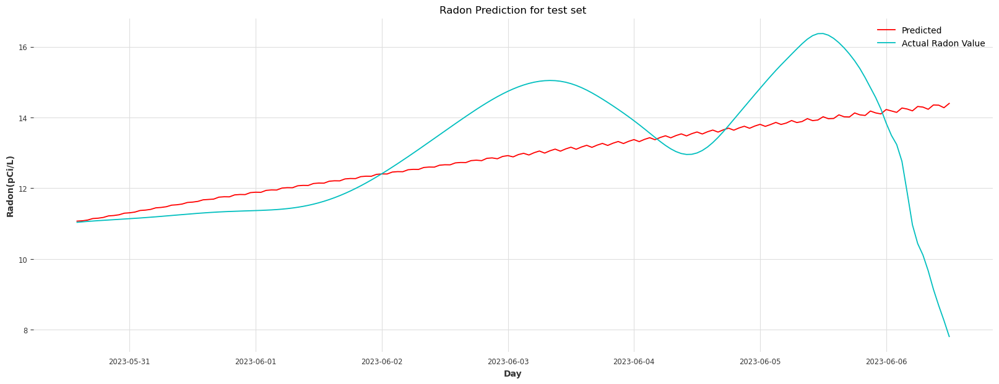

In [33]:
# plot the forecast
plt.figure(100, figsize=(20, 7))
plt.plot(dfY.index, dfY['Predicted'], color='r', label='Predicted')
plt.plot(dfY.index, dfY['Actual'], color='c', label='Actual Radon Value')
plt.legend()
plt.title('Radon Prediction for test set')
plt.xlabel('Day')
plt.ylabel('Radon(pCi/L)')
plt.show()

# Radon 13

In [60]:
df = df_radon['13'].copy()

In [61]:
# Denoising the Radon signal
def madev(d, axis=None):
    """ Mean absolute deviation of a signal """
    return np.mean(np.absolute(d - np.mean(d, axis)), axis)

In [62]:
def wavelet_denoising(x, wavelet='db4', level=5):
    coeff = pywt.wavedec(x, wavelet, mode="per")
    n = len(x) 
    sigma = (1/0.6745) * madev(coeff[-level])
    uthresh = sigma * np.sqrt(2 * np.log(len(x)))
    coeff[1:] = (pywt.threshold(i, value=uthresh, mode='hard') for i in coeff[1:])
    if len(x) % 2 ==0:
        return pywt.waverec(coeff, wavelet, mode='per')
    else:
        return pywt.waverec(coeff, wavelet, mode='per')[:n]

In [63]:
signal = df['Radon'].copy()
wavelet_name='coif17'
filtered = wavelet_denoising(signal, wavelet=wavelet_name, level=4)
df['Radon'] = filtered

In [64]:
# create time series object for target variable
ts_P = TimeSeries.from_series(df["Radon"], fill_missing_dates=True, freq="H") 

# check attributes of the time series
print("components:", ts_P.components)
print("duration:",ts_P.duration)
print("frequency:",ts_P.freq)
print("frequency:",ts_P.freq_str)
print("has date time index? (or else, it must have an integer index):",ts_P.has_datetime_index)
print("deterministic:",ts_P.is_deterministic)
print("univariate:",ts_P.is_univariate)

components: Index(['Radon'], dtype='object', name='component')
duration: 390 days 17:00:00
frequency: <Hour>
frequency: H
has date time index? (or else, it must have an integer index): True
deterministic: True
univariate: True


In [65]:
# train/test split and scaling of target variable
ts_train, ts_test = ts_P.split_after(split_point=9210)

print("training start:", ts_train.start_time())
print("training end:", ts_train.end_time())
print("training duration:",ts_train.duration)
print("test start:", ts_test.start_time())
print("test end:", ts_test.end_time())
print("test duration:", ts_test.duration)


scalerP = Scaler()
scalerP.fit_transform(ts_train)
ts_ttrain = scalerP.transform(ts_train)
ts_ttest = scalerP.transform(ts_test)    
ts_t = scalerP.transform(ts_P)

# make sure data are of type float
ts_t = ts_t.astype(np.float32)
ts_ttrain = ts_ttrain.astype(np.float32)
ts_ttest = ts_ttest.astype(np.float32)

print("first and last row of scaled Radon time series:")
pd.options.display.float_format = '{:,.2f}'.format
ts_t.pd_dataframe().iloc[[0,-1]]

training start: 2022-05-11 19:00:00
training end: 2023-05-30 13:00:00
training duration: 383 days 18:00:00
test start: 2023-05-30 14:00:00
test end: 2023-06-06 12:00:00
test duration: 6 days 22:00:00
first and last row of scaled Radon time series:


component,Radon
SyncDate,
2022-05-11 19:00:00,0.05
2023-06-06 12:00:00,0.05


In [66]:
print("first and last row of scaled target variable in training set: price:")
ts_ttrain.pd_dataframe().iloc[[0,-1]]

first and last row of scaled target variable in training set: price:


component,Radon
SyncDate,
2022-05-11 19:00:00,0.05
2023-05-30 13:00:00,0.03


In [67]:
def set_seed(seed_value):
    import random
    import numpy as np
    import torch

    random.seed(seed_value)
    np.random.seed(seed_value)
    torch.manual_seed(seed_value)
    torch.cuda.manual_seed(seed_value)
    torch.cuda.manual_seed_all(seed_value)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    pl.seed_everything(seed_value, workers=True)

In [68]:
import torch
from ray.air import session
from darts.utils.losses import SmapeLoss
from torchmetrics import MetricCollection, SymmetricMeanAbsolutePercentageError, MeanAbsolutePercentageError
def build_fit_tcn_model(
    model_args,
    save_checkpoints=False,
    callbacks=None,
    save_model=False
):
#     BATCH_SIZE=64
    MAX_EPOCHS=500
    NR_EPOCHS_VAL_PERIOD=1
    set_seed(42)
    torch_metrics = MetricCollection([MeanAbsolutePercentageError(), SymmetricMeanAbsolutePercentageError()])

#     early_stopper = EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.001,
#         mode='min',
#     )

#     if callbacks is None:
#         callbacks = [early_stopper]
#     else:
#         callbacks.append(early_stopper)
    
    #detect if GPU is available
#     if torch.cuda.is_available():
#         pl_trainer_kwargs = {
#             "accelerator": "gpu",
#             "gpus": -1,
#             "auto_select_gpus": True,
#             "callbacks": callbacks,
#             "enable_progress_bar":False,
#         }
#         num_workers=8
#     else:
#         pl_trainer_kwargs={
#             "callbacks": callbacks,
#         }
#         num_workers=0
    pl_trainer_kwargs={
            "accelerator": "gpu",
            "gpus":-1,
            "auto_select_gpus": True,
            "callbacks": callbacks,
            "enable_progress_bar": False,
        }
   

    model = TCNModel(
        input_chunk_length=model_args['in_len'],
        output_chunk_length=model_args['out_len'],
        batch_size=model_args['batch_size'],
        n_epochs=MAX_EPOCHS,
        nr_epochs_val_period=NR_EPOCHS_VAL_PERIOD,
        model_name="tcn",
        kernel_size = model_args['kernel_size'],
        num_filters = model_args['num_filters'],
        weight_norm = model_args['weight_norm'],
        dilation_base = model_args['dilation_base'],
        num_layers = model_args['num_layers'],
        dropout=model_args['dropout'],
        loss_fn=SmapeLoss(),
        optimizer_kwargs={'lr': model_args['lr']},
        log_tensorboard=False,
        force_reset=True,
        save_checkpoints=save_checkpoints,
        pl_trainer_kwargs=pl_trainer_kwargs,
        torch_metrics=torch_metrics,
        random_state=42
        )
    val_len = len(ts_test)
    val_series = ts_ttrain[-((val_len) + model_args['in_len']) :]
    ts_ttrain_input = ts_ttrain[:-(val_len )]
    model.fit(  ts_ttrain_input, 
                val_series=val_series,
            )
#     model.load_from_checkpoint(f"{model_args['model']} RNN model", best=True)
    ts_tpred = model.predict(
                series = ts_ttrain,
                n = len(ts_ttest),
                verbose=True
    )
    ts_q = scalerP.inverse_transform(ts_tpred)
    q_smape = smape(ts_q, ts_test)
    session.report({'q_smape': q_smape})

In [69]:
def build_fit_tcn_model_return(
    model_args,
    save_checkpoints=False,
    callbacks=None,
    save_model=False
):
#     BATCH_SIZE=64
    MAX_EPOCHS=500
    NR_EPOCHS_VAL_PERIOD=1
    set_seed(42)
    torch_metrics = MetricCollection([MeanAbsolutePercentageError(), SymmetricMeanAbsolutePercentageError()])

#     early_stopper = EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.001,
#         mode='min',
#     )

#     if callbacks is None:
#         callbacks = [early_stopper]
#     else:
#         callbacks.append(early_stopper)
    
    #detect if GPU is available
#     if torch.cuda.is_available():
#         pl_trainer_kwargs = {
#             "accelerator": "gpu",
#             "gpus": -1,
#             "auto_select_gpus": True,
#             "callbacks": callbacks,
#             "enable_progress_bar":False,
#         }
#         num_workers=8
#     else:
#         pl_trainer_kwargs={
#             "callbacks": callbacks,
#         }
#         num_workers=0
    pl_trainer_kwargs={
            "accelerator": "gpu",
            "devices":1,
            "auto_select_gpus": True,
            "callbacks": callbacks,
            "enable_progress_bar": True,
        }
    

    model = TCNModel(
        input_chunk_length=model_args['in_len'],
        output_chunk_length=model_args['out_len'],
        batch_size=model_args['batch_size'],
        n_epochs=MAX_EPOCHS,
        nr_epochs_val_period=NR_EPOCHS_VAL_PERIOD,
        model_name="tcn",
        kernel_size = model_args['kernel_size'],
        num_filters = model_args['num_filters'],
        weight_norm = model_args['weight_norm'],
        dilation_base = model_args['dilation_base'],
        num_layers = model_args['num_layers'],
        dropout=model_args['dropout'],
        loss_fn=SmapeLoss(),
        optimizer_kwargs={'lr': model_args['lr']},
        log_tensorboard=False,
        force_reset=True,
        save_checkpoints=save_checkpoints,
        pl_trainer_kwargs=pl_trainer_kwargs,
        torch_metrics=torch_metrics,
        random_state=42,
        )
    val_len = len(ts_test)
    val_series = ts_ttrain[-((val_len) + model_args['in_len']) :]
    ts_ttrain_input = ts_ttrain[:-(val_len )]
    model.fit(  ts_ttrain_input, 
               
                val_series=val_series,
            num_loader_workers=20)
#     model.load_from_checkpoint(f"{model_args['model']} RNN model", best=True)
#     ts_tpred = model.predict(
#                 series = ts_ttrain,
#                 past_covariates=covF_t,
#                 n = len(ts_ttest),
#                 verbose=True
#     )
#     ts_q = scalerP.inverse_transform(ts_tpred)
#     q_smape = smape(ts_q, ts_test)
#     session.report({'q_smape': q_smape})
    return model

In [70]:
from ray import tune
from ray.tune import CLIReporter
# from ray.tune.integration.pytorch_lightning import TuneReportCallback
from ray.tune.schedulers import ASHAScheduler, AsyncHyperBandScheduler
from ray.tune.search.optuna import OptunaSearch
from ray.tune.search import ConcurrencyLimiter
# tune_callback = TuneReportCallback(
#     {
#         "loss":"val_loss",
#         "sMAPE": "val_SymmetricMeanAbsolutePercentageError",
#     },
#     on="validation_end",
# )

early_stopper = EarlyStopping(
        monitor="val_SymmetricMeanAbsolutePercentageError",
        patience=3,
        mode='min',
    )

#define the hyperparameter search space
config = {
    "in_len": tune.randint(8,40),#setting 168 is not a good option here as convolutions take time reducing this to 80
    "out_len":tune.randint(1,12),
    "num_layers": tune.choice([1, 2, 3, 4]),  # Number of convolutional layers
    "num_filters": tune.choice([8, 16, 32, 64]),  # Number of filters in a convolutional layer
    "kernel_size": tune.choice([2, 3, 4]),  # Size of the kernel in a convolutional layer
    "dilation_base": tune.choice([2, 3, 4]),  # Base of the exponent for dilation on every level
    "weight_norm": tune.choice([True, False]),  # Whether to use weight normalization
    "dropout": tune.uniform(0.0, 0.5),  # Dropout rate for every convolutional layer
    "lr": tune.loguniform(1e-5, 1e-1),
    "batch_size":tune.choice([16,32,64,128,256]),
    
}

reporter = CLIReporter(
    parameter_columns=list(config.keys()),
    metric_columns=["q_smape"])
resources_per_trial = {"cpu": 5, "gpu": 0.4}

num_samples = 50

algo = OptunaSearch()

algo = ConcurrencyLimiter(algo, max_concurrent=10)

scheduler = AsyncHyperBandScheduler(max_t=100, grace_period=10, reduction_factor=2)

train_fn_with_parameters = tune.with_parameters(build_fit_tcn_model, callbacks=[early_stopper])

analysis = tune.run(
    train_fn_with_parameters,
    resources_per_trial=resources_per_trial,
    metric="q_smape",
    mode="min",
    config=config,
    num_samples=num_samples,
    search_alg=algo,
    scheduler = scheduler,
    progress_reporter=reporter,
    name="tcn_tune_cov",
    raise_on_failed_trial=False
)

print("Best hyperparameters found were: ", analysis.best_config)

== Status ==
Current time: 2023-07-11 05:55:59 (running for 00:00:00.15)
Memory usage on this node: 34.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 1/50 (1 RUNNING)
+------------------------------+----------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-----------+--------------+
| Trial name                   | status   | loc                  |   in_len |   out_len |   num_layers |   num_filters |   kernel_size |   dilation_base | weight_norm   |   dropout |        lr |   batch_size |
|------------------------------+----------+----------------------+----------+-----------+--------------+---------------+------------

(build_fit_tcn_model pid=2536151) Global seed set to 42
(build_fit_tcn_model pid=2536151) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2536151)   rank_zero_deprecation(
(build_fit_tcn_model pid=2536151) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2536151)   rank_zero_deprecation(
(build_fit_tcn_model pid=2536151) Auto select gpus: [0]
(build_fit_tcn_model pid=2536151) GPU available: True (cuda), used: True
(bui

== Status ==
Current time: 2023-07-11 05:56:08 (running for 00:00:09.70)
Memory usage on this node: 40.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 9/50 (1 PENDING, 8 RUNNING)
+------------------------------+----------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+
| Trial name                   | status   | loc                  |   in_len |   out_len |   num_layers |   num_filters |   kernel_size |   dilation_base | weight_norm   |   dropout |          lr |   batch_size |
|------------------------------+----------+----------------------+----------+-----------+------------

(build_fit_tcn_model pid=2536380) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2536380)   rank_zero_deprecation(
(build_fit_tcn_model pid=2536380) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2536380)   rank_zero_deprecation(
(build_fit_tcn_model pid=2536382) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting 

(build_fit_tcn_model pid=2536382) Auto select gpus: [0]
(build_fit_tcn_model pid=2536382) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2536382) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2536382) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2536382) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2536382) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2536382) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]
(build_fit_tcn_model pid=2536382) 
(build_fit_tcn_model pid=2536382)   | Name          | Type              | Params
(build_fit_tcn_model pid=2536382) --------------------------------------------

(build_fit_tcn_model pid=2536378) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('val_MeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2536378)   rank_zero_warn(
(build_fit_tcn_model pid=2536378) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('val_SymmetricMeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2536378)   rank_zero_warn(
(build_fit_tcn_model pid=2536378) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('train_MeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logg

(build_fit_tcn_model pid=2536380) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('train_MeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2536380)   rank_zero_warn(
(build_fit_tcn_model pid=2536380) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('train_SymmetricMeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2536380)   rank_zero_warn(


== Status ==
Current time: 2023-07-11 05:56:13 (running for 00:00:14.71)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 9/50 (1 PENDING, 8 RUNNING)
+------------------------------+----------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+
| Trial name                   | status   | loc                  |   in_len |   out_len |   num_layers |   num_filters |   kernel_size |   dilation_base | weight_norm   |   dropout |          lr |   batch_size |
|------------------------------+----------+----------------------+----------+-----------+------------

Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 29.09it/s]


(build_fit_tcn_model pid=2536378) Auto select gpus: [0]
(build_fit_tcn_model pid=2536378) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2536378) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2536378) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2536378) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2536378) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2536378) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Trial name,date,done,episodes_total,experiment_id,experiment_tag,hostname,iterations_since_restore,node_ip,pid,q_smape,time_since_restore,time_this_iter_s,time_total_s,timestamp,timesteps_since_restore,timesteps_total,training_iteration,trial_id,warmup_time
build_fit_tcn_model_08e9abbc,2023-07-11_06-26-54,True,,cbb3084bd2be44708d5143453703067d,"37_batch_size=32,dilation_base=4,dropout=0.2663,in_len=12,kernel_size=2,lr=0.0043,num_filters=32,num_layers=1,out_len=7,weight_norm=True",ip-172-31-10-87,1,172.31.10.87,2548410,24.487240649638135,27.454129457473755,27.454129457473755,27.454129457473755,1689056814,0,,1,08e9abbc,0.0028014183044433594
build_fit_tcn_model_0909e2ff,2023-07-11_06-05-33,True,,d8ffe62c7d69470483d2097524d042d3,"3_batch_size=64,dilation_base=2,dropout=0.4021,in_len=38,kernel_size=3,lr=0.0021,num_filters=16,num_layers=4,out_len=9,weight_norm=False",ip-172-31-10-87,1,172.31.10.87,2536380,25.775813612661736,564.8202865123749,564.8202865123749,564.8202865123749,1689055533,0,,1,0909e2ff,0.0031585693359375
build_fit_tcn_model_0ae8818a,2023-07-11_06-04-25,True,,9bb30dee63b0441b8f80745697fafcc4,"12_batch_size=256,dilation_base=2,dropout=0.0071,in_len=19,kernel_size=3,lr=0.0111,num_filters=16,num_layers=3,out_len=11,weight_norm=False",ip-172-31-10-87,1,172.31.10.87,2538971,111.00576101729385,383.8441758155823,383.8441758155823,383.8441758155823,1689055465,0,,1,0ae8818a,0.0027773380279541016
build_fit_tcn_model_0b130a07,2023-07-11_07-36-54,True,,c5914d626a8a43598ba1e161ce949202,"46_batch_size=256,dilation_base=2,dropout=0.3964,in_len=18,kernel_size=4,lr=0.0002,num_filters=16,num_layers=1,out_len=2,weight_norm=True",ip-172-31-10-87,1,172.31.10.87,2611913,27.38298009933253,38.648728132247925,38.648728132247925,38.648728132247925,1689061014,0,,1,0b130a07,0.0028705596923828125
build_fit_tcn_model_0c27edb1,2023-07-11_06-24-17,True,,0c06a01962b34f019979c82f81dfb3c4,"29_batch_size=32,dilation_base=3,dropout=0.2890,in_len=16,kernel_size=4,lr=0.0035,num_filters=8,num_layers=3,out_len=10,weight_norm=True",ip-172-31-10-87,1,172.31.10.87,2545393,50.23219360841693,370.26131200790405,370.26131200790405,370.26131200790405,1689056657,0,,1,0c27edb1,0.003082275390625
build_fit_tcn_model_0fea3eac,2023-07-11_07-40-42,True,,df2dd8d2f4524fbf94977af484fffdf3,"16_batch_size=64,dilation_base=2,dropout=0.1293,in_len=23,kernel_size=4,lr=0.0001,num_filters=16,num_layers=4,out_len=7,weight_norm=True",ip-172-31-10-87,1,172.31.10.87,2540602,26.50030151154822,5770.812107563019,5770.812107563019,5770.812107563019,1689061242,0,,1,0fea3eac,0.0027618408203125
build_fit_tcn_model_21d32d39,2023-07-11_06-06-22,True,,dee5313f65c447309cc2ef7451936407,"22_batch_size=256,dilation_base=4,dropout=0.4911,in_len=9,kernel_size=2,lr=0.0004,num_filters=8,num_layers=1,out_len=1,weight_norm=True",ip-172-31-10-87,1,172.31.10.87,2542178,200.0,7.225668430328369,7.225668430328369,7.225668430328369,1689055582,0,,1,21d32d39,0.002713918685913086
build_fit_tcn_model_2ddef745,2023-07-11_07-48-55,True,,59eda4c02d034f8f9b259b41c0dc5308,"49_batch_size=16,dilation_base=3,dropout=0.4399,in_len=22,kernel_size=3,lr=0.0000,num_filters=16,num_layers=2,out_len=4,weight_norm=True",ip-172-31-10-87,1,172.31.10.87,2612983,29.069237660658203,621.6328482627869,621.6328482627869,621.6328482627869,1689061735,0,,1,2ddef745,0.0028047561645507812
build_fit_tcn_model_2df3fbc9,2023-07-11_06-26-21,True,,cffcace6864047738637d371b5581992,"36_batch_size=64,dilation_base=4,dropout=0.0871,in_len=17,kernel_size=2,lr=0.0560,num_filters=8,num_layers=1,out_len=7,weight_norm=True",ip-172-31-10-87,1,172.31.10.87,2548120,176.50473562592,8.3307363986969,8.3307363986969,8.3307363986969,1689056781,0,,1,2df3fbc9,0.002838134765625
build_fit_tcn_model_2fedf1f0,2023-07-11_05-58-10,True,,0d2b34aa81cf433ab3d28b9a64205825,"6_batch_size=128,dilation_base=4,dropout=0.2516,in_len=20,kernel_size=3,lr=0.0000,num_filters=16,num_layers=1,out_len=3,weight_norm=True",ip-172-31-10-87,1,172.31.10.87,2536389,24.608308657472953,121.57587552

== Status ==
Current time: 2023-07-11 05:56:29 (running for 00:00:30.48)
Memory usage on this node: 54.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: a112ee9f with q_smape=23.906764071736227 and parameters={'in_len': 27, 'out_len': 2, 'num_layers': 1, 'num_filters': 8, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.2105548323698349, 'lr': 0.000808178233309195, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 9/50 (8 RUNNING, 1 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial name       

(build_fit_tcn_model pid=2538068) Global seed set to 42
(build_fit_tcn_model pid=2538068) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2538068)   rank_zero_deprecation(
(build_fit_tcn_model pid=2538068) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2538068)   rank_zero_deprecation(
(build_fit_tcn_model pid=2538068) Auto select gpus: [0]
(build_fit_tcn_model pid=2538068) GPU available: True (cuda), used: True
(bui

== Status ==
Current time: 2023-07-11 05:56:39 (running for 00:00:40.13)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: a112ee9f with q_smape=23.906764071736227 and parameters={'in_len': 27, 'out_len': 2, 'num_layers': 1, 'num_filters': 8, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.2105548323698349, 'lr': 0.000808178233309195, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 10/50 (1 PENDING, 8 RUNNING, 1 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

(build_fit_tcn_model pid=2536151) Auto select gpus: [0]
(build_fit_tcn_model pid=2536151) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2536151) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2536151) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2536151) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2536151) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2536151) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2538317) Global seed set to 42
(build_fit_tcn_model pid=2538317) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_conn

== Status ==
Current time: 2023-07-11 05:56:44 (running for 00:00:45.49)
Memory usage on this node: 55.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: a112ee9f with q_smape=23.906764071736227 and parameters={'in_len': 27, 'out_len': 2, 'num_layers': 1, 'num_filters': 8, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.2105548323698349, 'lr': 0.000808178233309195, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 11/50 (1 PENDING, 8 RUNNING, 2 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

(build_fit_tcn_model pid=2538317) Auto select gpus: [0]
(build_fit_tcn_model pid=2538317) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2538317) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2538317) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2538317) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2538317) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2538317) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2538317) 
(build_fit_tcn_model pid=2538317)   | Name          | Type              | Params
(build_fit_tcn_model pid=2538317) --------------------------------------------

== Status ==
Current time: 2023-07-11 05:56:49 (running for 00:00:50.50)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: a112ee9f with q_smape=23.906764071736227 and parameters={'in_len': 27, 'out_len': 2, 'num_layers': 1, 'num_filters': 8, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.2105548323698349, 'lr': 0.000808178233309195, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 11/50 (1 PENDING, 8 RUNNING, 2 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 05:56:59 (running for 00:01:00.51)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: a112ee9f with q_smape=23.906764071736227 and parameters={'in_len': 27, 'out_len': 2, 'num_layers': 1, 'num_filters': 8, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.2105548323698349, 'lr': 0.000808178233309195, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 11/50 (1 PENDING, 8 RUNNING, 2 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 05:57:09 (running for 00:01:10.52)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: a112ee9f with q_smape=23.906764071736227 and parameters={'in_len': 27, 'out_len': 2, 'num_layers': 1, 'num_filters': 8, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.2105548323698349, 'lr': 0.000808178233309195, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 11/50 (1 PENDING, 8 RUNNING, 2 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 05:57:19 (running for 00:01:20.53)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: a112ee9f with q_smape=23.906764071736227 and parameters={'in_len': 27, 'out_len': 2, 'num_layers': 1, 'num_filters': 8, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.2105548323698349, 'lr': 0.000808178233309195, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 11/50 (1 PENDING, 8 RUNNING, 2 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 05:57:29 (running for 00:01:30.54)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: a112ee9f with q_smape=23.906764071736227 and parameters={'in_len': 27, 'out_len': 2, 'num_layers': 1, 'num_filters': 8, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.2105548323698349, 'lr': 0.000808178233309195, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 11/50 (1 PENDING, 8 RUNNING, 2 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

== Status ==
Current time: 2023-07-11 05:57:39 (running for 00:01:40.55)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: a112ee9f with q_smape=23.906764071736227 and parameters={'in_len': 27, 'out_len': 2, 'num_layers': 1, 'num_filters': 8, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.2105548323698349, 'lr': 0.000808178233309195, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 11/50 (1 PENDING, 8 RUNNING, 2 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----------+-------------+--------------+-----------+
| Trial

(build_fit_tcn_model pid=2536385) Auto select gpus: [0]
(build_fit_tcn_model pid=2536385) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2536385) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2536385) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2536385) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2536385) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2536385) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [2]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 32.40it/s]


(build_fit_tcn_model pid=2538718) Global seed set to 42
(build_fit_tcn_model pid=2538718) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2538718)   rank_zero_deprecation(
(build_fit_tcn_model pid=2538718) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2538718)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 05:57:46 (running for 00:01:47.49)
Memory usage on this node: 55.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: a112ee9f with q_smape=23.906764071736227 and parameters={'in_len': 27, 'out_len': 2, 'num_layers': 1, 'num_filters': 8, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.2105548323698349, 'lr': 0.000808178233309195, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 12/50 (1 PENDING, 8 RUNNING, 3 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tria

(build_fit_tcn_model pid=2538718) Auto select gpus: [0]
(build_fit_tcn_model pid=2538718) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2538718) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2538718) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2538718) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2538718) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2538718) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [2]
(build_fit_tcn_model pid=2538718) 
(build_fit_tcn_model pid=2538718)   | Name          | Type              | Params
(build_fit_tcn_model pid=2538718) --------------------------------------------

== Status ==
Current time: 2023-07-11 05:57:51 (running for 00:01:52.50)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: a112ee9f with q_smape=23.906764071736227 and parameters={'in_len': 27, 'out_len': 2, 'num_layers': 1, 'num_filters': 8, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.2105548323698349, 'lr': 0.000808178233309195, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 12/50 (1 PENDING, 8 RUNNING, 3 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tria

Predicting DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]


(build_fit_tcn_model pid=2538718) Auto select gpus: [0]
(build_fit_tcn_model pid=2538718) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2538718) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2538718) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2538718) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2538718) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2538718) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [2]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 85.96it/s]


(build_fit_tcn_model pid=2538971) Global seed set to 42
(build_fit_tcn_model pid=2538971) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2538971)   rank_zero_deprecation(
(build_fit_tcn_model pid=2538971) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2538971)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 05:58:02 (running for 00:02:03.50)
Memory usage on this node: 55.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: a112ee9f with q_smape=23.906764071736227 and parameters={'in_len': 27, 'out_len': 2, 'num_layers': 1, 'num_filters': 8, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.2105548323698349, 'lr': 0.000808178233309195, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 13/50 (1 PENDING, 8 RUNNING, 4 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tria

(build_fit_tcn_model pid=2538971) Auto select gpus: [0]
(build_fit_tcn_model pid=2538971) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2538971) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2538971) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2538971) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2538971) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2538971) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [2]
(build_fit_tcn_model pid=2538971) 
(build_fit_tcn_model pid=2538971)   | Name          | Type              | Params
(build_fit_tcn_model pid=2538971) --------------------------------------------

== Status ==
Current time: 2023-07-11 05:58:07 (running for 00:02:08.50)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: a112ee9f with q_smape=23.906764071736227 and parameters={'in_len': 27, 'out_len': 2, 'num_layers': 1, 'num_filters': 8, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.2105548323698349, 'lr': 0.000808178233309195, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 13/50 (1 PENDING, 8 RUNNING, 4 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tria

(build_fit_tcn_model pid=2536389) Auto select gpus: [0]
(build_fit_tcn_model pid=2536389) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2536389) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2536389) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2536389) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2536389) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2536389) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [2]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 42.68it/s]


(build_fit_tcn_model pid=2539227) Global seed set to 42
(build_fit_tcn_model pid=2539227) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2539227)   rank_zero_deprecation(
(build_fit_tcn_model pid=2539227) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2539227)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 05:58:16 (running for 00:02:17.51)
Memory usage on this node: 55.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: a112ee9f with q_smape=23.906764071736227 and parameters={'in_len': 27, 'out_len': 2, 'num_layers': 1, 'num_filters': 8, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.2105548323698349, 'lr': 0.000808178233309195, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 14/50 (1 PENDING, 8 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tria

(build_fit_tcn_model pid=2539227) Auto select gpus: [0]
(build_fit_tcn_model pid=2539227) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2539227) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2539227) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2539227) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2539227) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2539227) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [2]
(build_fit_tcn_model pid=2539227) 
(build_fit_tcn_model pid=2539227)   | Name          | Type              | Params
(build_fit_tcn_model pid=2539227) --------------------------------------------

== Status ==
Current time: 2023-07-11 05:58:21 (running for 00:02:22.51)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: a112ee9f with q_smape=23.906764071736227 and parameters={'in_len': 27, 'out_len': 2, 'num_layers': 1, 'num_filters': 8, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.2105548323698349, 'lr': 0.000808178233309195, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 14/50 (1 PENDING, 8 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tria

== Status ==
Current time: 2023-07-11 05:58:31 (running for 00:02:32.52)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: a112ee9f with q_smape=23.906764071736227 and parameters={'in_len': 27, 'out_len': 2, 'num_layers': 1, 'num_filters': 8, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.2105548323698349, 'lr': 0.000808178233309195, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 14/50 (1 PENDING, 8 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tria

(build_fit_tcn_model pid=2539227) Auto select gpus: [0]
(build_fit_tcn_model pid=2539227) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2539227) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2539227) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2539227) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2539227) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2539227) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [2]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 120.36it/s]


(build_fit_tcn_model pid=2539537) Global seed set to 42
(build_fit_tcn_model pid=2539537) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2539537)   rank_zero_deprecation(
(build_fit_tcn_model pid=2539537) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2539537)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 05:58:42 (running for 00:02:43.50)
Memory usage on this node: 55.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 15/50 (1 PENDING, 8 RUNNING, 6 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

(build_fit_tcn_model pid=2539537) Auto select gpus: [0]
(build_fit_tcn_model pid=2539537) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2539537) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2539537) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2539537) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2539537) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2539537) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [2]
(build_fit_tcn_model pid=2539537) 
(build_fit_tcn_model pid=2539537)   | Name          | Type              | Params
(build_fit_tcn_model pid=2539537) --------------------------------------------

== Status ==
Current time: 2023-07-11 05:58:47 (running for 00:02:48.51)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 15/50 (1 PENDING, 8 RUNNING, 6 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

== Status ==
Current time: 2023-07-11 05:58:57 (running for 00:02:58.52)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 15/50 (1 PENDING, 8 RUNNING, 6 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

== Status ==
Current time: 2023-07-11 05:59:07 (running for 00:03:08.53)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 15/50 (1 PENDING, 8 RUNNING, 6 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

== Status ==
Current time: 2023-07-11 05:59:17 (running for 00:03:18.55)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 15/50 (1 PENDING, 8 RUNNING, 6 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

== Status ==
Current time: 2023-07-11 05:59:27 (running for 00:03:28.56)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 15/50 (1 PENDING, 8 RUNNING, 6 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

== Status ==
Current time: 2023-07-11 05:59:37 (running for 00:03:38.57)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 15/50 (1 PENDING, 8 RUNNING, 6 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

== Status ==
Current time: 2023-07-11 05:59:47 (running for 00:03:48.58)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 15/50 (1 PENDING, 8 RUNNING, 6 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

== Status ==
Current time: 2023-07-11 05:59:57 (running for 00:03:58.59)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 15/50 (1 PENDING, 8 RUNNING, 6 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

== Status ==
Current time: 2023-07-11 06:00:07 (running for 00:04:08.60)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 15/50 (1 PENDING, 8 RUNNING, 6 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

== Status ==
Current time: 2023-07-11 06:00:17 (running for 00:04:18.62)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 15/50 (1 PENDING, 8 RUNNING, 6 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

== Status ==
Current time: 2023-07-11 06:00:27 (running for 00:04:28.63)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 15/50 (1 PENDING, 8 RUNNING, 6 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

== Status ==
Current time: 2023-07-11 06:00:37 (running for 00:04:38.64)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 15/50 (1 PENDING, 8 RUNNING, 6 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

== Status ==
Current time: 2023-07-11 06:00:47 (running for 00:04:48.65)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 15/50 (1 PENDING, 8 RUNNING, 6 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

== Status ==
Current time: 2023-07-11 06:00:57 (running for 00:04:58.66)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 15/50 (1 PENDING, 8 RUNNING, 6 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

== Status ==
Current time: 2023-07-11 06:01:07 (running for 00:05:08.68)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 15/50 (1 PENDING, 8 RUNNING, 6 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00,  7.26it/s]


(build_fit_tcn_model pid=2539537) Auto select gpus: [0]
(build_fit_tcn_model pid=2539537) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2539537) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2539537) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2539537) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2539537) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2539537) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [2]
(build_fit_tcn_model pid=2540005) Global seed set to 42
(build_fit_tcn_model pid=2540005) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_conn

== Status ==
Current time: 2023-07-11 06:01:20 (running for 00:05:21.52)
Memory usage on this node: 55.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

(build_fit_tcn_model pid=2540005) Auto select gpus: [0]
(build_fit_tcn_model pid=2540005) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2540005) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2540005) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2540005) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2540005) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2540005) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [2]
(build_fit_tcn_model pid=2540005) 
(build_fit_tcn_model pid=2540005)   | Name          | Type              | Params
(build_fit_tcn_model pid=2540005) --------------------------------------------

== Status ==
Current time: 2023-07-11 06:01:25 (running for 00:05:26.53)
Memory usage on this node: 57.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

(build_fit_tcn_model pid=2540005) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('val_MeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2540005)   rank_zero_warn(
(build_fit_tcn_model pid=2540005) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('val_SymmetricMeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2540005)   rank_zero_warn(


== Status ==
Current time: 2023-07-11 06:01:30 (running for 00:05:31.53)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

(build_fit_tcn_model pid=2540005) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('train_MeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2540005)   rank_zero_warn(
(build_fit_tcn_model pid=2540005) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('train_SymmetricMeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2540005)   rank_zero_warn(


== Status ==
Current time: 2023-07-11 06:01:35 (running for 00:05:36.54)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

== Status ==
Current time: 2023-07-11 06:01:45 (running for 00:05:46.55)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

== Status ==
Current time: 2023-07-11 06:01:55 (running for 00:05:56.56)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

== Status ==
Current time: 2023-07-11 06:02:05 (running for 00:06:06.57)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

== Status ==
Current time: 2023-07-11 06:02:15 (running for 00:06:16.58)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

== Status ==
Current time: 2023-07-11 06:02:25 (running for 00:06:26.60)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

== Status ==
Current time: 2023-07-11 06:02:35 (running for 00:06:36.61)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

== Status ==
Current time: 2023-07-11 06:02:45 (running for 00:06:46.62)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

== Status ==
Current time: 2023-07-11 06:02:55 (running for 00:06:56.63)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

== Status ==
Current time: 2023-07-11 06:03:05 (running for 00:07:06.65)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

== Status ==
Current time: 2023-07-11 06:03:15 (running for 00:07:16.66)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

== Status ==
Current time: 2023-07-11 06:03:25 (running for 00:07:26.67)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

== Status ==
Current time: 2023-07-11 06:03:35 (running for 00:07:36.68)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

== Status ==
Current time: 2023-07-11 06:03:45 (running for 00:07:46.69)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

== Status ==
Current time: 2023-07-11 06:03:55 (running for 00:07:56.70)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

== Status ==
Current time: 2023-07-11 06:04:05 (running for 00:08:06.72)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

== Status ==
Current time: 2023-07-11 06:04:15 (running for 00:08:16.73)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

== Status ==
Current time: 2023-07-11 06:04:25 (running for 00:08:26.74)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 16/50 (1 PENDING, 8 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

(build_fit_tcn_model pid=2538971) Auto select gpus: [0]
(build_fit_tcn_model pid=2538971) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2538971) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2538971) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2538971) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2538971) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2538971) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [2]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00,  7.25it/s]


(build_fit_tcn_model pid=2540602) Global seed set to 42
(build_fit_tcn_model pid=2540602) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2540602)   rank_zero_deprecation(
(build_fit_tcn_model pid=2540602) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2540602)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 06:04:32 (running for 00:08:33.54)
Memory usage on this node: 55.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 17/50 (1 PENDING, 8 RUNNING, 8 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

(build_fit_tcn_model pid=2540602) Auto select gpus: [0]
(build_fit_tcn_model pid=2540602) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2540602) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2540602) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2540602) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2540602) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2540602) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [2]
(build_fit_tcn_model pid=2540602) 
(build_fit_tcn_model pid=2540602)   | Name          | Type              | Params
(build_fit_tcn_model pid=2540602) --------------------------------------------

== Status ==
Current time: 2023-07-11 06:04:37 (running for 00:08:38.55)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 17/50 (1 PENDING, 8 RUNNING, 8 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

Predicting DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]


(build_fit_tcn_model pid=2538317) Auto select gpus: [0]
(build_fit_tcn_model pid=2538317) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2538317) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2538317) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2538317) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2538317) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2538317) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00,  4.14it/s]


(build_fit_tcn_model pid=2540858) Global seed set to 42
(build_fit_tcn_model pid=2540858) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2540858)   rank_zero_deprecation(
(build_fit_tcn_model pid=2540858) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2540858)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 06:04:50 (running for 00:08:51.54)
Memory usage on this node: 55.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 18/50 (1 PENDING, 8 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

(build_fit_tcn_model pid=2540858) Auto select gpus: [0]
(build_fit_tcn_model pid=2540858) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2540858) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2540858) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2540858) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2540858) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2540858) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2540858) 
(build_fit_tcn_model pid=2540858)   | Name          | Type              | Params
(build_fit_tcn_model pid=2540858) --------------------------------------------

== Status ==
Current time: 2023-07-11 06:04:55 (running for 00:08:56.55)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 18/50 (1 PENDING, 8 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| T

(build_fit_tcn_model pid=2540858) Auto select gpus: [0]
(build_fit_tcn_model pid=2540858) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2540858) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2540858) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2540858) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2540858) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2540858) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2541113) Global seed set to 42
(build_fit_tcn_model pid=2541113) ValueError: The output length must be strictly smaller than the input length


== Status ==
Current time: 2023-07-11 06:05:02 (running for 00:09:03.32)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 35.0/48 CPUs, 2.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 19/50 (1 ERROR, 1 PENDING, 7 RUNNING, 10 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial 

(build_fit_tcn_model pid=2541344) Global seed set to 42
(build_fit_tcn_model pid=2541344) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2541344)   rank_zero_deprecation(
(build_fit_tcn_model pid=2541344) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2541344)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 06:05:07 (running for 00:09:08.56)
Memory usage on this node: 55.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 20/50 (1 ERROR, 1 PENDING, 8 RUNNING, 10 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2541344) Auto select gpus: [0]
(build_fit_tcn_model pid=2541344) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2541344) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2541344) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2541344) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2541344) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2541344) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2541344) 
(build_fit_tcn_model pid=2541344)   | Name          | Type              | Params
(build_fit_tcn_model pid=2541344) --------------------------------------------

== Status ==
Current time: 2023-07-11 06:05:12 (running for 00:09:13.56)
Memory usage on this node: 57.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 20/50 (1 ERROR, 1 PENDING, 8 RUNNING, 10 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2541344) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('train_MeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2541344)   rank_zero_warn(
(build_fit_tcn_model pid=2541344) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('train_SymmetricMeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2541344)   rank_zero_warn(


== Status ==
Current time: 2023-07-11 06:05:17 (running for 00:09:18.57)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 20/50 (1 ERROR, 1 PENDING, 8 RUNNING, 10 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:05:27 (running for 00:09:28.59)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 20/50 (1 ERROR, 1 PENDING, 8 RUNNING, 10 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2536380) Auto select gpus: [0]
(build_fit_tcn_model pid=2536380) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2536380) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2536380) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2536380) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2536380) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2536380) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]


Predicting DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]


(build_fit_tcn_model pid=2536440) Auto select gpus: [0]
(build_fit_tcn_model pid=2536440) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2536440) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2536440) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2536440) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2536440) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2536440) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [3]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 14.96it/s]


(build_fit_tcn_model pid=2541619) Global seed set to 42
(build_fit_tcn_model pid=2541619) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2541619)   rank_zero_deprecation(
(build_fit_tcn_model pid=2541619) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2541619)   rank_zero_deprecation(
(build_fit_tcn_model pid=2541619) Auto select gpus: [0]
(build_fit_tcn_model pid=2541619) GPU available: True (cuda), used: True
(bui

== Status ==
Current time: 2023-07-11 06:05:41 (running for 00:09:42.57)
Memory usage on this node: 55.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 22/50 (1 ERROR, 1 PENDING, 8 RUNNING, 12 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2541781) Auto select gpus: [0]
(build_fit_tcn_model pid=2541781) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2541781) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2541781) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2541781) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2541781) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2541781) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [3]
(build_fit_tcn_model pid=2541781) 
(build_fit_tcn_model pid=2541781)   | Name          | Type              | Params
(build_fit_tcn_model pid=2541781) --------------------------------------------

== Status ==
Current time: 2023-07-11 06:05:46 (running for 00:09:47.60)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 22/50 (1 ERROR, 1 PENDING, 8 RUNNING, 12 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:05:56 (running for 00:09:57.62)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 22/50 (1 ERROR, 1 PENDING, 8 RUNNING, 12 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:06:06 (running for 00:10:07.63)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 22/50 (1 ERROR, 1 PENDING, 8 RUNNING, 12 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2541781) Auto select gpus: [0]
(build_fit_tcn_model pid=2541781) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2541781) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2541781) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2541781) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2541781) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2541781) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [3]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 15.62it/s]


(build_fit_tcn_model pid=2542178) Global seed set to 42
(build_fit_tcn_model pid=2542178) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2542178)   rank_zero_deprecation(
(build_fit_tcn_model pid=2542178) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2542178)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 06:06:15 (running for 00:10:16.56)
Memory usage on this node: 55.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 23/50 (1 ERROR, 1 PENDING, 8 RUNNING, 13 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2542178) Auto select gpus: [0]
(build_fit_tcn_model pid=2542178) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2542178) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2542178) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2542178) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2542178) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2542178) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [3]
(build_fit_tcn_model pid=2542178) 
(build_fit_tcn_model pid=2542178)   | Name          | Type              | Params
(build_fit_tcn_model pid=2542178) --------------------------------------------

== Status ==
Current time: 2023-07-11 06:06:20 (running for 00:10:21.57)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 23/50 (1 ERROR, 1 PENDING, 8 RUNNING, 13 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2542178) Auto select gpus: [0]
(build_fit_tcn_model pid=2542178) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2542178) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2542178) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2542178) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2542178) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2542178) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [3]
(build_fit_tcn_model pid=2542472) Global seed set to 42
(build_fit_tcn_model pid=2542472) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_conn

== Status ==
Current time: 2023-07-11 06:06:27 (running for 00:10:28.57)
Memory usage on this node: 55.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 24/50 (1 ERROR, 1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2542472) Auto select gpus: [0]
(build_fit_tcn_model pid=2542472) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2542472) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2542472) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2542472) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2542472) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2542472) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [3]
(build_fit_tcn_model pid=2542472) 
(build_fit_tcn_model pid=2542472)   | Name          | Type              | Params
(build_fit_tcn_model pid=2542472) --------------------------------------------

== Status ==
Current time: 2023-07-11 06:06:32 (running for 00:10:33.57)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 24/50 (1 ERROR, 1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:06:42 (running for 00:10:43.59)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 24/50 (1 ERROR, 1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:06:52 (running for 00:10:53.60)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 24/50 (1 ERROR, 1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:07:02 (running for 00:11:03.62)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 24/50 (1 ERROR, 1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:07:12 (running for 00:11:13.63)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 24/50 (1 ERROR, 1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:07:22 (running for 00:11:23.64)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 24/50 (1 ERROR, 1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:07:32 (running for 00:11:33.66)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 24/50 (1 ERROR, 1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:07:42 (running for 00:11:43.68)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 24/50 (1 ERROR, 1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:07:52 (running for 00:11:53.69)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 24/50 (1 ERROR, 1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:08:02 (running for 00:12:03.70)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 24/50 (1 ERROR, 1 PENDING, 8 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2536391) Auto select gpus: [0]
(build_fit_tcn_model pid=2536391) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2536391) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2536391) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2536391) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2536391) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2536391) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [3]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00,  2.84it/s]


(build_fit_tcn_model pid=2542914) Global seed set to 42
(build_fit_tcn_model pid=2542914) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2542914)   rank_zero_deprecation(
(build_fit_tcn_model pid=2542914) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2542914)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 06:08:11 (running for 00:12:12.58)
Memory usage on this node: 55.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 25/50 (1 ERROR, 1 PENDING, 8 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2542914) Auto select gpus: [0]
(build_fit_tcn_model pid=2542914) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2542914) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2542914) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2542914) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2542914) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2542914) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [3]
(build_fit_tcn_model pid=2542914) 
(build_fit_tcn_model pid=2542914)   | Name          | Type              | Params
(build_fit_tcn_model pid=2542914) --------------------------------------------

== Status ==
Current time: 2023-07-11 06:08:16 (running for 00:12:17.58)
Memory usage on this node: 57.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 25/50 (1 ERROR, 1 PENDING, 8 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2542914) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('val_MeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2542914)   rank_zero_warn(
(build_fit_tcn_model pid=2542914) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('val_SymmetricMeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2542914)   rank_zero_warn(


== Status ==
Current time: 2023-07-11 06:08:21 (running for 00:12:22.59)
Memory usage on this node: 57.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 25/50 (1 ERROR, 1 PENDING, 8 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:08:31 (running for 00:12:32.60)
Memory usage on this node: 57.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 25/50 (1 ERROR, 1 PENDING, 8 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2542914) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('train_MeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2542914)   rank_zero_warn(
(build_fit_tcn_model pid=2542914) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('train_SymmetricMeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2542914)   rank_zero_warn(


== Status ==
Current time: 2023-07-11 06:08:36 (running for 00:12:37.61)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 25/50 (1 ERROR, 1 PENDING, 8 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:08:46 (running for 00:12:47.62)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 25/50 (1 ERROR, 1 PENDING, 8 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:08:56 (running for 00:12:57.64)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 25/50 (1 ERROR, 1 PENDING, 8 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:09:06 (running for 00:13:07.65)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 25/50 (1 ERROR, 1 PENDING, 8 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:09:16 (running for 00:13:17.67)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 25/50 (1 ERROR, 1 PENDING, 8 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:09:26 (running for 00:13:27.68)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 25/50 (1 ERROR, 1 PENDING, 8 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:09:36 (running for 00:13:37.70)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 25/50 (1 ERROR, 1 PENDING, 8 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:09:46 (running for 00:13:47.71)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 25/50 (1 ERROR, 1 PENDING, 8 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:09:56 (running for 00:13:57.73)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 25/50 (1 ERROR, 1 PENDING, 8 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:10:06 (running for 00:14:07.74)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 25/50 (1 ERROR, 1 PENDING, 8 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:10:16 (running for 00:14:17.76)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 25/50 (1 ERROR, 1 PENDING, 8 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:10:26 (running for 00:14:27.77)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 25/50 (1 ERROR, 1 PENDING, 8 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:10:36 (running for 00:14:37.79)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 25/50 (1 ERROR, 1 PENDING, 8 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:10:46 (running for 00:14:47.81)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 25/50 (1 ERROR, 1 PENDING, 8 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:10:56 (running for 00:14:57.82)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 25/50 (1 ERROR, 1 PENDING, 8 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:11:06 (running for 00:15:07.84)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 25/50 (1 ERROR, 1 PENDING, 8 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:11:16 (running for 00:15:17.85)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 25/50 (1 ERROR, 1 PENDING, 8 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:11:26 (running for 00:15:27.87)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 25/50 (1 ERROR, 1 PENDING, 8 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:11:36 (running for 00:15:37.88)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 25/50 (1 ERROR, 1 PENDING, 8 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:11:46 (running for 00:15:47.90)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 25/50 (1 ERROR, 1 PENDING, 8 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2536382) Auto select gpus: [0]
(build_fit_tcn_model pid=2536382) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2536382) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2536382) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2536382) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2536382) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2536382) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00,  1.40it/s]


(build_fit_tcn_model pid=2543601) Global seed set to 42
(build_fit_tcn_model pid=2543601) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2543601)   rank_zero_deprecation(
(build_fit_tcn_model pid=2543601) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2543601)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 06:11:55 (running for 00:15:56.60)
Memory usage on this node: 55.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 ERROR, 1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2543601) Auto select gpus: [0]
(build_fit_tcn_model pid=2543601) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2543601) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2543601) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2543601) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2543601) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2543601) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]
(build_fit_tcn_model pid=2543601) 
(build_fit_tcn_model pid=2543601)   | Name          | Type              | Params
(build_fit_tcn_model pid=2543601) --------------------------------------------

== Status ==
Current time: 2023-07-11 06:12:00 (running for 00:16:01.61)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 ERROR, 1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2543601) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('val_MeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2543601)   rank_zero_warn(
(build_fit_tcn_model pid=2543601) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('val_SymmetricMeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2543601)   rank_zero_warn(


== Status ==
Current time: 2023-07-11 06:12:05 (running for 00:16:06.62)
Memory usage on this node: 57.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 ERROR, 1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2543601) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('train_MeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2543601)   rank_zero_warn(
(build_fit_tcn_model pid=2543601) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('train_SymmetricMeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2543601)   rank_zero_warn(


== Status ==
Current time: 2023-07-11 06:12:10 (running for 00:16:11.62)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 ERROR, 1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:12:20 (running for 00:16:21.64)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 ERROR, 1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:12:30 (running for 00:16:31.65)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 ERROR, 1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:12:40 (running for 00:16:41.67)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 ERROR, 1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:12:50 (running for 00:16:51.69)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 ERROR, 1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:13:00 (running for 00:17:01.70)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 ERROR, 1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:13:10 (running for 00:17:11.72)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 ERROR, 1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:13:20 (running for 00:17:21.73)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 ERROR, 1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:13:30 (running for 00:17:31.74)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 ERROR, 1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:13:40 (running for 00:17:41.76)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 ERROR, 1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:13:50 (running for 00:17:51.77)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 ERROR, 1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:14:00 (running for 00:18:01.79)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 ERROR, 1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:14:10 (running for 00:18:11.80)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 ERROR, 1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:14:20 (running for 00:18:21.82)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 ERROR, 1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:14:30 (running for 00:18:31.83)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 ERROR, 1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:14:40 (running for 00:18:41.84)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 ERROR, 1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:14:50 (running for 00:18:51.86)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 ERROR, 1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:15:00 (running for 00:19:01.87)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 ERROR, 1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:15:10 (running for 00:19:11.89)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 ERROR, 1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:15:20 (running for 00:19:21.90)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 ERROR, 1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:15:30 (running for 00:19:31.92)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 ERROR, 1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:15:40 (running for 00:19:41.93)
Memory usage on this node: 57.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 ERROR, 1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:15:50 (running for 00:19:51.95)
Memory usage on this node: 57.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 ERROR, 1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:16:00 (running for 00:20:01.96)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 ERROR, 1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:16:10 (running for 00:20:11.98)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 ERROR, 1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:16:20 (running for 00:20:21.99)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 ERROR, 1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:16:30 (running for 00:20:32.01)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 ERROR, 1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:16:40 (running for 00:20:42.02)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 ERROR, 1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:16:50 (running for 00:20:52.04)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 ERROR, 1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:17:00 (running for 00:21:02.05)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 ERROR, 1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:17:11 (running for 00:21:12.07)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 ERROR, 1 PENDING, 8 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2538068) Auto select gpus: [0]
(build_fit_tcn_model pid=2538068) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2538068) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2538068) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2538068) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2538068) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2538068) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:04<00:00,  4.40s/it]
== Status ==
Current time: 2023-07-11 06:17:16 (running for 00:21:17.61)
Memory usage on this node: 55.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 26/50 (1 ERROR, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+----

(build_fit_tcn_model pid=2544633) Global seed set to 42
(build_fit_tcn_model pid=2544633) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2544633)   rank_zero_deprecation(
(build_fit_tcn_model pid=2544633) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2544633)   rank_zero_deprecation(
(build_fit_tcn_model pid=2544633) Auto select gpus: [0]
(build_fit_tcn_model pid=2544633) GPU available: True (cuda), used: True
(bui

== Status ==
Current time: 2023-07-11 06:17:26 (running for 00:21:27.29)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 27/50 (1 ERROR, 1 PENDING, 8 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 51.28it/s]

(build_fit_tcn_model pid=2544633) Auto select gpus: [0]
(build_fit_tcn_model pid=2544633) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2544633) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2544633) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2544633) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2544633) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2544633) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


(build_fit_tcn_model pid=2544886) Global seed set to 42
(build_fit_tcn_model pid=2544886) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2544886)   rank_zero_deprecation(
(build_fit_tcn_model pid=2544886) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2544886)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 06:17:37 (running for 00:21:38.63)
Memory usage on this node: 55.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 28/50 (1 ERROR, 1 PENDING, 8 RUNNING, 18 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2544886) Auto select gpus: [0]
(build_fit_tcn_model pid=2544886) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2544886) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2544886) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2544886) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2544886) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2544886) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2544886) 
(build_fit_tcn_model pid=2544886)   | Name          | Type              | Params
(build_fit_tcn_model pid=2544886) --------------------------------------------

== Status ==
Current time: 2023-07-11 06:17:42 (running for 00:21:43.64)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 28/50 (1 ERROR, 1 PENDING, 8 RUNNING, 18 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2544886) Auto select gpus: [0]
(build_fit_tcn_model pid=2544886) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2544886) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2544886) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2544886) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2544886) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2544886) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 43.73it/s]


(build_fit_tcn_model pid=2545143) Global seed set to 42
(build_fit_tcn_model pid=2545143) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2545143)   rank_zero_deprecation(
(build_fit_tcn_model pid=2545143) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2545143)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 06:17:53 (running for 00:21:54.63)
Memory usage on this node: 55.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 29/50 (1 ERROR, 1 PENDING, 8 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2545143) Auto select gpus: [0]
(build_fit_tcn_model pid=2545143) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2545143) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2545143) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2545143) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2545143) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2545143) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2545143) 
(build_fit_tcn_model pid=2545143)   | Name          | Type              | Params
(build_fit_tcn_model pid=2545143) --------------------------------------------

== Status ==
Current time: 2023-07-11 06:17:58 (running for 00:21:59.64)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 29/50 (1 ERROR, 1 PENDING, 8 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2545143) Auto select gpus: [0]
(build_fit_tcn_model pid=2545143) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2545143) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2545143) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2545143) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2545143) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2545143) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2545393) Global seed set to 42
(build_fit_tcn_model pid=2545393) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_conn

== Status ==
Current time: 2023-07-11 06:18:07 (running for 00:22:08.64)
Memory usage on this node: 55.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2545393) Auto select gpus: [0]
(build_fit_tcn_model pid=2545393) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2545393) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2545393) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2545393) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2545393) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2545393) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2545393) 
(build_fit_tcn_model pid=2545393)   | Name          | Type              | Params
(build_fit_tcn_model pid=2545393) --------------------------------------------

== Status ==
Current time: 2023-07-11 06:18:12 (running for 00:22:13.65)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:18:22 (running for 00:22:23.66)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:18:32 (running for 00:22:33.68)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:18:42 (running for 00:22:43.69)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:18:52 (running for 00:22:53.71)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:19:02 (running for 00:23:03.72)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:19:12 (running for 00:23:13.74)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:19:22 (running for 00:23:23.75)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:19:32 (running for 00:23:33.77)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:19:42 (running for 00:23:43.78)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:19:52 (running for 00:23:53.80)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:20:02 (running for 00:24:03.81)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:20:12 (running for 00:24:13.83)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:20:22 (running for 00:24:23.84)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:20:32 (running for 00:24:33.86)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:20:42 (running for 00:24:43.87)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:20:52 (running for 00:24:53.89)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:21:02 (running for 00:25:03.90)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:21:12 (running for 00:25:13.91)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:21:22 (running for 00:25:23.93)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:21:32 (running for 00:25:33.94)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:21:42 (running for 00:25:43.96)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:21:52 (running for 00:25:53.97)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:22:02 (running for 00:26:03.99)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 30/50 (1 ERROR, 1 PENDING, 8 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2542472) Auto select gpus: [0]
(build_fit_tcn_model pid=2542472) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2542472) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2542472) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2542472) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2542472) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2542472) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [3]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00,  1.30it/s]


(build_fit_tcn_model pid=2546270) Global seed set to 42
(build_fit_tcn_model pid=2546270) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2546270)   rank_zero_deprecation(
(build_fit_tcn_model pid=2546270) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2546270)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 06:22:11 (running for 00:26:12.66)
Memory usage on this node: 55.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2546270) Auto select gpus: [0]
(build_fit_tcn_model pid=2546270) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2546270) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2546270) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2546270) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2546270) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2546270) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [3]
(build_fit_tcn_model pid=2546270) 
(build_fit_tcn_model pid=2546270)   | Name          | Type              | Params
(build_fit_tcn_model pid=2546270) --------------------------------------------

== Status ==
Current time: 2023-07-11 06:22:16 (running for 00:26:17.67)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:22:26 (running for 00:26:27.68)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:22:36 (running for 00:26:37.70)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:22:46 (running for 00:26:47.71)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:22:56 (running for 00:26:57.73)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:23:06 (running for 00:27:07.74)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:23:16 (running for 00:27:17.76)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:23:26 (running for 00:27:27.77)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:23:36 (running for 00:27:37.79)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:23:46 (running for 00:27:47.80)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:23:56 (running for 00:27:57.82)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:24:06 (running for 00:28:07.83)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:24:16 (running for 00:28:17.85)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 31/50 (1 ERROR, 1 PENDING, 8 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2545393) Auto select gpus: [0]
(build_fit_tcn_model pid=2545393) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2545393) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2545393) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2545393) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2545393) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2545393) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 12.60it/s]


(build_fit_tcn_model pid=2546712) Global seed set to 42
(build_fit_tcn_model pid=2546712) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2546712)   rank_zero_deprecation(
(build_fit_tcn_model pid=2546712) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2546712)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 06:24:23 (running for 00:28:24.67)
Memory usage on this node: 55.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 32/50 (1 ERROR, 1 PENDING, 8 RUNNING, 22 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2546712) Auto select gpus: [0]
(build_fit_tcn_model pid=2546712) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2546712) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2546712) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2546712) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2546712) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2546712) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2546712) 
(build_fit_tcn_model pid=2546712)   | Name          | Type              | Params
(build_fit_tcn_model pid=2546712) --------------------------------------------

== Status ==
Current time: 2023-07-11 06:24:28 (running for 00:28:29.68)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 32/50 (1 ERROR, 1 PENDING, 8 RUNNING, 22 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 43.23it/s]


(build_fit_tcn_model pid=2546712) Auto select gpus: [0]
(build_fit_tcn_model pid=2546712) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2546712) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2546712) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2546712) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2546712) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2546712) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2547008) Global seed set to 42
(build_fit_tcn_model pid=2547008) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_conn

== Status ==
Current time: 2023-07-11 06:24:39 (running for 00:28:40.67)
Memory usage on this node: 55.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 33/50 (1 ERROR, 1 PENDING, 8 RUNNING, 23 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2547008) Auto select gpus: [0]
(build_fit_tcn_model pid=2547008) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2547008) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2547008) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2547008) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2547008) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2547008) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2547008) 
(build_fit_tcn_model pid=2547008)   | Name          | Type              | Params
(build_fit_tcn_model pid=2547008) --------------------------------------------

== Status ==
Current time: 2023-07-11 06:24:44 (running for 00:28:45.68)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 33/50 (1 ERROR, 1 PENDING, 8 RUNNING, 23 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:24:54 (running for 00:28:55.70)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 33/50 (1 ERROR, 1 PENDING, 8 RUNNING, 23 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2547008) Auto select gpus: [0]
(build_fit_tcn_model pid=2547008) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2547008) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2547008) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2547008) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2547008) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2547008) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 43.21it/s]


(build_fit_tcn_model pid=2547284) Global seed set to 42
(build_fit_tcn_model pid=2547284) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2547284)   rank_zero_deprecation(
(build_fit_tcn_model pid=2547284) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2547284)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 06:25:07 (running for 00:29:08.69)
Memory usage on this node: 55.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2547284) Auto select gpus: [0]
(build_fit_tcn_model pid=2547284) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2547284) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2547284) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2547284) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2547284) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2547284) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2547284) 
(build_fit_tcn_model pid=2547284)   | Name          | Type              | Params
(build_fit_tcn_model pid=2547284) --------------------------------------------

== Status ==
Current time: 2023-07-11 06:25:12 (running for 00:29:13.69)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:25:22 (running for 00:29:23.71)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 34/50 (1 ERROR, 1 PENDING, 8 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2547284) Auto select gpus: [0]
(build_fit_tcn_model pid=2547284) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2547284) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2547284) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2547284) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2547284) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2547284) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 65.71it/s]


(build_fit_tcn_model pid=2547548) Global seed set to 42
(build_fit_tcn_model pid=2547548) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2547548)   rank_zero_deprecation(
(build_fit_tcn_model pid=2547548) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2547548)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 06:25:31 (running for 00:29:32.68)
Memory usage on this node: 55.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 35/50 (1 ERROR, 1 PENDING, 8 RUNNING, 25 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2547548) Auto select gpus: [0]
(build_fit_tcn_model pid=2547548) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2547548) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2547548) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2547548) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2547548) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2547548) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2547548) 
(build_fit_tcn_model pid=2547548)   | Name          | Type              | Params
(build_fit_tcn_model pid=2547548) --------------------------------------------

== Status ==
Current time: 2023-07-11 06:25:36 (running for 00:29:37.69)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 35/50 (1 ERROR, 1 PENDING, 8 RUNNING, 25 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:25:46 (running for 00:29:47.72)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 35/50 (1 ERROR, 1 PENDING, 8 RUNNING, 25 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2547548) Auto select gpus: [0]
(build_fit_tcn_model pid=2547548) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2547548) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2547548) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2547548) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2547548) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2547548) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2547861) Global seed set to 42
(build_fit_tcn_model pid=2547861) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_conn

== Status ==
Current time: 2023-07-11 06:25:55 (running for 00:29:56.68)
Memory usage on this node: 55.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 36/50 (1 ERROR, 1 PENDING, 8 RUNNING, 26 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2547861) Auto select gpus: [0]
(build_fit_tcn_model pid=2547861) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2547861) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2547861) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2547861) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2547861) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2547861) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2547861) 
(build_fit_tcn_model pid=2547861)   | Name          | Type              | Params
(build_fit_tcn_model pid=2547861) --------------------------------------------

== Status ==
Current time: 2023-07-11 06:26:00 (running for 00:30:01.69)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 36/50 (1 ERROR, 1 PENDING, 8 RUNNING, 26 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2547861) Auto select gpus: [0]
(build_fit_tcn_model pid=2547861) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2547861) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2547861) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2547861) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2547861) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2547861) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 86.60it/s]


(build_fit_tcn_model pid=2548120) Global seed set to 42
(build_fit_tcn_model pid=2548120) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2548120)   rank_zero_deprecation(
(build_fit_tcn_model pid=2548120) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2548120)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 06:26:13 (running for 00:30:14.68)
Memory usage on this node: 55.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 37/50 (1 ERROR, 1 PENDING, 8 RUNNING, 27 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2548120) Auto select gpus: [0]
(build_fit_tcn_model pid=2548120) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2548120) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2548120) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2548120) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2548120) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2548120) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2548120) 
(build_fit_tcn_model pid=2548120)   | Name          | Type              | Params
(build_fit_tcn_model pid=2548120) --------------------------------------------

== Status ==
Current time: 2023-07-11 06:26:18 (running for 00:30:19.69)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 37/50 (1 ERROR, 1 PENDING, 8 RUNNING, 27 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2548120) Auto select gpus: [0]
(build_fit_tcn_model pid=2548120) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2548120) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2548120) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2548120) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2548120) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2548120) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 89.06it/s]


(build_fit_tcn_model pid=2548410) Global seed set to 42
(build_fit_tcn_model pid=2548410) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2548410)   rank_zero_deprecation(
(build_fit_tcn_model pid=2548410) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2548410)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 06:26:27 (running for 00:30:28.68)
Memory usage on this node: 55.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2548410) Auto select gpus: [0]
(build_fit_tcn_model pid=2548410) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2548410) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2548410) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2548410) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2548410) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2548410) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2548410) 
(build_fit_tcn_model pid=2548410)   | Name          | Type              | Params
(build_fit_tcn_model pid=2548410) --------------------------------------------

== Status ==
Current time: 2023-07-11 06:26:32 (running for 00:30:33.70)
Memory usage on this node: 57.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:26:42 (running for 00:30:43.71)
Memory usage on this node: 57.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:26:52 (running for 00:30:53.73)
Memory usage on this node: 57.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 38/50 (1 ERROR, 1 PENDING, 8 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2548410) Auto select gpus: [0]
(build_fit_tcn_model pid=2548410) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2548410) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2548410) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2548410) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2548410) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2548410) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2548729) Global seed set to 42
(build_fit_tcn_model pid=2548729) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_conn

== Status ==
Current time: 2023-07-11 06:27:01 (running for 00:31:02.69)
Memory usage on this node: 55.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2548729) Auto select gpus: [0]
(build_fit_tcn_model pid=2548729) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2548729) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2548729) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2548729) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2548729) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2548729) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2548729) 
(build_fit_tcn_model pid=2548729)   | Name          | Type              | Params
(build_fit_tcn_model pid=2548729) --------------------------------------------

== Status ==
Current time: 2023-07-11 06:27:06 (running for 00:31:07.70)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:27:16 (running for 00:31:17.71)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:27:26 (running for 00:31:27.73)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:27:36 (running for 00:31:37.75)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 39/50 (1 ERROR, 1 PENDING, 8 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

Predicting DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]


(build_fit_tcn_model pid=2546270) Auto select gpus: [0]
(build_fit_tcn_model pid=2546270) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2546270) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2546270) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2546270) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2546270) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2546270) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [3]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00,  8.92it/s]


(build_fit_tcn_model pid=2549062) Global seed set to 42
(build_fit_tcn_model pid=2549062) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2549062)   rank_zero_deprecation(
(build_fit_tcn_model pid=2549062) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2549062)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 06:27:47 (running for 00:31:48.70)
Memory usage on this node: 55.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2549062) Auto select gpus: [0]
(build_fit_tcn_model pid=2549062) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2549062) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2549062) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2549062) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2549062) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2549062) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [3]
(build_fit_tcn_model pid=2549062) 
(build_fit_tcn_model pid=2549062)   | Name          | Type              | Params
(build_fit_tcn_model pid=2549062) --------------------------------------------

== Status ==
Current time: 2023-07-11 06:27:52 (running for 00:31:53.71)
Memory usage on this node: 57.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2549062) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('val_MeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2549062)   rank_zero_warn(
(build_fit_tcn_model pid=2549062) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('val_SymmetricMeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2549062)   rank_zero_warn(


== Status ==
Current time: 2023-07-11 06:28:02 (running for 00:32:03.72)
Memory usage on this node: 57.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2549062) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('train_MeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2549062)   rank_zero_warn(
(build_fit_tcn_model pid=2549062) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('train_SymmetricMeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2549062)   rank_zero_warn(


== Status ==
Current time: 2023-07-11 06:28:12 (running for 00:32:13.74)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:28:22 (running for 00:32:23.75)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:28:32 (running for 00:32:33.77)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:28:42 (running for 00:32:43.79)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:28:52 (running for 00:32:53.80)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:29:02 (running for 00:33:03.82)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:29:12 (running for 00:33:13.84)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:29:22 (running for 00:33:23.85)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:29:32 (running for 00:33:33.87)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:29:42 (running for 00:33:43.88)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:29:52 (running for 00:33:53.90)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:30:02 (running for 00:34:03.91)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:30:12 (running for 00:34:13.93)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:30:22 (running for 00:34:23.95)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:30:32 (running for 00:34:33.96)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:30:42 (running for 00:34:43.98)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:30:52 (running for 00:34:53.99)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:31:02 (running for 00:35:04.01)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:31:12 (running for 00:35:14.03)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:31:22 (running for 00:35:24.05)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:31:33 (running for 00:35:34.07)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:31:43 (running for 00:35:44.08)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:31:53 (running for 00:35:54.10)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:32:03 (running for 00:36:04.11)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:32:13 (running for 00:36:14.13)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:32:23 (running for 00:36:24.15)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:32:33 (running for 00:36:34.16)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:32:43 (running for 00:36:44.18)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:32:53 (running for 00:36:54.19)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:33:03 (running for 00:37:04.21)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:33:13 (running for 00:37:14.22)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:33:23 (running for 00:37:24.24)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:33:33 (running for 00:37:34.26)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:33:43 (running for 00:37:44.27)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:33:53 (running for 00:37:54.29)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:34:03 (running for 00:38:04.30)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:34:13 (running for 00:38:14.32)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:34:23 (running for 00:38:24.34)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:34:33 (running for 00:38:34.35)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:34:43 (running for 00:38:44.37)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:34:53 (running for 00:38:54.38)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:35:03 (running for 00:39:04.40)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:35:13 (running for 00:39:14.42)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:35:23 (running for 00:39:24.43)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:35:33 (running for 00:39:34.45)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:35:43 (running for 00:39:44.47)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:35:53 (running for 00:39:54.48)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:36:03 (running for 00:40:04.50)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:36:13 (running for 00:40:14.52)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:36:23 (running for 00:40:24.53)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:36:33 (running for 00:40:34.55)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:36:43 (running for 00:40:44.57)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:36:53 (running for 00:40:54.59)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:37:03 (running for 00:41:04.61)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:37:13 (running for 00:41:14.63)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:37:23 (running for 00:41:24.64)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:37:33 (running for 00:41:34.66)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:37:43 (running for 00:41:44.67)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:37:53 (running for 00:41:54.69)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:38:03 (running for 00:42:04.71)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:38:13 (running for 00:42:14.72)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:38:23 (running for 00:42:24.74)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:38:33 (running for 00:42:34.75)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:38:43 (running for 00:42:44.77)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:38:53 (running for 00:42:54.79)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:39:03 (running for 00:43:04.81)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:39:13 (running for 00:43:14.82)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:39:23 (running for 00:43:24.84)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:39:33 (running for 00:43:34.86)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:39:43 (running for 00:43:44.87)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:39:53 (running for 00:43:54.89)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:40:03 (running for 00:44:04.90)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:40:13 (running for 00:44:14.92)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:40:23 (running for 00:44:24.93)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:40:33 (running for 00:44:34.95)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:40:43 (running for 00:44:44.97)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:40:53 (running for 00:44:54.99)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:41:03 (running for 00:45:05.00)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:41:13 (running for 00:45:15.02)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:41:23 (running for 00:45:25.03)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:41:33 (running for 00:45:35.05)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:41:44 (running for 00:45:45.07)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:41:54 (running for 00:45:55.08)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:42:04 (running for 00:46:05.10)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:42:14 (running for 00:46:15.11)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:42:24 (running for 00:46:25.13)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:42:34 (running for 00:46:35.15)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:42:44 (running for 00:46:45.16)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:42:54 (running for 00:46:55.18)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:43:04 (running for 00:47:05.19)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:43:14 (running for 00:47:15.21)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:43:24 (running for 00:47:25.22)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:43:34 (running for 00:47:35.24)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:43:44 (running for 00:47:45.26)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:43:54 (running for 00:47:55.27)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:44:04 (running for 00:48:05.29)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:44:14 (running for 00:48:15.30)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:44:24 (running for 00:48:25.32)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:44:34 (running for 00:48:35.34)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:44:44 (running for 00:48:45.35)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:44:54 (running for 00:48:55.37)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:45:04 (running for 00:49:05.38)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:45:14 (running for 00:49:15.40)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:45:24 (running for 00:49:25.42)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:45:34 (running for 00:49:35.43)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:45:44 (running for 00:49:45.45)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:45:54 (running for 00:49:55.46)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:46:04 (running for 00:50:05.48)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:46:14 (running for 00:50:15.50)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:46:24 (running for 00:50:25.51)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:46:34 (running for 00:50:35.53)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:46:44 (running for 00:50:45.54)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:46:54 (running for 00:50:55.56)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:47:04 (running for 00:51:05.58)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:47:14 (running for 00:51:15.59)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:47:24 (running for 00:51:25.62)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:47:34 (running for 00:51:35.63)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:47:44 (running for 00:51:45.65)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:47:54 (running for 00:51:55.66)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:48:04 (running for 00:52:05.68)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:48:14 (running for 00:52:15.70)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:48:24 (running for 00:52:25.72)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:48:34 (running for 00:52:35.74)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:48:44 (running for 00:52:45.76)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:48:54 (running for 00:52:55.78)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:49:04 (running for 00:53:05.80)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:49:14 (running for 00:53:15.82)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:49:24 (running for 00:53:25.83)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:49:34 (running for 00:53:35.85)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:49:44 (running for 00:53:45.86)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:49:54 (running for 00:53:55.88)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:50:04 (running for 00:54:05.89)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:50:14 (running for 00:54:15.91)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:50:24 (running for 00:54:25.93)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:50:34 (running for 00:54:35.94)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:50:44 (running for 00:54:45.96)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:50:54 (running for 00:54:55.97)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:51:04 (running for 00:55:05.99)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:51:14 (running for 00:55:16.01)
Memory usage on this node: 57.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:51:24 (running for 00:55:26.02)
Memory usage on this node: 58.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:51:34 (running for 00:55:36.04)
Memory usage on this node: 58.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:51:44 (running for 00:55:46.05)
Memory usage on this node: 58.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:51:55 (running for 00:55:56.07)
Memory usage on this node: 58.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:52:05 (running for 00:56:06.09)
Memory usage on this node: 58.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:52:15 (running for 00:56:16.10)
Memory usage on this node: 61.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:52:25 (running for 00:56:26.12)
Memory usage on this node: 69.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:52:35 (running for 00:56:36.14)
Memory usage on this node: 73.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:52:45 (running for 00:56:46.15)
Memory usage on this node: 77.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:52:55 (running for 00:56:56.17)
Memory usage on this node: 77.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:53:05 (running for 00:57:06.20)
Memory usage on this node: 75.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:53:15 (running for 00:57:16.21)
Memory usage on this node: 77.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:53:25 (running for 00:57:26.24)
Memory usage on this node: 77.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:53:35 (running for 00:57:36.26)
Memory usage on this node: 73.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:53:45 (running for 00:57:46.28)
Memory usage on this node: 72.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:53:55 (running for 00:57:56.29)
Memory usage on this node: 75.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:54:05 (running for 00:58:06.31)
Memory usage on this node: 73.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:54:15 (running for 00:58:16.33)
Memory usage on this node: 73.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:54:25 (running for 00:58:26.36)
Memory usage on this node: 73.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:54:35 (running for 00:58:36.38)
Memory usage on this node: 73.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:54:45 (running for 00:58:46.40)
Memory usage on this node: 76.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:54:55 (running for 00:58:56.41)
Memory usage on this node: 73.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:55:05 (running for 00:59:06.43)
Memory usage on this node: 77.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:55:15 (running for 00:59:16.45)
Memory usage on this node: 75.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:55:25 (running for 00:59:26.47)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:55:35 (running for 00:59:36.49)
Memory usage on this node: 69.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:55:45 (running for 00:59:46.51)
Memory usage on this node: 69.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:55:55 (running for 00:59:56.53)
Memory usage on this node: 68.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:56:05 (running for 01:00:06.54)
Memory usage on this node: 67.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:56:15 (running for 01:00:16.57)
Memory usage on this node: 66.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:56:25 (running for 01:00:26.58)
Memory usage on this node: 68.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:56:35 (running for 01:00:36.60)
Memory usage on this node: 66.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:56:45 (running for 01:00:46.62)
Memory usage on this node: 64.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:56:55 (running for 01:00:56.64)
Memory usage on this node: 64.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:57:05 (running for 01:01:06.65)
Memory usage on this node: 64.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:57:15 (running for 01:01:16.67)
Memory usage on this node: 64.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:57:25 (running for 01:01:26.69)
Memory usage on this node: 64.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:57:35 (running for 01:01:36.71)
Memory usage on this node: 64.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:57:45 (running for 01:01:46.73)
Memory usage on this node: 64.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:57:55 (running for 01:01:56.75)
Memory usage on this node: 64.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:58:05 (running for 01:02:06.76)
Memory usage on this node: 64.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:58:15 (running for 01:02:16.78)
Memory usage on this node: 64.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:58:25 (running for 01:02:26.80)
Memory usage on this node: 64.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:58:35 (running for 01:02:36.82)
Memory usage on this node: 64.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:58:45 (running for 01:02:46.84)
Memory usage on this node: 64.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:58:55 (running for 01:02:56.86)
Memory usage on this node: 64.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:59:05 (running for 01:03:06.87)
Memory usage on this node: 64.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 06:59:15 (running for 01:03:16.89)
Memory usage on this node: 64.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 40/50 (1 ERROR, 1 PENDING, 8 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

Predicting DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]


(build_fit_tcn_model pid=2548729) Auto select gpus: [0]
(build_fit_tcn_model pid=2548729) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2548729) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2548729) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2548729) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2548729) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2548729) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


(build_fit_tcn_model pid=2581742) Global seed set to 42
(build_fit_tcn_model pid=2581742) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2581742)   rank_zero_deprecation(
(build_fit_tcn_model pid=2581742) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2581742)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 06:59:29 (running for 01:03:30.90)
Memory usage on this node: 62.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2581742) Auto select gpus: [0]
(build_fit_tcn_model pid=2581742) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2581742) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2581742) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2581742) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2581742) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2581742) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2581742) 
(build_fit_tcn_model pid=2581742)   | Name          | Type              | Params
(build_fit_tcn_model pid=2581742) --------------------------------------------

== Status ==
Current time: 2023-07-11 06:59:34 (running for 01:03:35.91)
Memory usage on this node: 64.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2581742) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('val_MeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2581742)   rank_zero_warn(
(build_fit_tcn_model pid=2581742) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('val_SymmetricMeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2581742)   rank_zero_warn(


== Status ==
Current time: 2023-07-11 06:59:44 (running for 01:03:45.92)
Memory usage on this node: 64.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2581742) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('train_MeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2581742)   rank_zero_warn(
(build_fit_tcn_model pid=2581742) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/core/module.py:493: UserWarning: You called `self.log('train_SymmetricMeanAbsolutePercentageError', ..., logger=True)` but have no logger configured. You can enable one by doing `Trainer(logger=ALogger(...))`
(build_fit_tcn_model pid=2581742)   rank_zero_warn(


== Status ==
Current time: 2023-07-11 06:59:54 (running for 01:03:55.94)
Memory usage on this node: 64.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:00:04 (running for 01:04:05.96)
Memory usage on this node: 64.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:00:14 (running for 01:04:15.97)
Memory usage on this node: 64.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:00:24 (running for 01:04:25.99)
Memory usage on this node: 64.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:00:34 (running for 01:04:36.00)
Memory usage on this node: 64.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:00:44 (running for 01:04:46.02)
Memory usage on this node: 62.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:00:54 (running for 01:04:56.04)
Memory usage on this node: 62.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:01:04 (running for 01:05:06.05)
Memory usage on this node: 62.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:01:15 (running for 01:05:16.07)
Memory usage on this node: 62.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:01:25 (running for 01:05:26.09)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:01:35 (running for 01:05:36.10)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:01:45 (running for 01:05:46.12)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:01:55 (running for 01:05:56.13)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:02:05 (running for 01:06:06.15)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:02:15 (running for 01:06:16.17)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:02:25 (running for 01:06:26.18)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:02:35 (running for 01:06:36.20)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:02:45 (running for 01:06:46.21)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:02:55 (running for 01:06:56.23)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:03:05 (running for 01:07:06.25)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:03:15 (running for 01:07:16.26)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:03:25 (running for 01:07:26.28)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:03:35 (running for 01:07:36.30)
Memory usage on this node: 62.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:03:45 (running for 01:07:46.32)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:03:55 (running for 01:07:56.34)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:04:05 (running for 01:08:06.37)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:04:15 (running for 01:08:16.39)
Memory usage on this node: 77.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:04:25 (running for 01:08:26.42)
Memory usage on this node: 77.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:04:35 (running for 01:08:36.44)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:04:45 (running for 01:08:46.46)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:04:55 (running for 01:08:56.48)
Memory usage on this node: 75.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:05:05 (running for 01:09:06.49)
Memory usage on this node: 77.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:05:15 (running for 01:09:16.51)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:05:25 (running for 01:09:26.53)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:05:35 (running for 01:09:36.55)
Memory usage on this node: 78.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:05:45 (running for 01:09:46.57)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:05:55 (running for 01:09:56.59)
Memory usage on this node: 75.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:06:05 (running for 01:10:06.61)
Memory usage on this node: 72.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:06:15 (running for 01:10:16.63)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:06:25 (running for 01:10:26.65)
Memory usage on this node: 75.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:06:35 (running for 01:10:36.67)
Memory usage on this node: 78.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:06:45 (running for 01:10:46.69)
Memory usage on this node: 77.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:06:55 (running for 01:10:56.71)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:07:05 (running for 01:11:06.73)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:07:15 (running for 01:11:16.75)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:07:25 (running for 01:11:26.77)
Memory usage on this node: 77.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:07:35 (running for 01:11:36.80)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:07:45 (running for 01:11:46.82)
Memory usage on this node: 79.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:07:55 (running for 01:11:56.84)
Memory usage on this node: 77.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:08:05 (running for 01:12:06.86)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:08:15 (running for 01:12:16.89)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:08:25 (running for 01:12:26.91)
Memory usage on this node: 77.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:08:35 (running for 01:12:36.93)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:08:45 (running for 01:12:46.95)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:08:55 (running for 01:12:56.97)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:09:05 (running for 01:13:07.00)
Memory usage on this node: 77.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:09:15 (running for 01:13:17.02)
Memory usage on this node: 78.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:09:25 (running for 01:13:27.04)
Memory usage on this node: 77.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:09:36 (running for 01:13:37.06)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:09:46 (running for 01:13:47.08)
Memory usage on this node: 73.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:09:56 (running for 01:13:57.10)
Memory usage on this node: 77.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:10:06 (running for 01:14:07.12)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:10:16 (running for 01:14:17.14)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:10:26 (running for 01:14:27.16)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:10:36 (running for 01:14:37.17)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:10:46 (running for 01:14:47.19)
Memory usage on this node: 77.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:10:56 (running for 01:14:57.21)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:11:06 (running for 01:15:07.22)
Memory usage on this node: 77.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:11:16 (running for 01:15:17.24)
Memory usage on this node: 77.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:11:26 (running for 01:15:27.26)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:11:36 (running for 01:15:37.28)
Memory usage on this node: 78.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:11:46 (running for 01:15:47.30)
Memory usage on this node: 78.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:11:56 (running for 01:15:57.32)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:12:06 (running for 01:16:07.34)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:12:16 (running for 01:16:17.36)
Memory usage on this node: 77.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:12:26 (running for 01:16:27.38)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:12:36 (running for 01:16:37.40)
Memory usage on this node: 76.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:12:46 (running for 01:16:47.42)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:12:56 (running for 01:16:57.44)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:13:06 (running for 01:17:07.46)
Memory usage on this node: 75.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:13:16 (running for 01:17:17.49)
Memory usage on this node: 77.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:13:26 (running for 01:17:27.51)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:13:36 (running for 01:17:37.52)
Memory usage on this node: 77.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:13:46 (running for 01:17:47.54)
Memory usage on this node: 77.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:13:56 (running for 01:17:57.56)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:14:06 (running for 01:18:07.58)
Memory usage on this node: 77.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:14:16 (running for 01:18:17.60)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:14:26 (running for 01:18:27.62)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:14:36 (running for 01:18:37.64)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:14:46 (running for 01:18:47.66)
Memory usage on this node: 77.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:14:56 (running for 01:18:57.68)
Memory usage on this node: 77.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:15:06 (running for 01:19:07.70)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:15:16 (running for 01:19:17.71)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:15:26 (running for 01:19:27.73)
Memory usage on this node: 77.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:15:36 (running for 01:19:37.75)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:15:46 (running for 01:19:48.02)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:15:56 (running for 01:19:58.04)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:16:07 (running for 01:20:08.06)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:16:17 (running for 01:20:18.08)
Memory usage on this node: 77.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:16:27 (running for 01:20:28.10)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:16:37 (running for 01:20:38.12)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:16:47 (running for 01:20:48.14)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:16:57 (running for 01:20:58.16)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:17:07 (running for 01:21:08.18)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:17:17 (running for 01:21:18.20)
Memory usage on this node: 75.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:17:27 (running for 01:21:28.23)
Memory usage on this node: 77.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:17:37 (running for 01:21:38.25)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:17:47 (running for 01:21:48.27)
Memory usage on this node: 77.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:17:57 (running for 01:21:58.29)
Memory usage on this node: 77.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:18:07 (running for 01:22:08.31)
Memory usage on this node: 79.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:18:17 (running for 01:22:18.33)
Memory usage on this node: 77.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:18:27 (running for 01:22:28.35)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:18:37 (running for 01:22:38.37)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:18:47 (running for 01:22:48.40)
Memory usage on this node: 76.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:18:57 (running for 01:22:58.42)
Memory usage on this node: 77.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:19:07 (running for 01:23:08.44)
Memory usage on this node: 75.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:19:17 (running for 01:23:18.45)
Memory usage on this node: 79.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:19:27 (running for 01:23:28.47)
Memory usage on this node: 77.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:19:37 (running for 01:23:38.49)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:19:47 (running for 01:23:48.51)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:19:57 (running for 01:23:58.53)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:20:07 (running for 01:24:08.55)
Memory usage on this node: 75.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:20:17 (running for 01:24:18.57)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:20:27 (running for 01:24:28.59)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:20:37 (running for 01:24:38.61)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:20:47 (running for 01:24:48.64)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:20:57 (running for 01:24:58.66)
Memory usage on this node: 78.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:21:07 (running for 01:25:08.68)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:21:17 (running for 01:25:18.70)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:21:27 (running for 01:25:28.73)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:21:37 (running for 01:25:38.75)
Memory usage on this node: 78.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:21:47 (running for 01:25:48.77)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:21:57 (running for 01:25:58.79)
Memory usage on this node: 77.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:22:07 (running for 01:26:08.81)
Memory usage on this node: 77.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:22:17 (running for 01:26:18.83)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:22:27 (running for 01:26:28.86)
Memory usage on this node: 77.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:22:37 (running for 01:26:38.87)
Memory usage on this node: 77.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:22:47 (running for 01:26:48.89)
Memory usage on this node: 77.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:22:57 (running for 01:26:58.91)
Memory usage on this node: 77.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:23:07 (running for 01:27:08.93)
Memory usage on this node: 77.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:23:17 (running for 01:27:18.95)
Memory usage on this node: 77.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:23:27 (running for 01:27:28.96)
Memory usage on this node: 77.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:23:37 (running for 01:27:38.98)
Memory usage on this node: 77.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:23:47 (running for 01:27:49.00)
Memory usage on this node: 73.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:23:57 (running for 01:27:59.02)
Memory usage on this node: 70.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:24:07 (running for 01:28:09.03)
Memory usage on this node: 70.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:24:17 (running for 01:28:19.05)
Memory usage on this node: 70.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:24:28 (running for 01:28:29.07)
Memory usage on this node: 68.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:24:38 (running for 01:28:39.09)
Memory usage on this node: 68.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:24:48 (running for 01:28:49.11)
Memory usage on this node: 68.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:24:58 (running for 01:28:59.13)
Memory usage on this node: 68.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:25:08 (running for 01:29:09.15)
Memory usage on this node: 68.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:25:18 (running for 01:29:19.16)
Memory usage on this node: 68.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:25:28 (running for 01:29:29.18)
Memory usage on this node: 68.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:25:38 (running for 01:29:39.20)
Memory usage on this node: 68.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:25:48 (running for 01:29:49.22)
Memory usage on this node: 68.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:25:58 (running for 01:29:59.23)
Memory usage on this node: 64.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:26:08 (running for 01:30:09.26)
Memory usage on this node: 64.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:26:18 (running for 01:30:19.27)
Memory usage on this node: 64.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:26:28 (running for 01:30:29.29)
Memory usage on this node: 64.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:26:38 (running for 01:30:39.31)
Memory usage on this node: 64.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:26:48 (running for 01:30:49.32)
Memory usage on this node: 64.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:26:58 (running for 01:30:59.34)
Memory usage on this node: 64.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:27:08 (running for 01:31:09.36)
Memory usage on this node: 64.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:27:18 (running for 01:31:19.37)
Memory usage on this node: 64.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:27:28 (running for 01:31:29.39)
Memory usage on this node: 64.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:27:38 (running for 01:31:39.41)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:27:48 (running for 01:31:49.43)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:27:58 (running for 01:31:59.44)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:28:08 (running for 01:32:09.46)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:28:18 (running for 01:32:19.47)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:28:28 (running for 01:32:29.49)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:28:38 (running for 01:32:39.51)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:28:48 (running for 01:32:49.53)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:28:58 (running for 01:32:59.55)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:29:08 (running for 01:33:09.57)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:29:18 (running for 01:33:19.58)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:29:28 (running for 01:33:29.60)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:29:38 (running for 01:33:39.62)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:29:48 (running for 01:33:49.63)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:29:58 (running for 01:33:59.65)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:30:08 (running for 01:34:09.68)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:30:18 (running for 01:34:19.70)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:30:28 (running for 01:34:29.72)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:30:38 (running for 01:34:39.74)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:30:48 (running for 01:34:49.76)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:30:58 (running for 01:34:59.78)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:31:08 (running for 01:35:09.80)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:31:18 (running for 01:35:19.82)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:31:28 (running for 01:35:29.84)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:31:38 (running for 01:35:39.85)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:31:48 (running for 01:35:49.87)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:31:58 (running for 01:35:59.89)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:32:08 (running for 01:36:09.91)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:32:18 (running for 01:36:19.93)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:32:28 (running for 01:36:29.94)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:32:38 (running for 01:36:39.96)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:32:48 (running for 01:36:49.98)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:32:58 (running for 01:36:59.99)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:33:08 (running for 01:37:10.01)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:33:18 (running for 01:37:20.03)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:33:28 (running for 01:37:30.04)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:33:39 (running for 01:37:40.06)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:33:49 (running for 01:37:50.08)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:33:59 (running for 01:38:00.09)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:34:09 (running for 01:38:10.11)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 41/50 (1 ERROR, 1 PENDING, 8 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2541344) Auto select gpus: [0]
(build_fit_tcn_model pid=2541344) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2541344) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2541344) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2541344) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2541344) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2541344) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


(build_fit_tcn_model pid=2610438) Global seed set to 42
(build_fit_tcn_model pid=2610438) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2610438)   rank_zero_deprecation(
(build_fit_tcn_model pid=2610438) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2610438)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 07:34:22 (running for 01:38:23.13)
Memory usage on this node: 60.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 42/50 (1 ERROR, 1 PENDING, 8 RUNNING, 32 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2610438) Auto select gpus: [0]
(build_fit_tcn_model pid=2610438) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2610438) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2610438) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2610438) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2610438) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2610438) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2610438) 
(build_fit_tcn_model pid=2610438)   | Name          | Type              | Params
(build_fit_tcn_model pid=2610438) --------------------------------------------

== Status ==
Current time: 2023-07-11 07:34:27 (running for 01:38:28.14)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 42/50 (1 ERROR, 1 PENDING, 8 RUNNING, 32 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:34:37 (running for 01:38:38.16)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 42/50 (1 ERROR, 1 PENDING, 8 RUNNING, 32 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2610438) Auto select gpus: [0]
(build_fit_tcn_model pid=2610438) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2610438) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2610438) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2610438) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2610438) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2610438) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 42.87it/s]


(build_fit_tcn_model pid=2610748) Global seed set to 42
(build_fit_tcn_model pid=2610748) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2610748)   rank_zero_deprecation(
(build_fit_tcn_model pid=2610748) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2610748)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 07:34:44 (running for 01:38:45.14)
Memory usage on this node: 60.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 43/50 (1 ERROR, 1 PENDING, 8 RUNNING, 33 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2610748) Auto select gpus: [0]
(build_fit_tcn_model pid=2610748) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2610748) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2610748) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2610748) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2610748) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2610748) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2610748) 
(build_fit_tcn_model pid=2610748)   | Name          | Type              | Params
(build_fit_tcn_model pid=2610748) --------------------------------------------

== Status ==
Current time: 2023-07-11 07:34:49 (running for 01:38:50.14)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 43/50 (1 ERROR, 1 PENDING, 8 RUNNING, 33 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 42.04it/s]


(build_fit_tcn_model pid=2610748) Auto select gpus: [0]
(build_fit_tcn_model pid=2610748) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2610748) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2610748) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2610748) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2610748) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2610748) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2611010) Global seed set to 42
(build_fit_tcn_model pid=2611010) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_conn

== Status ==
Current time: 2023-07-11 07:35:04 (running for 01:39:05.13)
Memory usage on this node: 60.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 44/50 (1 ERROR, 1 PENDING, 8 RUNNING, 34 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2611010) Auto select gpus: [0]
(build_fit_tcn_model pid=2611010) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2611010) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2611010) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2611010) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2611010) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2611010) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2611010) 
(build_fit_tcn_model pid=2611010)   | Name          | Type              | Params
(build_fit_tcn_model pid=2611010) --------------------------------------------

== Status ==
Current time: 2023-07-11 07:35:09 (running for 01:39:10.15)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 44/50 (1 ERROR, 1 PENDING, 8 RUNNING, 34 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 42.82it/s]


(build_fit_tcn_model pid=2611010) Auto select gpus: [0]
(build_fit_tcn_model pid=2611010) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2611010) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2611010) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2611010) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2611010) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2611010) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2611277) Global seed set to 42
(build_fit_tcn_model pid=2611277) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_conn

== Status ==
Current time: 2023-07-11 07:35:24 (running for 01:39:25.14)
Memory usage on this node: 60.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 45/50 (1 ERROR, 1 PENDING, 8 RUNNING, 35 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2611277) Auto select gpus: [0]
(build_fit_tcn_model pid=2611277) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2611277) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2611277) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2611277) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2611277) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2611277) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2611277) 
(build_fit_tcn_model pid=2611277)   | Name          | Type              | Params
(build_fit_tcn_model pid=2611277) --------------------------------------------

== Status ==
Current time: 2023-07-11 07:35:29 (running for 01:39:30.15)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 45/50 (1 ERROR, 1 PENDING, 8 RUNNING, 35 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

Predicting DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]


(build_fit_tcn_model pid=2611277) Auto select gpus: [0]
(build_fit_tcn_model pid=2611277) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2611277) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2611277) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2611277) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2611277) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2611277) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 42.89it/s]


(build_fit_tcn_model pid=2611538) Global seed set to 42
(build_fit_tcn_model pid=2611538) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2611538)   rank_zero_deprecation(
(build_fit_tcn_model pid=2611538) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2611538)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 07:35:42 (running for 01:39:43.14)
Memory usage on this node: 60.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2611538) Auto select gpus: [0]
(build_fit_tcn_model pid=2611538) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2611538) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2611538) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2611538) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2611538) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2611538) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2611538) 
(build_fit_tcn_model pid=2611538)   | Name          | Type              | Params
(build_fit_tcn_model pid=2611538) --------------------------------------------

== Status ==
Current time: 2023-07-11 07:35:47 (running for 01:39:48.15)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:35:57 (running for 01:39:58.17)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

== Status ==
Current time: 2023-07-11 07:36:07 (running for 01:40:08.18)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: e6451ca4 with q_smape=21.344648635775965 and parameters={'in_len': 11, 'out_len': 9, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 2, 'dilation_base': 4, 'weight_norm': False, 'dropout': 0.46926327513719746, 'lr': 0.0027232532701288266, 'batch_size': 32}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 46/50 (1 ERROR, 1 PENDING, 8 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+------

(build_fit_tcn_model pid=2611538) Auto select gpus: [0]
(build_fit_tcn_model pid=2611538) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2611538) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2611538) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2611538) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2611538) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2611538) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2611913) Global seed set to 42
(build_fit_tcn_model pid=2611913) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_conn

== Status ==
Current time: 2023-07-11 07:36:16 (running for 01:40:17.14)
Memory usage on this node: 60.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-------

(build_fit_tcn_model pid=2611913) Auto select gpus: [0]
(build_fit_tcn_model pid=2611913) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2611913) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2611913) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2611913) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2611913) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2611913) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2611913) 
(build_fit_tcn_model pid=2611913)   | Name          | Type              | Params
(build_fit_tcn_model pid=2611913) --------------------------------------------

== Status ==
Current time: 2023-07-11 07:36:21 (running for 01:40:22.16)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-------

== Status ==
Current time: 2023-07-11 07:36:31 (running for 01:40:32.18)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-------

== Status ==
Current time: 2023-07-11 07:36:41 (running for 01:40:42.20)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-------

== Status ==
Current time: 2023-07-11 07:36:51 (running for 01:40:52.21)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 47/50 (1 ERROR, 1 PENDING, 8 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-------

(build_fit_tcn_model pid=2611913) Auto select gpus: [0]
(build_fit_tcn_model pid=2611913) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2611913) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2611913) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2611913) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2611913) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2611913) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 29.54it/s]


(build_fit_tcn_model pid=2612258) Global seed set to 42
(build_fit_tcn_model pid=2612258) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2612258)   rank_zero_deprecation(
(build_fit_tcn_model pid=2612258) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2612258)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 07:37:00 (running for 01:41:01.15)
Memory usage on this node: 60.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 48/50 (1 ERROR, 1 PENDING, 8 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-------

(build_fit_tcn_model pid=2612258) Auto select gpus: [0]
(build_fit_tcn_model pid=2612258) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2612258) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2612258) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2612258) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2612258) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2612258) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2612258) 
(build_fit_tcn_model pid=2612258)   | Name          | Type              | Params
(build_fit_tcn_model pid=2612258) --------------------------------------------

== Status ==
Current time: 2023-07-11 07:37:05 (running for 01:41:06.16)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 48/50 (1 ERROR, 1 PENDING, 8 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-------

== Status ==
Current time: 2023-07-11 07:37:15 (running for 01:41:16.18)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 48/50 (1 ERROR, 1 PENDING, 8 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-------

(build_fit_tcn_model pid=2612258) Auto select gpus: [0]
(build_fit_tcn_model pid=2612258) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2612258) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2612258) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2612258) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2612258) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2612258) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 28.92it/s]


(build_fit_tcn_model pid=2612609) Global seed set to 42
(build_fit_tcn_model pid=2612609) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2612609)   rank_zero_deprecation(
(build_fit_tcn_model pid=2612609) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2612609)   rank_zero_deprecation(


== Status ==
Current time: 2023-07-11 07:37:24 (running for 01:41:25.16)
Memory usage on this node: 60.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-------

(build_fit_tcn_model pid=2612609) Auto select gpus: [0]
(build_fit_tcn_model pid=2612609) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2612609) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2612609) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2612609) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2612609) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2612609) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2612609) 
(build_fit_tcn_model pid=2612609)   | Name          | Type              | Params
(build_fit_tcn_model pid=2612609) --------------------------------------------

== Status ==
Current time: 2023-07-11 07:37:29 (running for 01:41:30.17)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-------

== Status ==
Current time: 2023-07-11 07:37:39 (running for 01:41:40.19)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-------

== Status ==
Current time: 2023-07-11 07:37:49 (running for 01:41:50.21)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-------

== Status ==
Current time: 2023-07-11 07:37:59 (running for 01:42:00.23)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-------

== Status ==
Current time: 2023-07-11 07:38:09 (running for 01:42:10.25)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-------

== Status ==
Current time: 2023-07-11 07:38:19 (running for 01:42:20.27)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 49/50 (1 ERROR, 1 PENDING, 8 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-------

Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 30.08it/s]


(build_fit_tcn_model pid=2612609) Auto select gpus: [0]
(build_fit_tcn_model pid=2612609) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2612609) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2612609) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2612609) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2612609) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2612609) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2612983) Global seed set to 42
(build_fit_tcn_model pid=2612983) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_conn

== Status ==
Current time: 2023-07-11 07:38:34 (running for 01:42:35.17)
Memory usage on this node: 60.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-------

(build_fit_tcn_model pid=2612983) Auto select gpus: [0]
(build_fit_tcn_model pid=2612983) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2612983) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2612983) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2612983) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2612983) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2612983) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tcn_model pid=2612983) 
(build_fit_tcn_model pid=2612983)   | Name          | Type              | Params
(build_fit_tcn_model pid=2612983) --------------------------------------------

== Status ==
Current time: 2023-07-11 07:38:39 (running for 01:42:40.18)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-------

== Status ==
Current time: 2023-07-11 07:38:49 (running for 01:42:50.20)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-------

== Status ==
Current time: 2023-07-11 07:38:59 (running for 01:43:00.22)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-------

== Status ==
Current time: 2023-07-11 07:39:09 (running for 01:43:10.24)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-------

== Status ==
Current time: 2023-07-11 07:39:19 (running for 01:43:20.26)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-------

== Status ==
Current time: 2023-07-11 07:39:29 (running for 01:43:30.27)
Memory usage on this node: 62.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-------

== Status ==
Current time: 2023-07-11 07:39:39 (running for 01:43:40.29)
Memory usage on this node: 62.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-------

== Status ==
Current time: 2023-07-11 07:39:49 (running for 01:43:50.31)
Memory usage on this node: 62.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 PENDING, 8 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-------

(build_fit_tcn_model pid=2542914) Auto select gpus: [0]
(build_fit_tcn_model pid=2542914) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2542914) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2542914) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2542914) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2542914) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2542914) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [3]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:01<00:00,  1.46s/it]


(build_fit_tcn_model pid=2614194) Global seed set to 42


== Status ==
Current time: 2023-07-11 07:40:02 (running for 01:44:03.15)
Memory usage on this node: 66.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 8 RUNNING, 41 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

(build_fit_tcn_model pid=2614194) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tcn_model pid=2614194)   rank_zero_deprecation(
(build_fit_tcn_model pid=2614194) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:589: LightningDeprecationWarning: The Trainer argument `auto_select_gpus` has been deprecated in v1.9.0 and will be removed in v2.0.0. Please use the function `pytorch_lightning.accelerators.find_usable_cuda_devices` instead.
(build_fit_tcn_model pid=2614194)   rank_zero_deprecation(
(build_fit_tcn_model pid=2614194) Auto select gpus: [0]
(build_fit_tcn_model pid=2614194) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2614194) TPU available: False, usin

== Status ==
Current time: 2023-07-11 07:40:07 (running for 01:44:08.16)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 8 RUNNING, 41 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 07:40:17 (running for 01:44:18.18)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 8 RUNNING, 41 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 07:40:27 (running for 01:44:28.19)
Memory usage on this node: 79.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 8 RUNNING, 41 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 07:40:37 (running for 01:44:38.21)
Memory usage on this node: 77.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 3.1999999999999997/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 8 RUNNING, 41 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

Predicting DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]


(build_fit_tcn_model pid=2540602) Auto select gpus: [0]
(build_fit_tcn_model pid=2540602) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2540602) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2540602) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2540602) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2540602) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2540602) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [2]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00,  2.51it/s]
== Status ==
Current time: 2023-07-11 07:40:47 (running for 01:44:49.00)
Memory usage on this node: 74.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 35.0/48 CPUs, 2.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 7 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+----

== Status ==
Current time: 2023-07-11 07:40:57 (running for 01:44:59.02)
Memory usage on this node: 73.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 35.0/48 CPUs, 2.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 7 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:41:07 (running for 01:45:09.04)
Memory usage on this node: 77.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 35.0/48 CPUs, 2.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 7 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:41:18 (running for 01:45:19.06)
Memory usage on this node: 77.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 35.0/48 CPUs, 2.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 7 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:41:28 (running for 01:45:29.08)
Memory usage on this node: 75.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 35.0/48 CPUs, 2.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 7 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:41:38 (running for 01:45:39.10)
Memory usage on this node: 73.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 35.0/48 CPUs, 2.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 7 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:41:48 (running for 01:45:49.12)
Memory usage on this node: 74.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 35.0/48 CPUs, 2.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 7 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:41:58 (running for 01:45:59.14)
Memory usage on this node: 77.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 35.0/48 CPUs, 2.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 7 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:42:08 (running for 01:46:09.17)
Memory usage on this node: 75.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 35.0/48 CPUs, 2.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 7 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:42:18 (running for 01:46:19.19)
Memory usage on this node: 77.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 35.0/48 CPUs, 2.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 7 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:42:28 (running for 01:46:29.21)
Memory usage on this node: 77.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 35.0/48 CPUs, 2.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 7 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:42:38 (running for 01:46:39.23)
Memory usage on this node: 72.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 35.0/48 CPUs, 2.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 7 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:42:48 (running for 01:46:49.25)
Memory usage on this node: 75.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 35.0/48 CPUs, 2.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 7 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:42:58 (running for 01:46:59.27)
Memory usage on this node: 75.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 35.0/48 CPUs, 2.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 7 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:43:08 (running for 01:47:09.29)
Memory usage on this node: 77.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 35.0/48 CPUs, 2.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 7 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:43:18 (running for 01:47:19.31)
Memory usage on this node: 75.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 35.0/48 CPUs, 2.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 7 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:43:28 (running for 01:47:29.33)
Memory usage on this node: 77.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 35.0/48 CPUs, 2.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 7 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

(build_fit_tcn_model pid=2614194) Auto select gpus: [0]
(build_fit_tcn_model pid=2614194) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2614194) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2614194) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2614194) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2614194) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2614194) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [3]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00,  6.51it/s]
== Status ==
Current time: 2023-07-11 07:43:37 (running for 01:47:38.22)
Memory usage on this node: 74.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 30.0/48 CPUs, 2.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 6 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+----

== Status ==
Current time: 2023-07-11 07:43:47 (running for 01:47:48.24)
Memory usage on this node: 74.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 30.0/48 CPUs, 2.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 6 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:43:57 (running for 01:47:58.26)
Memory usage on this node: 72.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 30.0/48 CPUs, 2.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 6 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:44:07 (running for 01:48:08.28)
Memory usage on this node: 70.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 30.0/48 CPUs, 2.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 6 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:44:17 (running for 01:48:18.30)
Memory usage on this node: 74.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 30.0/48 CPUs, 2.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 6 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:44:27 (running for 01:48:28.32)
Memory usage on this node: 75.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 30.0/48 CPUs, 2.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 6 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:44:37 (running for 01:48:38.34)
Memory usage on this node: 90.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 30.0/48 CPUs, 2.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 6 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:44:47 (running for 01:48:48.36)
Memory usage on this node: 91.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 30.0/48 CPUs, 2.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 6 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:44:57 (running for 01:48:58.38)
Memory usage on this node: 92.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 30.0/48 CPUs, 2.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 6 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:45:07 (running for 01:49:08.41)
Memory usage on this node: 93.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 30.0/48 CPUs, 2.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 6 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:45:17 (running for 01:49:18.43)
Memory usage on this node: 91.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 30.0/48 CPUs, 2.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 6 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:45:27 (running for 01:49:28.45)
Memory usage on this node: 93.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 30.0/48 CPUs, 2.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 6 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:45:37 (running for 01:49:38.48)
Memory usage on this node: 93.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 30.0/48 CPUs, 2.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 6 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:45:47 (running for 01:49:48.50)
Memory usage on this node: 93.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 30.0/48 CPUs, 2.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 6 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:45:57 (running for 01:49:58.52)
Memory usage on this node: 90.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 30.0/48 CPUs, 2.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 6 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:46:07 (running for 01:50:08.55)
Memory usage on this node: 90.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 30.0/48 CPUs, 2.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 6 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:46:17 (running for 01:50:18.57)
Memory usage on this node: 89.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 30.0/48 CPUs, 2.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 6 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:46:27 (running for 01:50:28.59)
Memory usage on this node: 91.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 30.0/48 CPUs, 2.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 6 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:46:37 (running for 01:50:38.61)
Memory usage on this node: 89.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 30.0/48 CPUs, 2.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 6 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:46:47 (running for 01:50:48.63)
Memory usage on this node: 94.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 30.0/48 CPUs, 2.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 6 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

(build_fit_tcn_model pid=2549062) Auto select gpus: [0]
(build_fit_tcn_model pid=2549062) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2549062) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2549062) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2549062) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2549062) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2549062) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [3]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00,  1.88it/s]
== Status ==
Current time: 2023-07-11 07:46:59 (running for 01:51:00.64)
Memory usage on this node: 88.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 25.0/48 CPUs, 2.0/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 5 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+----

== Status ==
Current time: 2023-07-11 07:47:09 (running for 01:51:10.66)
Memory usage on this node: 87.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 25.0/48 CPUs, 2.0/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 5 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:47:19 (running for 01:51:20.69)
Memory usage on this node: 89.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 25.0/48 CPUs, 2.0/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 5 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:47:29 (running for 01:51:30.71)
Memory usage on this node: 82.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 25.0/48 CPUs, 2.0/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 5 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:47:39 (running for 01:51:40.73)
Memory usage on this node: 89.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 25.0/48 CPUs, 2.0/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 5 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:47:49 (running for 01:51:50.75)
Memory usage on this node: 86.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 25.0/48 CPUs, 2.0/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 5 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:47:59 (running for 01:52:00.77)
Memory usage on this node: 89.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 25.0/48 CPUs, 2.0/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 5 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:48:09 (running for 01:52:10.80)
Memory usage on this node: 87.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 25.0/48 CPUs, 2.0/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 5 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:48:19 (running for 01:52:20.82)
Memory usage on this node: 89.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 25.0/48 CPUs, 2.0/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 5 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:48:29 (running for 01:52:30.84)
Memory usage on this node: 91.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 25.0/48 CPUs, 2.0/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 5 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:48:39 (running for 01:52:40.86)
Memory usage on this node: 87.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 25.0/48 CPUs, 2.0/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 5 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:48:49 (running for 01:52:50.88)
Memory usage on this node: 91.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 25.0/48 CPUs, 2.0/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 5 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

Predicting DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]


(build_fit_tcn_model pid=2612983) Auto select gpus: [0]
(build_fit_tcn_model pid=2612983) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2612983) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2612983) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2612983) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2612983) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2612983) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00,  5.10it/s]
== Status ==
Current time: 2023-07-11 07:49:00 (running for 01:53:01.42)
Memory usage on this node: 86.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 20.0/48 CPUs, 1.6/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 4 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+----

== Status ==
Current time: 2023-07-11 07:49:10 (running for 01:53:11.45)
Memory usage on this node: 82.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 20.0/48 CPUs, 1.6/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 4 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:49:20 (running for 01:53:21.48)
Memory usage on this node: 86.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 20.0/48 CPUs, 1.6/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 4 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:49:30 (running for 01:53:31.50)
Memory usage on this node: 87.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 20.0/48 CPUs, 1.6/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 4 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:49:40 (running for 01:53:41.52)
Memory usage on this node: 88.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 20.0/48 CPUs, 1.6/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 4 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:49:50 (running for 01:53:51.54)
Memory usage on this node: 86.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 20.0/48 CPUs, 1.6/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 4 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:50:00 (running for 01:54:01.56)
Memory usage on this node: 88.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 20.0/48 CPUs, 1.6/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 4 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:50:10 (running for 01:54:11.58)
Memory usage on this node: 82.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 20.0/48 CPUs, 1.6/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 4 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:50:20 (running for 01:54:21.60)
Memory usage on this node: 84.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 20.0/48 CPUs, 1.6/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 4 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:50:30 (running for 01:54:31.62)
Memory usage on this node: 85.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 20.0/48 CPUs, 1.6/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 4 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:50:40 (running for 01:54:41.64)
Memory usage on this node: 88.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 20.0/48 CPUs, 1.6/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 4 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:50:50 (running for 01:54:51.66)
Memory usage on this node: 88.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 20.0/48 CPUs, 1.6/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 4 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:51:00 (running for 01:55:01.69)
Memory usage on this node: 88.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 20.0/48 CPUs, 1.6/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 4 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:51:10 (running for 01:55:11.71)
Memory usage on this node: 86.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 20.0/48 CPUs, 1.6/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 4 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:51:20 (running for 01:55:21.74)
Memory usage on this node: 84.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 20.0/48 CPUs, 1.6/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 4 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:51:30 (running for 01:55:31.76)
Memory usage on this node: 88.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 20.0/48 CPUs, 1.6/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 4 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

(build_fit_tcn_model pid=2581742) Auto select gpus: [0]
(build_fit_tcn_model pid=2581742) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2581742) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2581742) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2581742) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2581742) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2581742) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


== Status ==
Current time: 2023-07-11 07:51:35 (running for 01:55:36.77)
Memory usage on this node: 88.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 20.0/48 CPUs, 1.6/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 4 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:51:46 (running for 01:55:47.20)
Memory usage on this node: 85.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 07:51:56 (running for 01:55:57.22)
Memory usage on this node: 85.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 07:52:06 (running for 01:56:07.24)
Memory usage on this node: 83.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 07:52:16 (running for 01:56:17.26)
Memory usage on this node: 81.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 07:52:26 (running for 01:56:27.29)
Memory usage on this node: 83.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 07:52:36 (running for 01:56:37.30)
Memory usage on this node: 83.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 07:52:46 (running for 01:56:47.33)
Memory usage on this node: 83.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 07:52:56 (running for 01:56:57.35)
Memory usage on this node: 83.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 07:53:06 (running for 01:57:07.37)
Memory usage on this node: 83.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 07:53:16 (running for 01:57:17.39)
Memory usage on this node: 85.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 07:53:26 (running for 01:57:27.41)
Memory usage on this node: 81.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 07:53:36 (running for 01:57:37.43)
Memory usage on this node: 83.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 07:53:46 (running for 01:57:47.46)
Memory usage on this node: 77.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 07:53:56 (running for 01:57:57.48)
Memory usage on this node: 86.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 07:54:06 (running for 01:58:07.51)
Memory usage on this node: 85.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 07:54:16 (running for 01:58:17.53)
Memory usage on this node: 89.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 07:54:26 (running for 01:58:27.56)
Memory usage on this node: 87.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 07:54:36 (running for 01:58:37.59)
Memory usage on this node: 93.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 07:54:46 (running for 01:58:47.61)
Memory usage on this node: 99.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 07:54:56 (running for 01:58:57.63)
Memory usage on this node: 101.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tr

== Status ==
Current time: 2023-07-11 07:55:06 (running for 01:59:07.66)
Memory usage on this node: 101.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tr

== Status ==
Current time: 2023-07-11 07:55:16 (running for 01:59:17.68)
Memory usage on this node: 101.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tr

== Status ==
Current time: 2023-07-11 07:55:26 (running for 01:59:27.70)
Memory usage on this node: 103.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tr

== Status ==
Current time: 2023-07-11 07:55:36 (running for 01:59:37.72)
Memory usage on this node: 101.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tr

== Status ==
Current time: 2023-07-11 07:55:46 (running for 01:59:47.75)
Memory usage on this node: 92.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 07:55:56 (running for 01:59:57.77)
Memory usage on this node: 93.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 07:56:06 (running for 02:00:07.79)
Memory usage on this node: 97.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 07:56:16 (running for 02:00:17.81)
Memory usage on this node: 96.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 07:56:26 (running for 02:00:27.83)
Memory usage on this node: 97.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 07:56:36 (running for 02:00:37.86)
Memory usage on this node: 97.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 07:56:46 (running for 02:00:47.88)
Memory usage on this node: 90.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 07:56:56 (running for 02:00:57.90)
Memory usage on this node: 93.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 07:57:06 (running for 02:01:07.93)
Memory usage on this node: 90.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 07:57:16 (running for 02:01:17.96)
Memory usage on this node: 86.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 07:57:26 (running for 02:01:27.98)
Memory usage on this node: 82.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 07:57:36 (running for 02:01:38.00)
Memory usage on this node: 86.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 07:57:46 (running for 02:01:48.03)
Memory usage on this node: 87.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 07:57:56 (running for 02:01:58.05)
Memory usage on this node: 78.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

== Status ==
Current time: 2023-07-11 07:58:07 (running for 02:02:08.07)
Memory usage on this node: 78.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 15.0/48 CPUs, 1.2000000000000002/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 3 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Tri

Predicting DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]


(build_fit_tcn_model pid=2540005) Auto select gpus: [0]
(build_fit_tcn_model pid=2540005) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2540005) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2540005) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2540005) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2540005) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2540005) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [2]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00,  4.99it/s]
== Status ==
Current time: 2023-07-11 07:58:21 (running for 02:02:22.21)
Memory usage on this node: 79.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+----

== Status ==
Current time: 2023-07-11 07:58:31 (running for 02:02:32.23)
Memory usage on this node: 73.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:58:41 (running for 02:02:42.26)
Memory usage on this node: 69.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:58:51 (running for 02:02:52.27)
Memory usage on this node: 67.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:59:01 (running for 02:03:02.29)
Memory usage on this node: 70.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:59:11 (running for 02:03:12.31)
Memory usage on this node: 69.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:59:21 (running for 02:03:22.34)
Memory usage on this node: 68.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:59:31 (running for 02:03:32.36)
Memory usage on this node: 67.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:59:41 (running for 02:03:42.38)
Memory usage on this node: 69.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 07:59:51 (running for 02:03:52.39)
Memory usage on this node: 68.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 08:00:01 (running for 02:04:02.41)
Memory usage on this node: 69.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 08:00:11 (running for 02:04:12.43)
Memory usage on this node: 65.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 08:00:21 (running for 02:04:22.45)
Memory usage on this node: 69.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 08:00:31 (running for 02:04:32.47)
Memory usage on this node: 69.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 08:00:41 (running for 02:04:42.48)
Memory usage on this node: 69.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 08:00:51 (running for 02:04:52.50)
Memory usage on this node: 69.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 08:01:01 (running for 02:05:02.53)
Memory usage on this node: 69.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 08:01:11 (running for 02:05:12.56)
Memory usage on this node: 69.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 08:01:21 (running for 02:05:22.58)
Memory usage on this node: 69.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 08:01:31 (running for 02:05:32.60)
Memory usage on this node: 69.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 08:01:41 (running for 02:05:42.62)
Memory usage on this node: 70.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 08:01:51 (running for 02:05:52.64)
Memory usage on this node: 69.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 08:02:01 (running for 02:06:02.66)
Memory usage on this node: 69.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 08:02:11 (running for 02:06:12.68)
Memory usage on this node: 70.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 08:02:21 (running for 02:06:22.71)
Memory usage on this node: 70.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 08:02:31 (running for 02:06:32.73)
Memory usage on this node: 71.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 08:02:41 (running for 02:06:42.75)
Memory usage on this node: 76.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 08:02:51 (running for 02:06:52.78)
Memory usage on this node: 87.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0.8/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 2 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

(build_fit_tcn_model pid=2541619) Auto select gpus: [0]
(build_fit_tcn_model pid=2541619) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2541619) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2541619) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2541619) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2541619) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2541619) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]


Predicting DataLoader 0: 100%|██████████| 1/1 [00:01<00:00,  1.41s/it]
== Status ==
Current time: 2023-07-11 08:02:59 (running for 02:07:00.89)
Memory usage on this node: 85.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+-----

== Status ==
Current time: 2023-07-11 08:03:09 (running for 02:07:10.92)
Memory usage on this node: 85.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:03:19 (running for 02:07:20.94)
Memory usage on this node: 82.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:03:29 (running for 02:07:30.97)
Memory usage on this node: 93.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:03:39 (running for 02:07:40.99)
Memory usage on this node: 100.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 08:03:49 (running for 02:07:51.01)
Memory usage on this node: 102.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 08:03:59 (running for 02:08:01.04)
Memory usage on this node: 98.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:04:10 (running for 02:08:11.06)
Memory usage on this node: 96.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:04:20 (running for 02:08:21.08)
Memory usage on this node: 91.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:04:30 (running for 02:08:31.11)
Memory usage on this node: 98.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:04:40 (running for 02:08:41.13)
Memory usage on this node: 98.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:04:50 (running for 02:08:51.16)
Memory usage on this node: 99.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:05:00 (running for 02:09:01.18)
Memory usage on this node: 101.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 08:05:10 (running for 02:09:11.21)
Memory usage on this node: 99.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:05:20 (running for 02:09:21.23)
Memory usage on this node: 102.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 08:05:30 (running for 02:09:31.26)
Memory usage on this node: 102.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 08:05:40 (running for 02:09:41.28)
Memory usage on this node: 102.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 08:05:50 (running for 02:09:51.31)
Memory usage on this node: 100.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 08:06:00 (running for 02:10:01.33)
Memory usage on this node: 97.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:06:10 (running for 02:10:11.35)
Memory usage on this node: 94.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:06:20 (running for 02:10:21.38)
Memory usage on this node: 93.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:06:30 (running for 02:10:31.40)
Memory usage on this node: 93.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:06:40 (running for 02:10:41.42)
Memory usage on this node: 93.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:06:50 (running for 02:10:51.44)
Memory usage on this node: 94.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:07:00 (running for 02:11:01.47)
Memory usage on this node: 92.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:07:10 (running for 02:11:11.50)
Memory usage on this node: 92.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:07:20 (running for 02:11:21.52)
Memory usage on this node: 100.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name        

== Status ==
Current time: 2023-07-11 08:07:30 (running for 02:11:31.55)
Memory usage on this node: 89.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:07:40 (running for 02:11:41.57)
Memory usage on this node: 91.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:07:50 (running for 02:11:51.59)
Memory usage on this node: 91.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:08:00 (running for 02:12:01.62)
Memory usage on this node: 89.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:08:10 (running for 02:12:11.64)
Memory usage on this node: 89.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:08:20 (running for 02:12:21.67)
Memory usage on this node: 87.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:08:30 (running for 02:12:31.69)
Memory usage on this node: 83.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:08:40 (running for 02:12:41.71)
Memory usage on this node: 89.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:08:50 (running for 02:12:51.73)
Memory usage on this node: 87.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:09:00 (running for 02:13:01.75)
Memory usage on this node: 85.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:09:10 (running for 02:13:11.77)
Memory usage on this node: 85.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:09:20 (running for 02:13:21.79)
Memory usage on this node: 85.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:09:30 (running for 02:13:31.81)
Memory usage on this node: 87.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:09:40 (running for 02:13:41.83)
Memory usage on this node: 87.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:09:50 (running for 02:13:51.85)
Memory usage on this node: 85.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:10:00 (running for 02:14:01.88)
Memory usage on this node: 83.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:10:10 (running for 02:14:11.90)
Memory usage on this node: 87.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:10:20 (running for 02:14:21.92)
Memory usage on this node: 87.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:10:30 (running for 02:14:31.94)
Memory usage on this node: 87.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:10:40 (running for 02:14:41.97)
Memory usage on this node: 87.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:10:50 (running for 02:14:51.99)
Memory usage on this node: 87.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:11:00 (running for 02:15:02.01)
Memory usage on this node: 87.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:11:10 (running for 02:15:12.03)
Memory usage on this node: 87.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:11:20 (running for 02:15:22.05)
Memory usage on this node: 85.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:11:31 (running for 02:15:32.08)
Memory usage on this node: 84.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:11:41 (running for 02:15:42.10)
Memory usage on this node: 85.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:11:51 (running for 02:15:52.12)
Memory usage on this node: 87.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:12:01 (running for 02:16:02.14)
Memory usage on this node: 83.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:12:11 (running for 02:16:12.17)
Memory usage on this node: 85.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:12:21 (running for 02:16:22.19)
Memory usage on this node: 87.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:12:31 (running for 02:16:32.21)
Memory usage on this node: 87.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:12:41 (running for 02:16:42.23)
Memory usage on this node: 84.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:12:51 (running for 02:16:52.25)
Memory usage on this node: 85.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:13:01 (running for 02:17:02.27)
Memory usage on this node: 85.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:13:11 (running for 02:17:12.30)
Memory usage on this node: 83.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:13:21 (running for 02:17:22.32)
Memory usage on this node: 85.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:13:31 (running for 02:17:32.34)
Memory usage on this node: 82.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:13:41 (running for 02:17:42.36)
Memory usage on this node: 81.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:13:51 (running for 02:17:52.39)
Memory usage on this node: 86.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:14:01 (running for 02:18:02.41)
Memory usage on this node: 81.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:14:11 (running for 02:18:12.43)
Memory usage on this node: 79.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:14:21 (running for 02:18:22.46)
Memory usage on this node: 80.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:14:31 (running for 02:18:32.48)
Memory usage on this node: 80.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:14:41 (running for 02:18:42.51)
Memory usage on this node: 82.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:14:51 (running for 02:18:52.53)
Memory usage on this node: 76.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:15:01 (running for 02:19:02.56)
Memory usage on this node: 76.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:15:11 (running for 02:19:12.57)
Memory usage on this node: 78.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:15:21 (running for 02:19:22.59)
Memory usage on this node: 76.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:15:31 (running for 02:19:32.62)
Memory usage on this node: 75.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:15:41 (running for 02:19:42.64)
Memory usage on this node: 78.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:15:51 (running for 02:19:52.67)
Memory usage on this node: 75.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:16:01 (running for 02:20:02.69)
Memory usage on this node: 78.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:16:11 (running for 02:20:12.71)
Memory usage on this node: 76.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:16:21 (running for 02:20:22.73)
Memory usage on this node: 78.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:16:31 (running for 02:20:32.75)
Memory usage on this node: 78.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:16:41 (running for 02:20:42.77)
Memory usage on this node: 76.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:16:51 (running for 02:20:52.79)
Memory usage on this node: 75.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:17:01 (running for 02:21:02.81)
Memory usage on this node: 74.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:17:11 (running for 02:21:12.83)
Memory usage on this node: 70.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:17:21 (running for 02:21:22.85)
Memory usage on this node: 73.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:17:31 (running for 02:21:32.87)
Memory usage on this node: 72.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:17:41 (running for 02:21:42.89)
Memory usage on this node: 72.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:17:51 (running for 02:21:52.91)
Memory usage on this node: 72.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:18:01 (running for 02:22:02.93)
Memory usage on this node: 70.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:18:11 (running for 02:22:12.95)
Memory usage on this node: 72.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:18:21 (running for 02:22:22.97)
Memory usage on this node: 72.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:18:31 (running for 02:22:32.99)
Memory usage on this node: 70.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:18:41 (running for 02:22:43.01)
Memory usage on this node: 72.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:18:51 (running for 02:22:53.03)
Memory usage on this node: 69.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:19:01 (running for 02:23:03.04)
Memory usage on this node: 69.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:19:12 (running for 02:23:13.06)
Memory usage on this node: 69.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:19:22 (running for 02:23:23.08)
Memory usage on this node: 69.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:19:32 (running for 02:23:33.11)
Memory usage on this node: 69.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:19:42 (running for 02:23:43.12)
Memory usage on this node: 68.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:19:52 (running for 02:23:53.14)
Memory usage on this node: 69.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:20:02 (running for 02:24:03.16)
Memory usage on this node: 67.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:20:12 (running for 02:24:13.18)
Memory usage on this node: 67.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:20:22 (running for 02:24:23.20)
Memory usage on this node: 66.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:20:32 (running for 02:24:33.21)
Memory usage on this node: 66.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:20:42 (running for 02:24:43.23)
Memory usage on this node: 68.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:20:52 (running for 02:24:53.25)
Memory usage on this node: 68.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:21:02 (running for 02:25:03.28)
Memory usage on this node: 69.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:21:12 (running for 02:25:13.30)
Memory usage on this node: 69.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:21:22 (running for 02:25:23.32)
Memory usage on this node: 67.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:21:32 (running for 02:25:33.33)
Memory usage on this node: 69.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:21:42 (running for 02:25:43.35)
Memory usage on this node: 69.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:21:52 (running for 02:25:53.37)
Memory usage on this node: 68.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:22:02 (running for 02:26:03.39)
Memory usage on this node: 69.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:22:12 (running for 02:26:13.41)
Memory usage on this node: 68.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:22:22 (running for 02:26:23.43)
Memory usage on this node: 68.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:22:32 (running for 02:26:33.45)
Memory usage on this node: 69.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:22:42 (running for 02:26:43.47)
Memory usage on this node: 69.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:22:52 (running for 02:26:53.49)
Memory usage on this node: 67.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:23:02 (running for 02:27:03.52)
Memory usage on this node: 65.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:23:12 (running for 02:27:13.54)
Memory usage on this node: 61.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:23:22 (running for 02:27:23.55)
Memory usage on this node: 61.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:23:32 (running for 02:27:33.57)
Memory usage on this node: 61.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:23:42 (running for 02:27:43.59)
Memory usage on this node: 57.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:23:52 (running for 02:27:53.60)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:24:02 (running for 02:28:03.62)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:24:12 (running for 02:28:13.64)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:24:22 (running for 02:28:23.66)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:24:32 (running for 02:28:33.68)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:24:42 (running for 02:28:43.69)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:24:52 (running for 02:28:53.71)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:25:02 (running for 02:29:03.73)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:25:12 (running for 02:29:13.74)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:25:22 (running for 02:29:23.76)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:25:32 (running for 02:29:33.78)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:25:42 (running for 02:29:43.80)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:25:52 (running for 02:29:53.81)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:26:02 (running for 02:30:03.83)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:26:12 (running for 02:30:13.85)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:26:22 (running for 02:30:23.86)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:26:32 (running for 02:30:33.88)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:26:42 (running for 02:30:43.90)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:26:52 (running for 02:30:53.92)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:27:02 (running for 02:31:03.93)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:27:12 (running for 02:31:13.95)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:27:22 (running for 02:31:23.97)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:27:32 (running for 02:31:33.98)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:27:42 (running for 02:31:44.00)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:27:52 (running for 02:31:54.02)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:28:02 (running for 02:32:04.04)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:28:12 (running for 02:32:14.05)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:28:23 (running for 02:32:24.07)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:28:33 (running for 02:32:34.09)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:28:43 (running for 02:32:44.11)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:28:53 (running for 02:32:54.12)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:29:03 (running for 02:33:04.14)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:29:13 (running for 02:33:14.16)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:29:23 (running for 02:33:24.17)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:29:33 (running for 02:33:34.19)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:29:43 (running for 02:33:44.21)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:29:53 (running for 02:33:54.22)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:30:03 (running for 02:34:04.24)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:30:13 (running for 02:34:14.26)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:30:23 (running for 02:34:24.28)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:30:33 (running for 02:34:34.30)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:30:43 (running for 02:34:44.31)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:30:53 (running for 02:34:54.33)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:31:03 (running for 02:35:04.35)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:31:13 (running for 02:35:14.37)
Memory usage on this node: 54.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:31:23 (running for 02:35:24.38)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:31:33 (running for 02:35:34.40)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:31:43 (running for 02:35:44.42)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:31:53 (running for 02:35:54.43)
Memory usage on this node: 57.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:32:03 (running for 02:36:04.45)
Memory usage on this node: 71.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:32:13 (running for 02:36:14.47)
Memory usage on this node: 67.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:32:23 (running for 02:36:24.49)
Memory usage on this node: 70.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:32:33 (running for 02:36:34.51)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:32:43 (running for 02:36:44.53)
Memory usage on this node: 71.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:32:53 (running for 02:36:54.55)
Memory usage on this node: 71.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:33:03 (running for 02:37:04.57)
Memory usage on this node: 71.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:33:13 (running for 02:37:14.59)
Memory usage on this node: 70.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:33:23 (running for 02:37:24.60)
Memory usage on this node: 70.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:33:33 (running for 02:37:34.62)
Memory usage on this node: 71.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:33:43 (running for 02:37:44.64)
Memory usage on this node: 69.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:33:53 (running for 02:37:54.66)
Memory usage on this node: 71.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:34:03 (running for 02:38:04.68)
Memory usage on this node: 71.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:34:13 (running for 02:38:14.70)
Memory usage on this node: 69.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:34:23 (running for 02:38:24.72)
Memory usage on this node: 69.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:34:33 (running for 02:38:34.74)
Memory usage on this node: 71.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:34:43 (running for 02:38:44.76)
Memory usage on this node: 70.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:34:53 (running for 02:38:54.78)
Memory usage on this node: 71.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:35:03 (running for 02:39:04.80)
Memory usage on this node: 70.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:35:13 (running for 02:39:14.81)
Memory usage on this node: 71.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:35:23 (running for 02:39:24.83)
Memory usage on this node: 71.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:35:33 (running for 02:39:34.85)
Memory usage on this node: 71.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:35:43 (running for 02:39:44.87)
Memory usage on this node: 71.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:35:53 (running for 02:39:54.88)
Memory usage on this node: 71.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:36:03 (running for 02:40:04.90)
Memory usage on this node: 71.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:36:13 (running for 02:40:14.92)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:36:23 (running for 02:40:24.94)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:36:33 (running for 02:40:34.96)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:36:43 (running for 02:40:44.97)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:36:53 (running for 02:40:54.99)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:37:03 (running for 02:41:05.01)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:37:13 (running for 02:41:15.03)
Memory usage on this node: 71.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:37:23 (running for 02:41:25.05)
Memory usage on this node: 71.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:37:34 (running for 02:41:35.07)
Memory usage on this node: 71.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:37:44 (running for 02:41:45.09)
Memory usage on this node: 71.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:37:54 (running for 02:41:55.11)
Memory usage on this node: 71.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:38:04 (running for 02:42:05.13)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:38:14 (running for 02:42:15.15)
Memory usage on this node: 67.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:38:24 (running for 02:42:25.17)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:38:34 (running for 02:42:35.19)
Memory usage on this node: 68.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:38:44 (running for 02:42:45.21)
Memory usage on this node: 71.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:38:54 (running for 02:42:55.23)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:39:04 (running for 02:43:05.25)
Memory usage on this node: 71.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:39:14 (running for 02:43:15.27)
Memory usage on this node: 66.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:39:24 (running for 02:43:25.29)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:39:34 (running for 02:43:35.30)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:39:44 (running for 02:43:45.32)
Memory usage on this node: 69.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:39:54 (running for 02:43:55.34)
Memory usage on this node: 67.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:40:04 (running for 02:44:05.36)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:40:14 (running for 02:44:15.38)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:40:24 (running for 02:44:25.39)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:40:34 (running for 02:44:35.41)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:40:44 (running for 02:44:45.43)
Memory usage on this node: 69.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:40:54 (running for 02:44:55.45)
Memory usage on this node: 71.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:41:04 (running for 02:45:05.47)
Memory usage on this node: 71.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:41:14 (running for 02:45:15.49)
Memory usage on this node: 71.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:41:24 (running for 02:45:25.51)
Memory usage on this node: 69.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:41:34 (running for 02:45:35.54)
Memory usage on this node: 69.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:41:44 (running for 02:45:45.55)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:41:54 (running for 02:45:55.57)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:42:04 (running for 02:46:05.59)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:42:14 (running for 02:46:15.61)
Memory usage on this node: 69.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:42:24 (running for 02:46:25.62)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:42:34 (running for 02:46:35.64)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:42:44 (running for 02:46:45.66)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:42:54 (running for 02:46:55.68)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:43:04 (running for 02:47:05.70)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:43:14 (running for 02:47:15.72)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:43:24 (running for 02:47:25.74)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:43:34 (running for 02:47:35.76)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:43:44 (running for 02:47:45.78)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:43:54 (running for 02:47:55.79)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:44:04 (running for 02:48:05.81)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:44:14 (running for 02:48:15.83)
Memory usage on this node: 69.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:44:24 (running for 02:48:25.85)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:44:34 (running for 02:48:35.86)
Memory usage on this node: 69.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:44:44 (running for 02:48:45.88)
Memory usage on this node: 67.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:44:54 (running for 02:48:55.90)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:45:04 (running for 02:49:05.93)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:45:14 (running for 02:49:15.95)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:45:24 (running for 02:49:25.97)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:45:34 (running for 02:49:35.99)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:45:44 (running for 02:49:46.01)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:45:54 (running for 02:49:56.03)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:46:04 (running for 02:50:06.05)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:46:15 (running for 02:50:16.07)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:46:25 (running for 02:50:26.09)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:46:35 (running for 02:50:36.11)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:46:45 (running for 02:50:46.12)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:46:55 (running for 02:50:56.15)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:47:05 (running for 02:51:06.16)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:47:15 (running for 02:51:16.18)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:47:25 (running for 02:51:26.20)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:47:35 (running for 02:51:36.21)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:47:45 (running for 02:51:46.24)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:47:55 (running for 02:51:56.25)
Memory usage on this node: 69.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:48:05 (running for 02:52:06.28)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:48:15 (running for 02:52:16.29)
Memory usage on this node: 69.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:48:25 (running for 02:52:26.31)
Memory usage on this node: 69.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:48:35 (running for 02:52:36.33)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:48:45 (running for 02:52:46.35)
Memory usage on this node: 68.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:48:55 (running for 02:52:56.37)
Memory usage on this node: 70.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:49:05 (running for 02:53:06.39)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:49:15 (running for 02:53:16.41)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:49:25 (running for 02:53:26.44)
Memory usage on this node: 68.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:49:35 (running for 02:53:36.46)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:49:45 (running for 02:53:46.48)
Memory usage on this node: 69.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:49:55 (running for 02:53:56.50)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:50:05 (running for 02:54:06.52)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:50:15 (running for 02:54:16.53)
Memory usage on this node: 69.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:50:25 (running for 02:54:26.56)
Memory usage on this node: 68.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:50:35 (running for 02:54:36.57)
Memory usage on this node: 69.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:50:45 (running for 02:54:46.60)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:50:55 (running for 02:54:56.62)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:51:05 (running for 02:55:06.64)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:51:15 (running for 02:55:16.67)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:51:25 (running for 02:55:26.69)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:51:35 (running for 02:55:36.71)
Memory usage on this node: 69.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:51:45 (running for 02:55:46.73)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:51:55 (running for 02:55:56.75)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:52:05 (running for 02:56:06.76)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:52:15 (running for 02:56:16.78)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:52:25 (running for 02:56:26.80)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:52:35 (running for 02:56:36.82)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:52:45 (running for 02:56:46.83)
Memory usage on this node: 69.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:52:55 (running for 02:56:56.85)
Memory usage on this node: 71.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:53:05 (running for 02:57:06.87)
Memory usage on this node: 71.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:53:15 (running for 02:57:16.89)
Memory usage on this node: 71.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:53:25 (running for 02:57:26.90)
Memory usage on this node: 71.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:53:35 (running for 02:57:36.92)
Memory usage on this node: 69.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:53:45 (running for 02:57:46.94)
Memory usage on this node: 67.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:53:55 (running for 02:57:56.96)
Memory usage on this node: 71.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:54:05 (running for 02:58:06.98)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:54:15 (running for 02:58:17.00)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:54:25 (running for 02:58:27.02)
Memory usage on this node: 69.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:54:35 (running for 02:58:37.04)
Memory usage on this node: 71.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:54:46 (running for 02:58:47.06)
Memory usage on this node: 69.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:54:56 (running for 02:58:57.08)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:55:06 (running for 02:59:07.09)
Memory usage on this node: 69.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:55:16 (running for 02:59:17.12)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:55:26 (running for 02:59:27.13)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:55:36 (running for 02:59:37.15)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:55:46 (running for 02:59:47.17)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:55:56 (running for 02:59:57.19)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:56:06 (running for 03:00:07.21)
Memory usage on this node: 71.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:56:16 (running for 03:00:17.23)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:56:26 (running for 03:00:27.25)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:56:36 (running for 03:00:37.26)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:56:46 (running for 03:00:47.28)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:56:56 (running for 03:00:57.31)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:57:06 (running for 03:01:07.33)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:57:16 (running for 03:01:17.35)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:57:26 (running for 03:01:27.36)
Memory usage on this node: 69.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:57:36 (running for 03:01:37.38)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:57:46 (running for 03:01:47.40)
Memory usage on this node: 69.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:57:56 (running for 03:01:57.42)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:58:06 (running for 03:02:07.44)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:58:16 (running for 03:02:17.45)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:58:26 (running for 03:02:27.47)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:58:36 (running for 03:02:37.49)
Memory usage on this node: 70.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:58:46 (running for 03:02:47.51)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:58:56 (running for 03:02:57.53)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:59:06 (running for 03:03:07.55)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:59:16 (running for 03:03:17.56)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:59:26 (running for 03:03:27.58)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:59:36 (running for 03:03:37.60)
Memory usage on this node: 69.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:59:46 (running for 03:03:47.62)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 08:59:56 (running for 03:03:57.63)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:00:06 (running for 03:04:07.66)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:00:16 (running for 03:04:17.68)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:00:26 (running for 03:04:27.70)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:00:36 (running for 03:04:37.71)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:00:46 (running for 03:04:47.73)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:00:56 (running for 03:04:57.75)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:01:06 (running for 03:05:07.77)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:01:16 (running for 03:05:17.80)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:01:26 (running for 03:05:27.81)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:01:36 (running for 03:05:37.83)
Memory usage on this node: 69.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:01:46 (running for 03:05:47.85)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:01:56 (running for 03:05:57.87)
Memory usage on this node: 71.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:02:06 (running for 03:06:07.88)
Memory usage on this node: 67.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:02:16 (running for 03:06:17.91)
Memory usage on this node: 71.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:02:26 (running for 03:06:27.93)
Memory usage on this node: 71.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:02:36 (running for 03:06:37.95)
Memory usage on this node: 71.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:02:46 (running for 03:06:47.97)
Memory usage on this node: 71.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:02:56 (running for 03:06:57.98)
Memory usage on this node: 71.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:03:06 (running for 03:07:08.00)
Memory usage on this node: 67.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:03:16 (running for 03:07:18.02)
Memory usage on this node: 67.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:03:26 (running for 03:07:28.04)
Memory usage on this node: 67.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:03:36 (running for 03:07:38.05)
Memory usage on this node: 65.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:03:47 (running for 03:07:48.07)
Memory usage on this node: 65.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:03:57 (running for 03:07:58.09)
Memory usage on this node: 65.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:04:07 (running for 03:08:08.11)
Memory usage on this node: 65.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:04:17 (running for 03:08:18.13)
Memory usage on this node: 65.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:04:27 (running for 03:08:28.15)
Memory usage on this node: 63.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:04:37 (running for 03:08:38.17)
Memory usage on this node: 58.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:04:47 (running for 03:08:48.19)
Memory usage on this node: 58.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:04:57 (running for 03:08:58.21)
Memory usage on this node: 58.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:05:07 (running for 03:09:08.22)
Memory usage on this node: 58.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:05:17 (running for 03:09:18.24)
Memory usage on this node: 58.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:05:27 (running for 03:09:28.26)
Memory usage on this node: 58.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:05:37 (running for 03:09:38.27)
Memory usage on this node: 58.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:05:47 (running for 03:09:48.29)
Memory usage on this node: 58.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:05:57 (running for 03:09:58.31)
Memory usage on this node: 58.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:06:07 (running for 03:10:08.33)
Memory usage on this node: 56.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:06:17 (running for 03:10:18.35)
Memory usage on this node: 56.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:06:27 (running for 03:10:28.37)
Memory usage on this node: 56.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:06:37 (running for 03:10:38.39)
Memory usage on this node: 56.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:06:47 (running for 03:10:48.40)
Memory usage on this node: 56.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:06:57 (running for 03:10:58.42)
Memory usage on this node: 56.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:07:07 (running for 03:11:08.44)
Memory usage on this node: 56.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:07:17 (running for 03:11:18.45)
Memory usage on this node: 56.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:07:27 (running for 03:11:28.47)
Memory usage on this node: 56.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:07:37 (running for 03:11:38.49)
Memory usage on this node: 56.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:07:47 (running for 03:11:48.51)
Memory usage on this node: 56.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:07:57 (running for 03:11:58.52)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:08:07 (running for 03:12:08.54)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:08:17 (running for 03:12:18.56)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:08:27 (running for 03:12:28.58)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:08:37 (running for 03:12:38.60)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:08:47 (running for 03:12:48.61)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:08:57 (running for 03:12:58.63)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:09:07 (running for 03:13:08.65)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:09:17 (running for 03:13:18.66)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:09:27 (running for 03:13:28.68)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:09:37 (running for 03:13:38.70)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:09:47 (running for 03:13:48.72)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:09:57 (running for 03:13:58.73)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:10:07 (running for 03:14:08.75)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:10:17 (running for 03:14:18.77)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:10:27 (running for 03:14:28.78)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:10:37 (running for 03:14:38.80)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:10:47 (running for 03:14:48.82)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:10:57 (running for 03:14:58.84)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:11:07 (running for 03:15:08.85)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:11:17 (running for 03:15:18.87)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:11:27 (running for 03:15:28.89)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:11:37 (running for 03:15:38.90)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:11:47 (running for 03:15:48.92)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:11:57 (running for 03:15:58.94)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:12:07 (running for 03:16:08.95)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:12:17 (running for 03:16:18.97)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:12:27 (running for 03:16:28.99)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:12:37 (running for 03:16:39.01)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:12:47 (running for 03:16:49.02)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:12:57 (running for 03:16:59.04)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:13:08 (running for 03:17:09.06)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:13:18 (running for 03:17:19.07)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:13:28 (running for 03:17:29.09)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:13:38 (running for 03:17:39.11)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:13:48 (running for 03:17:49.12)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:13:58 (running for 03:17:59.14)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:14:08 (running for 03:18:09.16)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:14:18 (running for 03:18:19.17)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:14:28 (running for 03:18:29.19)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:14:38 (running for 03:18:39.21)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:14:48 (running for 03:18:49.23)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:14:58 (running for 03:18:59.24)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:15:08 (running for 03:19:09.26)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:15:18 (running for 03:19:19.28)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:15:28 (running for 03:19:29.29)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:15:38 (running for 03:19:39.31)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:15:48 (running for 03:19:49.33)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:15:58 (running for 03:19:59.35)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:16:08 (running for 03:20:09.36)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:16:18 (running for 03:20:19.38)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:16:28 (running for 03:20:29.40)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:16:38 (running for 03:20:39.41)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:16:48 (running for 03:20:49.43)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:16:58 (running for 03:20:59.45)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:17:08 (running for 03:21:09.46)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:17:18 (running for 03:21:19.48)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:17:28 (running for 03:21:29.50)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:17:38 (running for 03:21:39.51)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:17:48 (running for 03:21:49.53)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:17:58 (running for 03:21:59.55)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:18:08 (running for 03:22:09.57)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:18:18 (running for 03:22:19.58)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:18:28 (running for 03:22:29.60)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:18:38 (running for 03:22:39.62)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:18:48 (running for 03:22:49.63)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:18:58 (running for 03:22:59.65)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:19:08 (running for 03:23:09.67)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:19:18 (running for 03:23:19.68)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:19:28 (running for 03:23:29.70)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:19:38 (running for 03:23:39.72)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:19:48 (running for 03:23:49.74)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:19:58 (running for 03:23:59.75)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:20:08 (running for 03:24:09.77)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:20:18 (running for 03:24:19.79)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:20:28 (running for 03:24:29.80)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:20:38 (running for 03:24:39.82)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:20:48 (running for 03:24:49.84)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:20:58 (running for 03:24:59.86)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:21:08 (running for 03:25:09.87)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:21:18 (running for 03:25:19.89)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:21:28 (running for 03:25:29.91)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:21:38 (running for 03:25:39.92)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:21:48 (running for 03:25:49.94)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:21:58 (running for 03:25:59.96)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:22:08 (running for 03:26:09.97)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:22:18 (running for 03:26:19.99)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:22:28 (running for 03:26:30.01)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:22:38 (running for 03:26:40.03)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:22:48 (running for 03:26:50.04)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:22:59 (running for 03:27:00.06)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:23:09 (running for 03:27:10.08)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:23:19 (running for 03:27:20.09)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:23:29 (running for 03:27:30.11)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:23:39 (running for 03:27:40.13)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:23:49 (running for 03:27:50.14)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:23:59 (running for 03:28:00.16)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:24:09 (running for 03:28:10.18)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:24:19 (running for 03:28:20.20)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:24:29 (running for 03:28:30.21)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:24:39 (running for 03:28:40.23)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:24:49 (running for 03:28:50.25)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:24:59 (running for 03:29:00.26)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:25:09 (running for 03:29:10.28)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:25:19 (running for 03:29:20.30)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:25:29 (running for 03:29:30.31)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:25:39 (running for 03:29:40.33)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:25:49 (running for 03:29:50.35)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:25:59 (running for 03:30:00.36)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:26:09 (running for 03:30:10.38)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:26:19 (running for 03:30:20.40)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:26:29 (running for 03:30:30.41)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:26:39 (running for 03:30:40.43)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:26:49 (running for 03:30:50.45)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:26:59 (running for 03:31:00.47)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:27:09 (running for 03:31:10.48)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:27:19 (running for 03:31:20.50)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:27:29 (running for 03:31:30.52)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:27:39 (running for 03:31:40.53)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:27:49 (running for 03:31:50.55)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:27:59 (running for 03:32:00.57)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:28:09 (running for 03:32:10.58)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:28:19 (running for 03:32:20.60)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:28:29 (running for 03:32:30.62)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:28:39 (running for 03:32:40.63)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:28:49 (running for 03:32:50.65)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:28:59 (running for 03:33:00.67)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:29:09 (running for 03:33:10.68)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:29:19 (running for 03:33:20.70)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:29:29 (running for 03:33:30.72)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:29:39 (running for 03:33:40.73)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:29:49 (running for 03:33:50.75)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:29:59 (running for 03:34:00.77)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:30:09 (running for 03:34:10.78)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:30:19 (running for 03:34:20.80)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:30:29 (running for 03:34:30.82)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:30:39 (running for 03:34:40.83)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:30:49 (running for 03:34:50.85)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:30:59 (running for 03:35:00.87)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:31:09 (running for 03:35:10.89)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:31:19 (running for 03:35:20.90)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:31:29 (running for 03:35:30.92)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:31:39 (running for 03:35:40.94)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:31:49 (running for 03:35:50.95)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:31:59 (running for 03:36:00.97)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:32:09 (running for 03:36:10.99)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:32:19 (running for 03:36:21.00)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:32:29 (running for 03:36:31.02)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:32:39 (running for 03:36:41.04)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:32:49 (running for 03:36:51.05)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:33:00 (running for 03:37:01.07)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:33:10 (running for 03:37:11.09)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:33:20 (running for 03:37:21.11)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:33:30 (running for 03:37:31.12)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:33:40 (running for 03:37:41.14)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:33:50 (running for 03:37:51.16)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:34:00 (running for 03:38:01.17)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:34:10 (running for 03:38:11.19)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:34:20 (running for 03:38:21.21)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:34:30 (running for 03:38:31.22)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:34:40 (running for 03:38:41.24)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:34:50 (running for 03:38:51.26)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:35:00 (running for 03:39:01.27)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:35:10 (running for 03:39:11.29)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:35:20 (running for 03:39:21.31)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:35:30 (running for 03:39:31.32)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:35:40 (running for 03:39:41.34)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:35:50 (running for 03:39:51.36)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:36:00 (running for 03:40:01.37)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:36:10 (running for 03:40:11.39)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:36:20 (running for 03:40:21.41)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:36:30 (running for 03:40:31.43)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:36:40 (running for 03:40:41.44)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

== Status ==
Current time: 2023-07-11 09:36:50 (running for 03:40:51.46)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 5.0/48 CPUs, 0.4/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name         

(build_fit_tcn_model pid=2543601) Auto select gpus: [0]
(build_fit_tcn_model pid=2543601) GPU available: True (cuda), used: True
(build_fit_tcn_model pid=2543601) TPU available: False, using: 0 TPU cores
(build_fit_tcn_model pid=2543601) IPU available: False, using: 0 IPUs
(build_fit_tcn_model pid=2543601) HPU available: False, using: 0 HPUs
(build_fit_tcn_model pid=2543601) You are using a CUDA device ('NVIDIA A10G') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
(build_fit_tcn_model pid=2543601) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]


== Status ==
Current time: 2023-07-11 09:36:52 (running for 03:40:53.99)
Memory usage on this node: 54.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 0/48 CPUs, 0/4 GPUs, 0.0/101.66 GiB heap, 0.0/47.56 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: be032e8b with q_smape=21.05342745825887 and parameters={'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}
Result logdir: /home/ubuntu/ray_results/tcn_tune_cov
Number of trials: 50/50 (1 ERROR, 49 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+--------------+---------------+---------------+-----------------+---------------+------------+-------------+--------------+-----------+
| Trial name                   | sta


Predicting DataLoader 0: 100%|██████████| 1/1 [00:00<00:00,  6.16it/s]
Best hyperparameters found were:  {'in_len': 10, 'out_len': 2, 'num_layers': 1, 'num_filters': 16, 'kernel_size': 4, 'dilation_base': 3, 'weight_norm': True, 'dropout': 0.4302214291936016, 'lr': 0.00021830146602483912, 'batch_size': 256}


In [71]:
analysis.best_config

{'in_len': 10,
 'out_len': 2,
 'num_layers': 1,
 'num_filters': 16,
 'kernel_size': 4,
 'dilation_base': 3,
 'weight_norm': True,
 'dropout': 0.4302214291936016,
 'lr': 0.00021830146602483912,
 'batch_size': 256}

In [72]:
early_stopper = EarlyStopping(
        monitor="val_SymmetricMeanAbsolutePercentageError",
        patience=3,
        mode='min',
    )
best_model = build_fit_tcn_model_return(analysis.best_config, callbacks=[early_stopper])

Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

In [73]:
ts_tpred = best_model.predict(
                series = ts_ttrain,
                n = len(ts_ttest),
                verbose=True
    )

Predicting: 0it [00:00, ?it/s]

In [74]:
dfY = pd.DataFrame()
dfY['Actual'] = TimeSeries.pd_series(ts_test)
def pred(ts_tpred, ts_test):
    ts_tpred = scalerP.inverse_transform(ts_tpred)
    s = TimeSeries.pd_series(ts_tpred)
    header = "Predicted"
    dfY[header] = s
    q_smape = smape(ts_tpred, ts_test)
    print('SMAPE:',q_smape)
pred(ts_tpred, ts_test)

SMAPE: 21.05342745825887


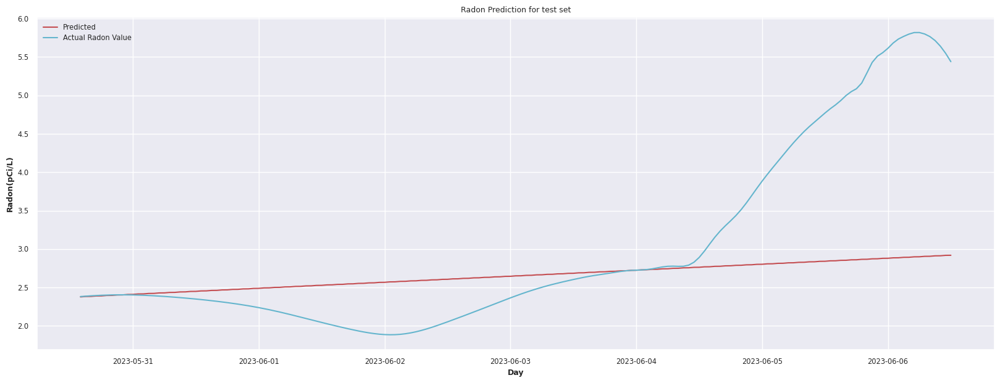

In [75]:
# plot the forecast
plt.figure(100, figsize=(20, 7))
plt.plot(dfY.index, dfY['Predicted'], color='r', label='Predicted')
plt.plot(dfY.index, dfY['Actual'], color='c', label='Actual Radon Value')
plt.legend()
plt.title('Radon Prediction for test set')
plt.xlabel('Day')
plt.ylabel('Radon(pCi/L)')
plt.show()